# Attention : 
# Faire "File -> Save a copy in Drive" avant de commencer à modifier le notebook, sinon vos modifications ne seront pas sauvegardées.


In [ ]:
!wget http://webia.lip6.fr/~dancette/deep-learning/assets/TP3-4/TP3-4.zip
!unzip -j TP3-4.zip

--2020-11-15 10:31:06--  http://webia.lip6.fr/~dancette/deep-learning/assets/TP3-4/TP3-4.zip
Resolving webia.lip6.fr (webia.lip6.fr)... 132.227.201.33
Connecting to webia.lip6.fr (webia.lip6.fr)|132.227.201.33|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13421167 (13M) [application/zip]
Saving to: ‘TP3-4.zip’

TP3-4.zip           100%[===================>]  12.80M  8.51MB/s    in 1.5s    

2020-11-15 10:31:08 (8.51 MB/s) - ‘TP3-4.zip’ saved [13421167/13421167]

Archive:  TP3-4.zip
  inflating: tme5.py                 
  inflating: mnist.mat               
  inflating: circles.py              
  inflating: circles.mat             


In [ ]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'tme5.py'

# Partie 1 : Forward et Backward manuels

In [118]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}
    
    
    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["bh"] = torch.zeros(nh, 1) 
    params["by"] =torch.zeros(ny, 1)
    
    return params

In [119]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}
    
    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params['Wh'].t()) + params['bh'].t()
    outputs["h"] = torch.tanh(outputs['htilde'])
    # ytilde est ce qu'on appelle logits
    outputs["ytilde"] = torch.mm(outputs['h'], params['Wy'].t()) + params['by'].t().expand(bsize, ny)
    outputs["yhat"] = torch.exp(outputs['ytilde'])
    outputs["yhat"] = outputs['yhat'] / (outputs['yhat'].sum(1, keepdim=True)).expand_as(outputs['yhat'])
    

    return outputs['yhat'], outputs

In [121]:
def loss_accuracy(Yhat, Y):

    L = - torch.mean(Y * torch.log(Yhat))

    _, indYhat = torch.max(Yhat, 1)
    _, indY = torch.max(Y, 1)

    acc = torch.sum(indY == indYhat) * 100. / indY.size(0)

    return L, acc

In [122]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}


    deltay = outputs['yhat'] - Y
    grads["Wy"] = torch.mm(deltay.t(), outputs['h'])
    grads["by"] = deltay.sum(0, keepdim=True).t()
    deltah = torch.mm(deltay, params['Wy']) * (1 - torch.pow(outputs['h'], 2))
    grads["Wh"] = torch.mm(deltah.t(), outputs['X'])
    grads["bh"] = deltah.sum(0, keepdim=True).t()

    grads['Wy'] /= bsize
    grads['by'] /= bsize
    grads['Wh'] /= bsize
    grads['bh'] /= bsize
  
    return grads

In [123]:
def sgd(params, grads, eta):

    # mettre à jour le contenu de params
    params["Wh"] -= eta * grads['Wh'] 
    params["Wy"] -= eta * grads['Wy'] 
    params["bh"] -= eta * grads['bh'] 
    params["by"] -= eta * grads['by']    

    return params

## Algorithme global d'apprentissage (manuel)

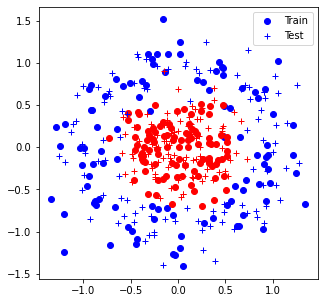

Iter 0: Acc train 48.5% (0.35), acc test 50.0% (0.35)


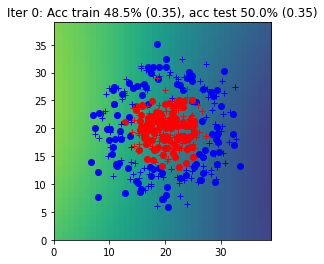

Iter 1: Acc train 50.0% (0.35), acc test 50.0% (0.35)


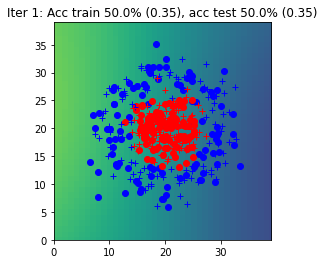

Iter 2: Acc train 48.5% (0.35), acc test 50.0% (0.35)


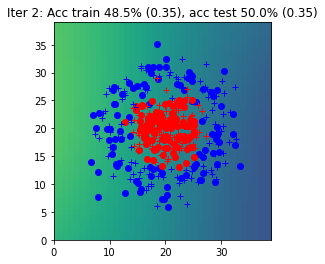

Iter 3: Acc train 49.0% (0.35), acc test 50.0% (0.35)


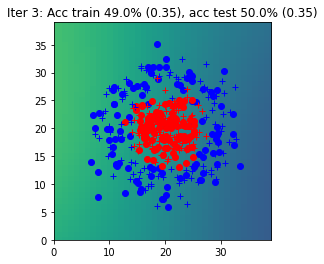

Iter 4: Acc train 48.5% (0.35), acc test 50.0% (0.35)


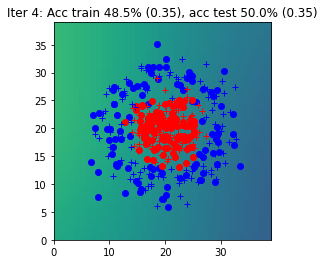

Iter 5: Acc train 51.5% (0.35), acc test 51.0% (0.35)


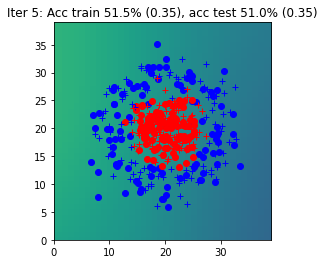

Iter 6: Acc train 56.0% (0.35), acc test 55.5% (0.35)


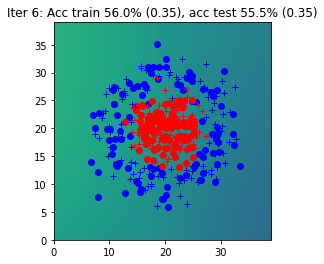

Iter 7: Acc train 53.5% (0.35), acc test 53.5% (0.35)


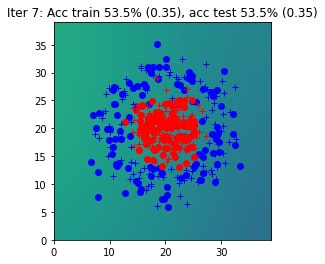

Iter 8: Acc train 60.0% (0.35), acc test 63.5% (0.35)


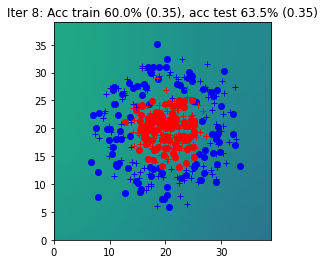

Iter 9: Acc train 59.0% (0.35), acc test 64.5% (0.35)


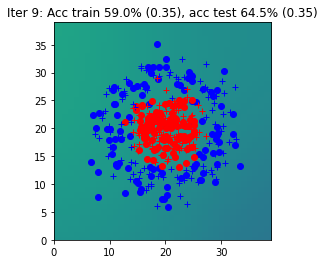

Iter 10: Acc train 61.0% (0.35), acc test 65.5% (0.35)


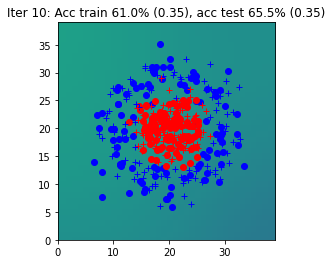

Iter 11: Acc train 62.0% (0.35), acc test 63.0% (0.35)


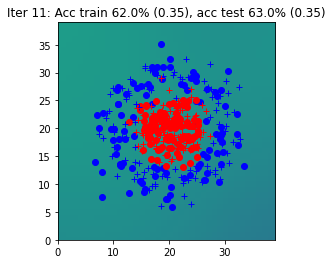

Iter 12: Acc train 64.0% (0.35), acc test 65.0% (0.35)


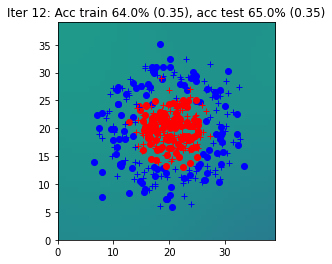

Iter 13: Acc train 59.5% (0.35), acc test 62.0% (0.35)


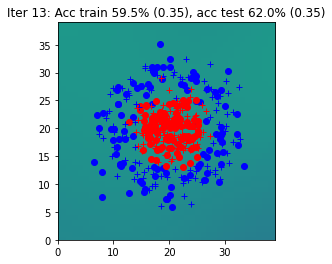

Iter 14: Acc train 60.5% (0.35), acc test 62.0% (0.35)


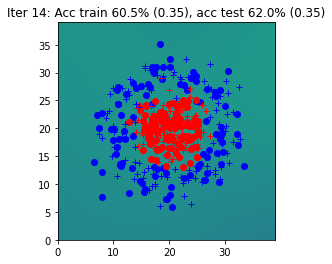

Iter 15: Acc train 57.5% (0.35), acc test 55.5% (0.35)


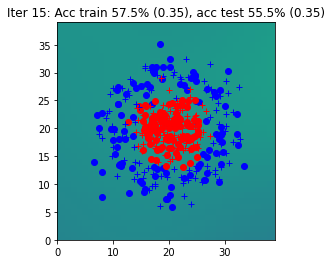

Iter 16: Acc train 57.0% (0.35), acc test 54.0% (0.35)


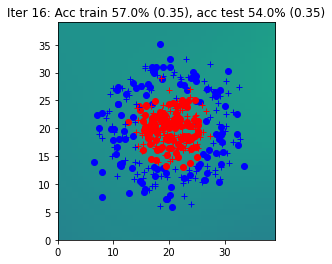

Iter 17: Acc train 60.5% (0.35), acc test 57.5% (0.35)


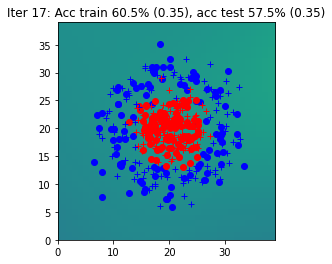

Iter 18: Acc train 71.0% (0.35), acc test 68.5% (0.35)


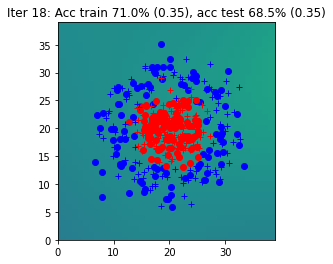

Iter 19: Acc train 70.5% (0.34), acc test 69.5% (0.35)


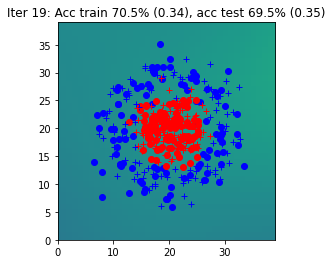

Iter 20: Acc train 69.5% (0.34), acc test 71.0% (0.35)


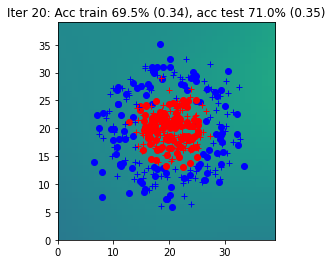

Iter 21: Acc train 69.0% (0.34), acc test 67.5% (0.35)


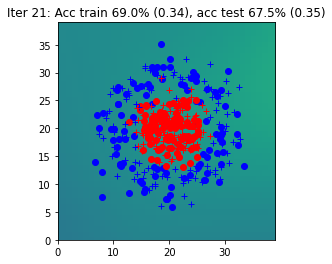

Iter 22: Acc train 70.0% (0.34), acc test 70.0% (0.34)


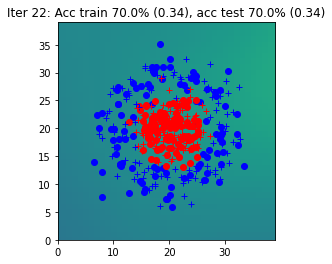

Iter 23: Acc train 70.0% (0.34), acc test 70.0% (0.34)


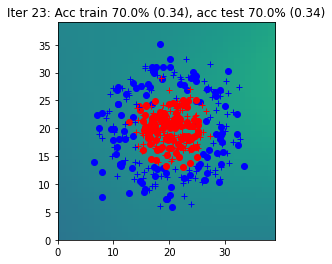

Iter 24: Acc train 67.5% (0.34), acc test 70.5% (0.34)


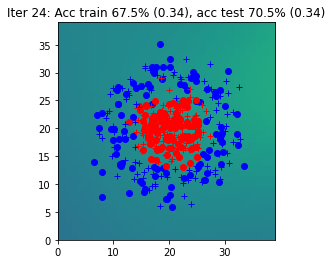

Iter 25: Acc train 70.0% (0.34), acc test 71.0% (0.34)


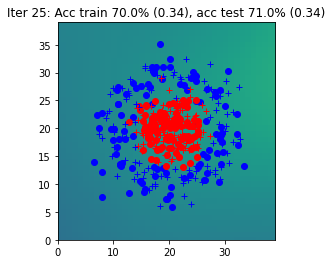

Iter 26: Acc train 68.5% (0.34), acc test 71.0% (0.34)


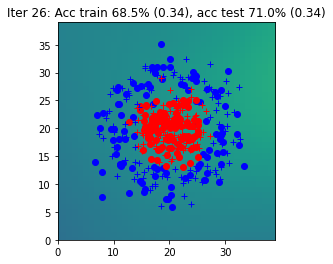

Iter 27: Acc train 68.0% (0.34), acc test 70.0% (0.34)


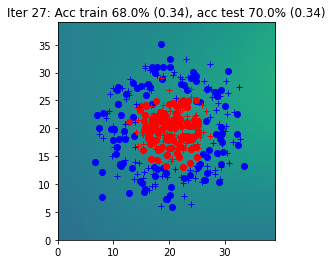

Iter 28: Acc train 68.5% (0.34), acc test 68.0% (0.34)


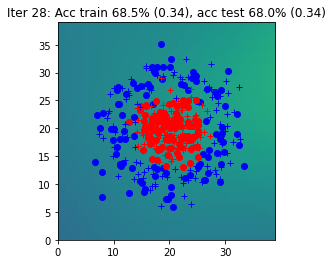

Iter 29: Acc train 72.0% (0.34), acc test 72.0% (0.34)


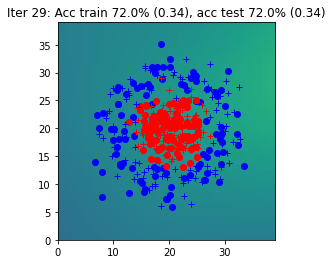

Iter 30: Acc train 71.5% (0.34), acc test 71.5% (0.34)


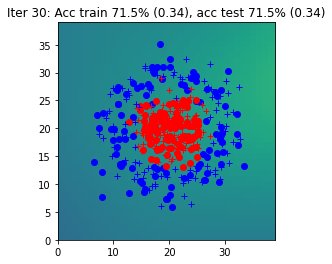

Iter 31: Acc train 71.5% (0.34), acc test 71.0% (0.34)


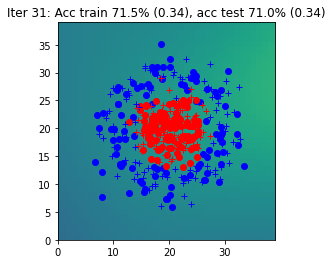

Iter 32: Acc train 71.5% (0.34), acc test 71.5% (0.34)


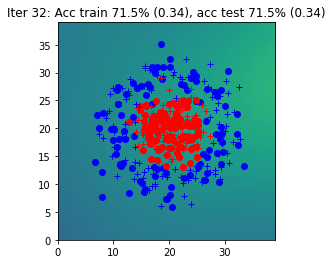

Iter 33: Acc train 73.5% (0.34), acc test 72.0% (0.34)


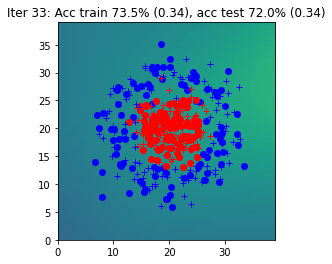

Iter 34: Acc train 68.5% (0.34), acc test 70.5% (0.34)


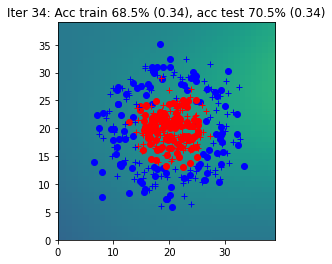

Iter 35: Acc train 74.0% (0.34), acc test 72.5% (0.34)


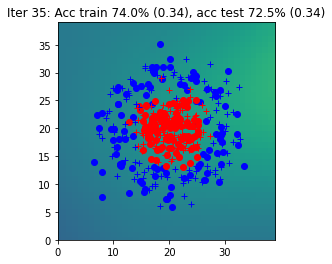

Iter 36: Acc train 73.0% (0.34), acc test 72.5% (0.34)


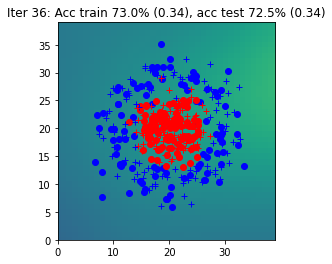

Iter 37: Acc train 71.5% (0.34), acc test 72.0% (0.34)


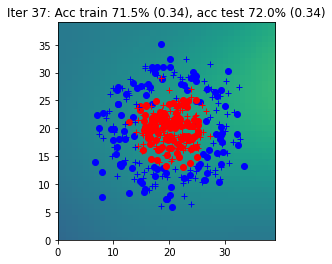

Iter 38: Acc train 73.0% (0.34), acc test 73.5% (0.34)


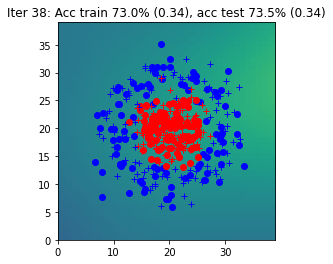

Iter 39: Acc train 74.0% (0.34), acc test 73.5% (0.34)


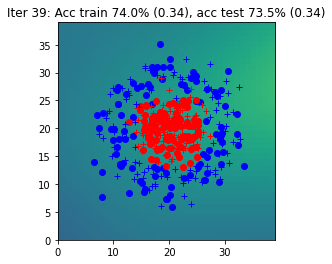

Iter 40: Acc train 75.0% (0.34), acc test 74.0% (0.34)


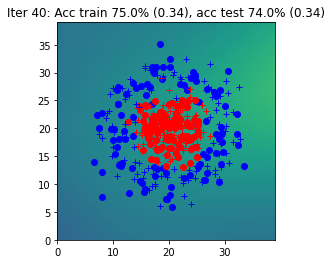

Iter 41: Acc train 77.5% (0.34), acc test 74.5% (0.34)


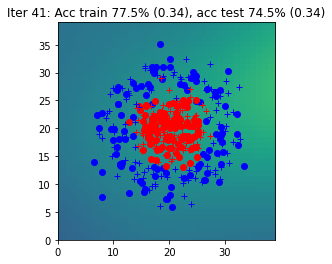

Iter 42: Acc train 76.0% (0.34), acc test 74.5% (0.34)


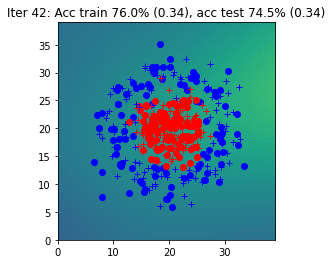

Iter 43: Acc train 77.5% (0.34), acc test 76.0% (0.34)


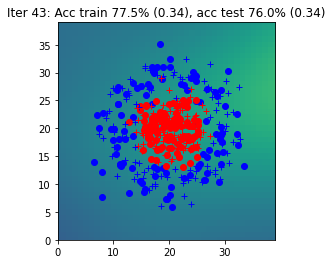

Iter 44: Acc train 77.5% (0.34), acc test 77.5% (0.34)


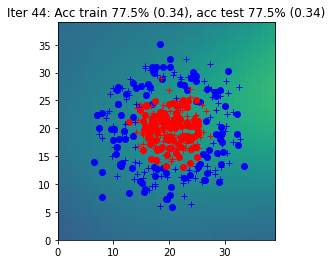

Iter 45: Acc train 78.0% (0.34), acc test 78.5% (0.34)


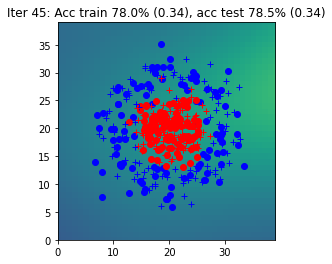

Iter 46: Acc train 79.0% (0.34), acc test 77.0% (0.34)


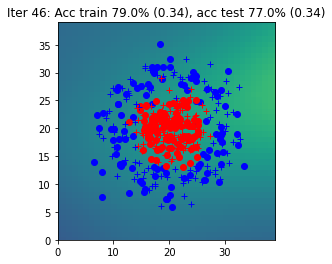

Iter 47: Acc train 77.5% (0.34), acc test 79.5% (0.34)


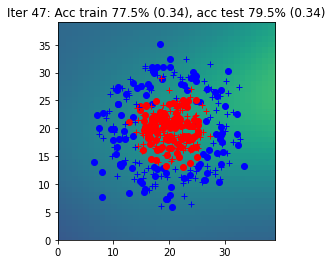

Iter 48: Acc train 78.0% (0.34), acc test 79.0% (0.34)


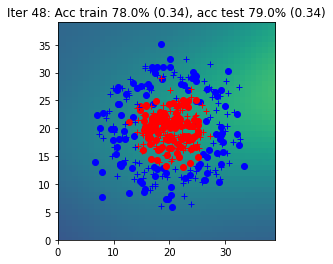

Iter 49: Acc train 78.0% (0.34), acc test 79.5% (0.34)


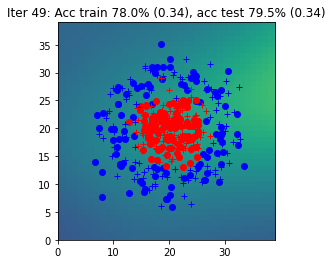

Iter 50: Acc train 78.5% (0.34), acc test 79.5% (0.34)


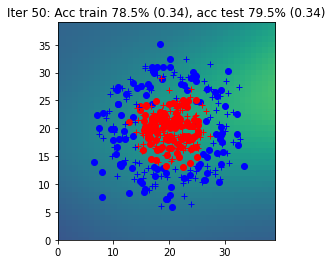

Iter 51: Acc train 78.0% (0.34), acc test 80.0% (0.34)


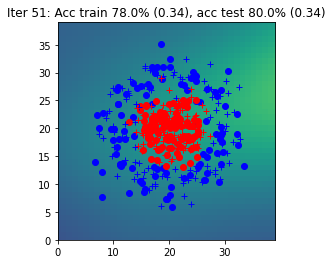

Iter 52: Acc train 78.5% (0.34), acc test 80.5% (0.34)


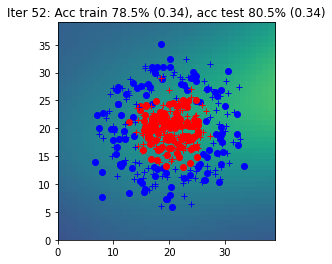

Iter 53: Acc train 78.0% (0.34), acc test 81.5% (0.34)


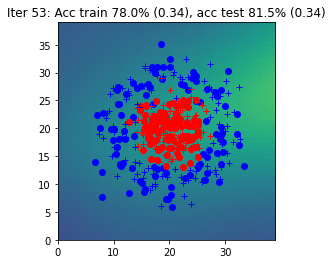

Iter 54: Acc train 79.0% (0.34), acc test 80.5% (0.34)


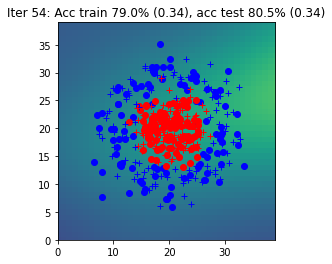

Iter 55: Acc train 78.5% (0.34), acc test 80.0% (0.34)


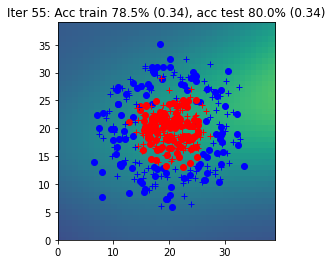

Iter 56: Acc train 79.0% (0.34), acc test 79.5% (0.34)


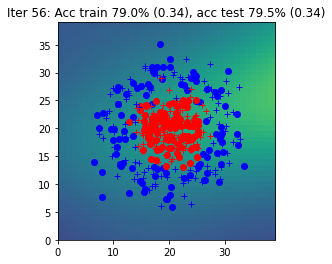

Iter 57: Acc train 78.0% (0.33), acc test 77.5% (0.34)


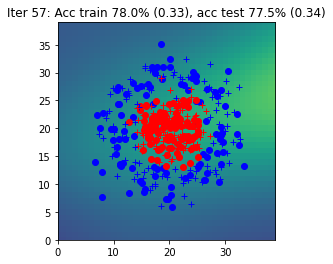

Iter 58: Acc train 78.5% (0.33), acc test 80.5% (0.33)


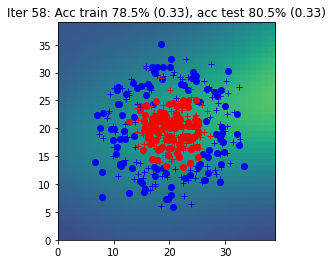

Iter 59: Acc train 80.0% (0.33), acc test 81.0% (0.33)


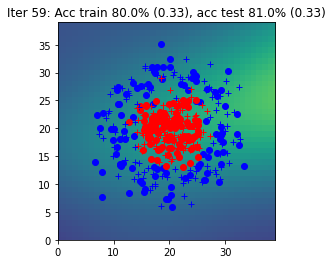

Iter 60: Acc train 80.5% (0.33), acc test 81.5% (0.33)


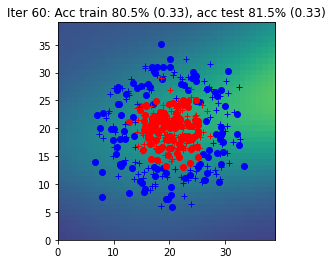

Iter 61: Acc train 79.5% (0.33), acc test 81.5% (0.33)


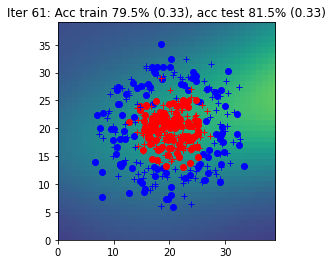

Iter 62: Acc train 80.0% (0.33), acc test 81.5% (0.33)


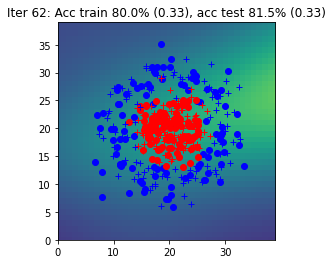

Iter 63: Acc train 78.0% (0.33), acc test 81.0% (0.33)


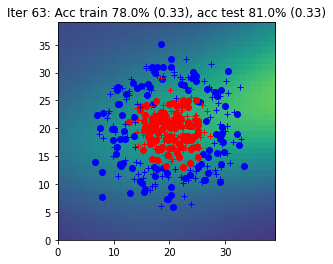

Iter 64: Acc train 77.5% (0.33), acc test 80.0% (0.33)


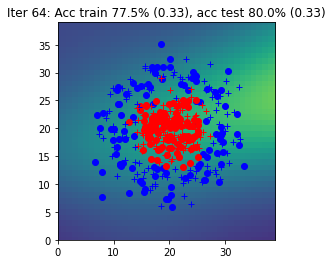

Iter 65: Acc train 77.5% (0.33), acc test 80.5% (0.33)


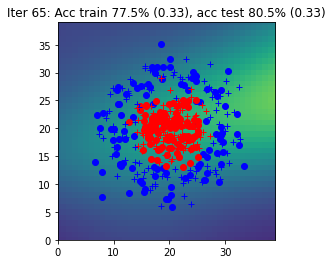

Iter 66: Acc train 77.5% (0.33), acc test 81.0% (0.33)


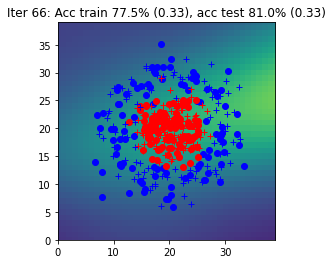

Iter 67: Acc train 77.5% (0.33), acc test 80.0% (0.33)


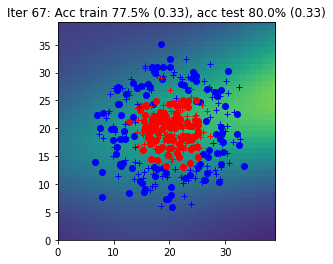

Iter 68: Acc train 77.0% (0.32), acc test 81.0% (0.33)


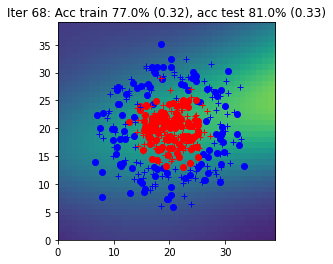

Iter 69: Acc train 79.0% (0.32), acc test 81.0% (0.32)


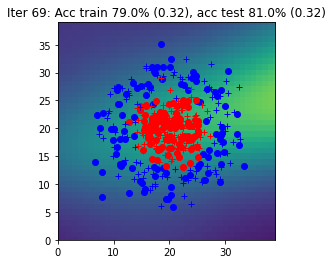

Iter 70: Acc train 78.5% (0.32), acc test 81.0% (0.32)


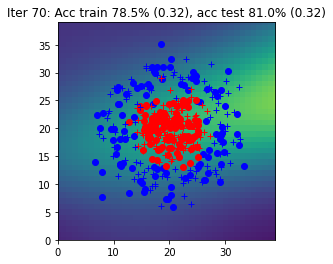

Iter 71: Acc train 79.0% (0.32), acc test 80.0% (0.32)


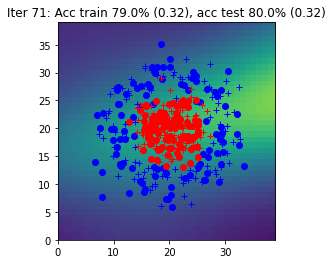

Iter 72: Acc train 79.0% (0.32), acc test 81.0% (0.32)


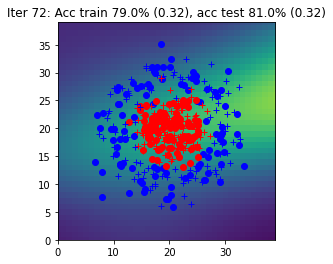

Iter 73: Acc train 79.0% (0.32), acc test 80.5% (0.32)


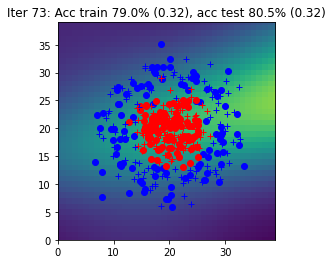

Iter 74: Acc train 80.0% (0.32), acc test 80.0% (0.32)


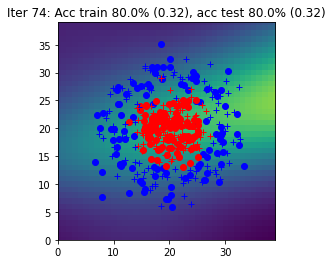

Iter 75: Acc train 80.0% (0.32), acc test 79.5% (0.32)


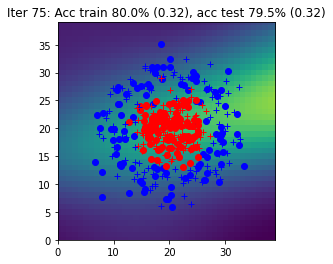

Iter 76: Acc train 79.0% (0.31), acc test 78.5% (0.32)


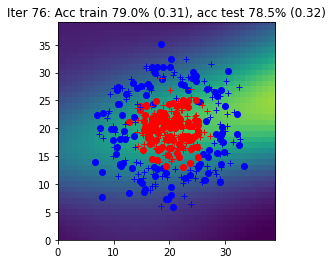

Iter 77: Acc train 79.5% (0.31), acc test 78.5% (0.31)


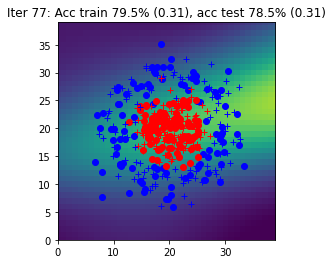

Iter 78: Acc train 79.5% (0.31), acc test 78.5% (0.31)


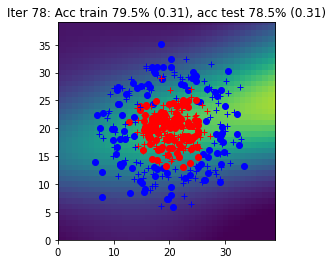

Iter 79: Acc train 80.5% (0.31), acc test 79.0% (0.31)


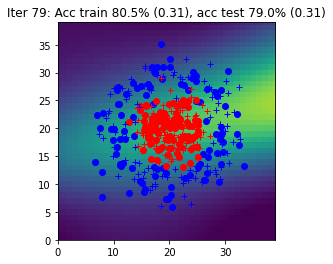

Iter 80: Acc train 80.0% (0.31), acc test 79.0% (0.31)


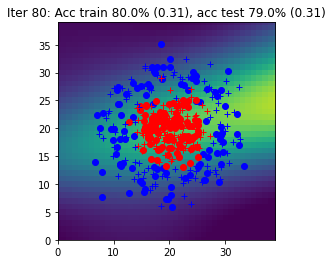

Iter 81: Acc train 79.5% (0.31), acc test 77.5% (0.31)


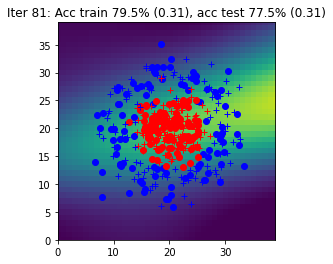

Iter 82: Acc train 80.5% (0.30), acc test 79.0% (0.31)


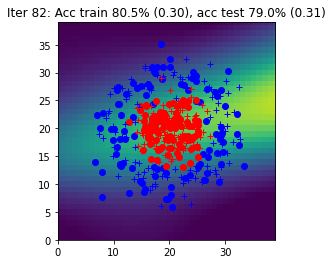

Iter 83: Acc train 80.0% (0.30), acc test 79.5% (0.30)


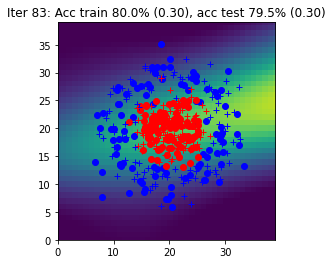

Iter 84: Acc train 80.5% (0.30), acc test 79.0% (0.30)


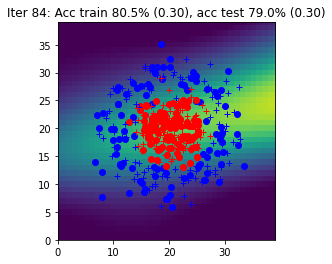

Iter 85: Acc train 80.5% (0.30), acc test 79.5% (0.30)


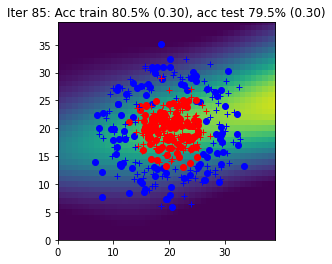

Iter 86: Acc train 80.5% (0.30), acc test 79.5% (0.30)


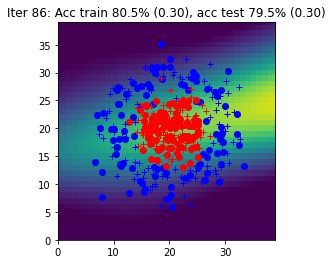

Iter 87: Acc train 80.0% (0.30), acc test 79.0% (0.30)


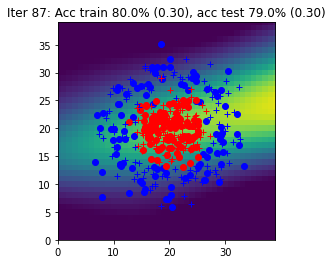

Iter 88: Acc train 81.0% (0.29), acc test 78.5% (0.30)


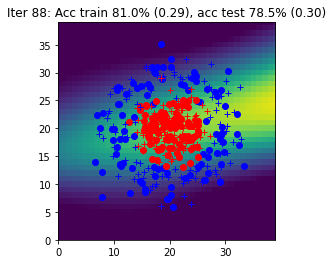

Iter 89: Acc train 80.5% (0.29), acc test 79.5% (0.29)


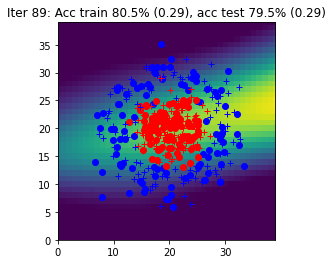

Iter 90: Acc train 80.5% (0.29), acc test 78.5% (0.29)


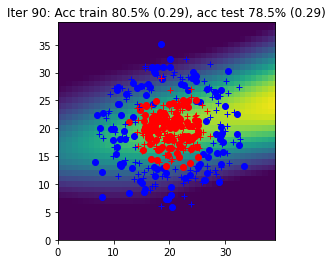

Iter 91: Acc train 81.0% (0.29), acc test 78.5% (0.29)


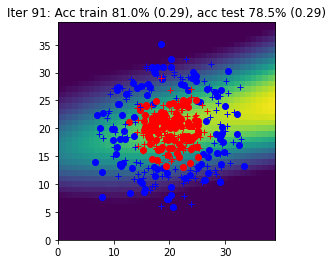

Iter 92: Acc train 80.0% (0.29), acc test 78.5% (0.29)


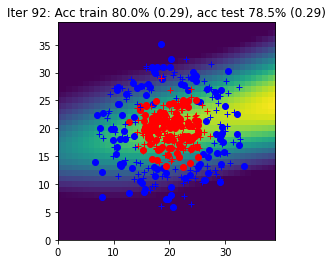

Iter 93: Acc train 82.0% (0.28), acc test 78.0% (0.29)


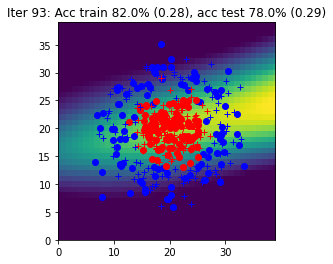

Iter 94: Acc train 80.0% (0.28), acc test 78.5% (0.28)


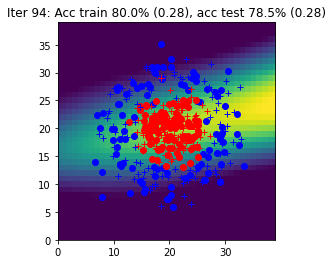

Iter 95: Acc train 81.0% (0.28), acc test 78.0% (0.28)


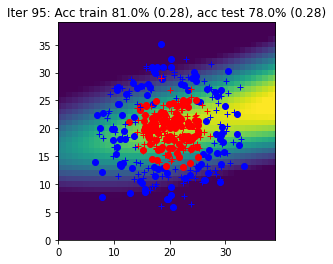

Iter 96: Acc train 81.5% (0.28), acc test 77.5% (0.28)


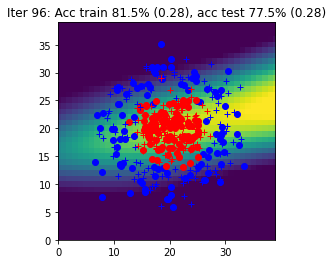

Iter 97: Acc train 80.5% (0.28), acc test 78.0% (0.28)


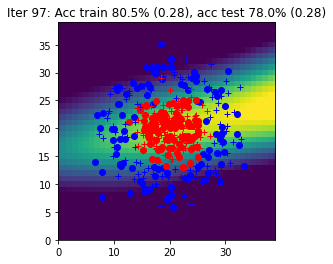

Iter 98: Acc train 80.0% (0.28), acc test 77.5% (0.28)


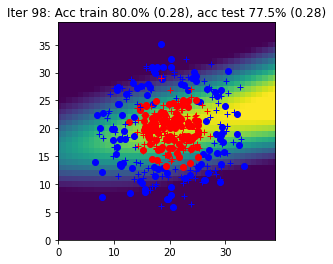

Iter 99: Acc train 80.0% (0.27), acc test 78.0% (0.28)


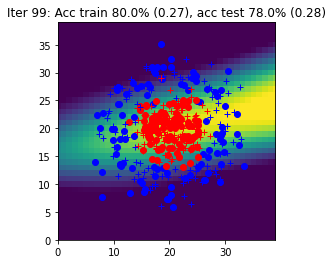

Iter 100: Acc train 80.0% (0.27), acc test 78.0% (0.27)


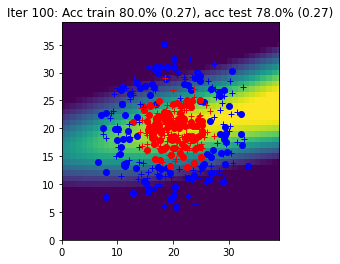

Iter 101: Acc train 80.0% (0.27), acc test 79.0% (0.27)


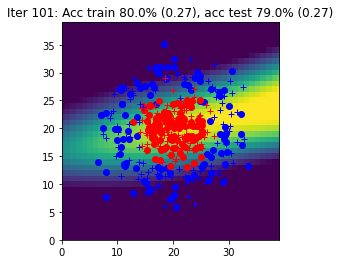

Iter 102: Acc train 79.0% (0.27), acc test 79.5% (0.27)


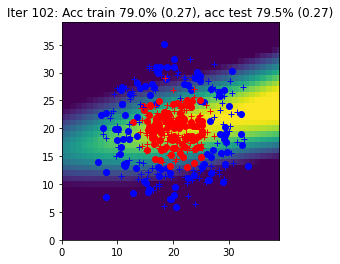

Iter 103: Acc train 79.5% (0.27), acc test 79.5% (0.27)


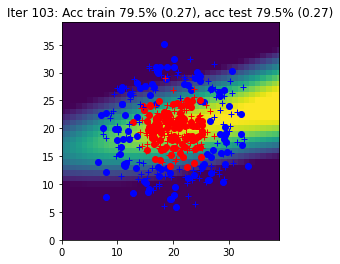

Iter 104: Acc train 80.0% (0.27), acc test 80.0% (0.27)


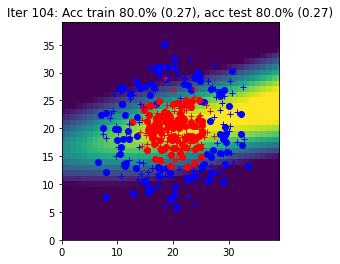

Iter 105: Acc train 80.0% (0.26), acc test 80.0% (0.27)


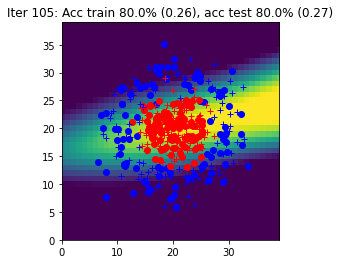

Iter 106: Acc train 80.0% (0.26), acc test 80.5% (0.26)


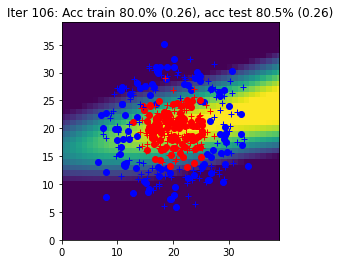

Iter 107: Acc train 81.0% (0.26), acc test 80.5% (0.26)


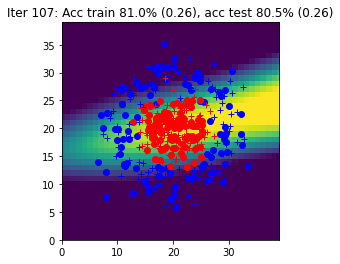

Iter 108: Acc train 80.5% (0.26), acc test 81.0% (0.26)


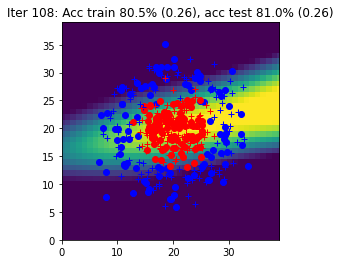

Iter 109: Acc train 80.5% (0.26), acc test 81.0% (0.26)


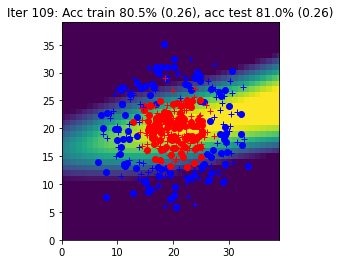

Iter 110: Acc train 80.5% (0.26), acc test 81.0% (0.26)


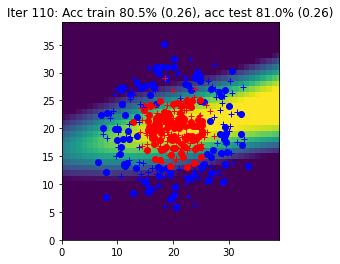

Iter 111: Acc train 80.5% (0.26), acc test 80.5% (0.26)


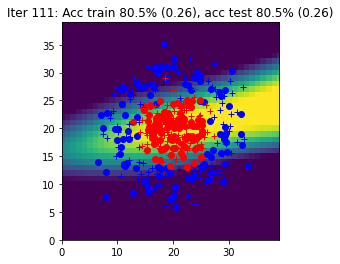

Iter 112: Acc train 81.0% (0.25), acc test 81.0% (0.25)


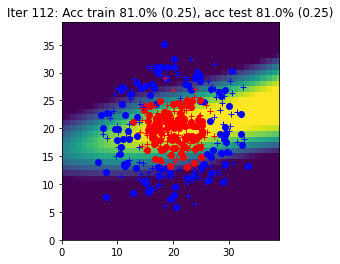

Iter 113: Acc train 81.0% (0.25), acc test 81.0% (0.25)


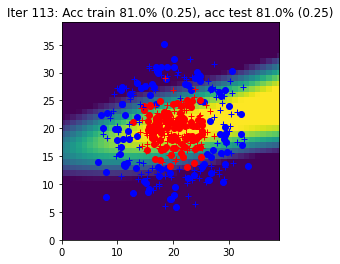

Iter 114: Acc train 80.5% (0.25), acc test 81.0% (0.25)


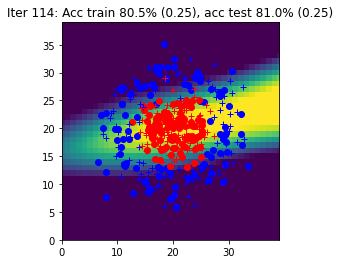

Iter 115: Acc train 80.5% (0.25), acc test 81.0% (0.25)


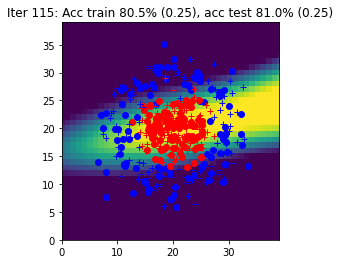

Iter 116: Acc train 81.0% (0.25), acc test 81.5% (0.25)


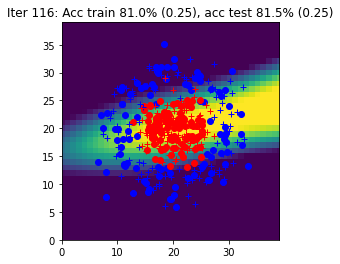

Iter 117: Acc train 80.5% (0.25), acc test 81.0% (0.25)


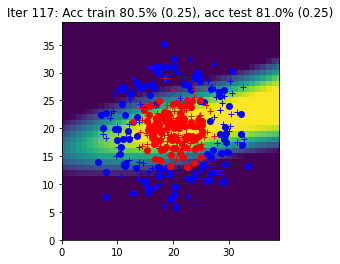

Iter 118: Acc train 80.5% (0.25), acc test 81.0% (0.25)


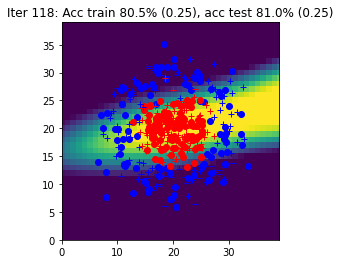

Iter 119: Acc train 80.5% (0.24), acc test 81.0% (0.25)


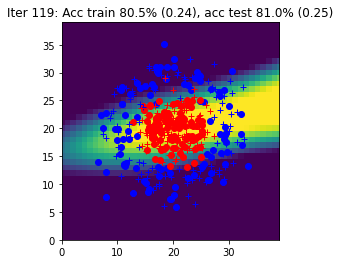

Iter 120: Acc train 81.0% (0.24), acc test 81.0% (0.24)


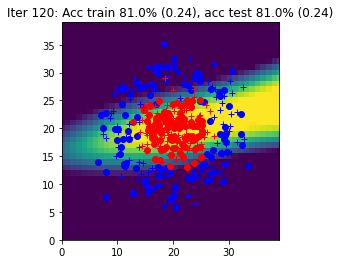

Iter 121: Acc train 81.0% (0.24), acc test 81.0% (0.24)


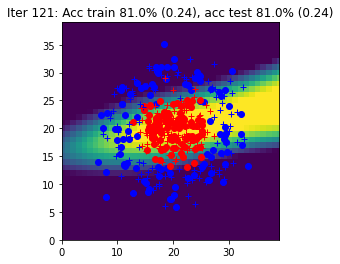

Iter 122: Acc train 81.0% (0.24), acc test 81.0% (0.24)


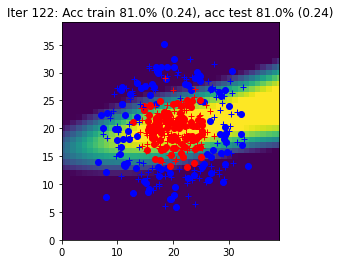

Iter 123: Acc train 81.0% (0.24), acc test 81.0% (0.24)


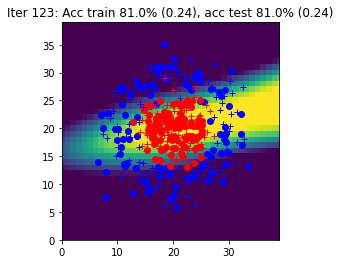

Iter 124: Acc train 81.0% (0.24), acc test 81.5% (0.24)


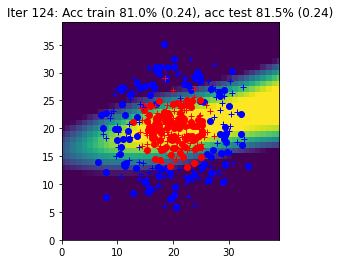

Iter 125: Acc train 81.0% (0.24), acc test 81.5% (0.24)


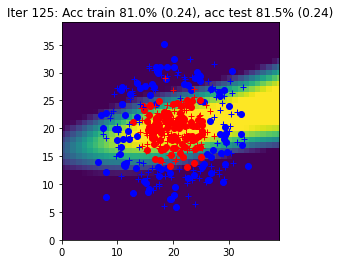

Iter 126: Acc train 81.0% (0.24), acc test 81.0% (0.24)


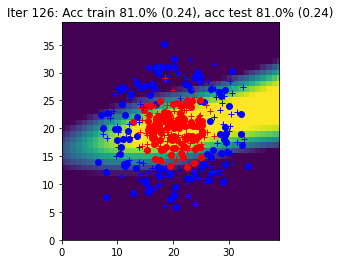

Iter 127: Acc train 81.0% (0.23), acc test 81.5% (0.24)


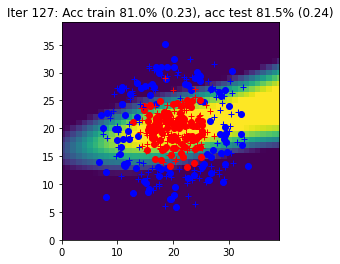

Iter 128: Acc train 81.0% (0.23), acc test 81.5% (0.23)


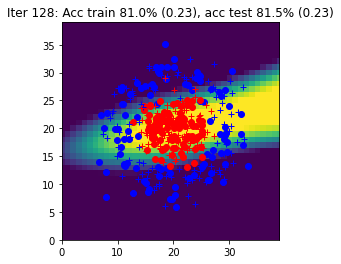

Iter 129: Acc train 81.0% (0.23), acc test 81.5% (0.23)


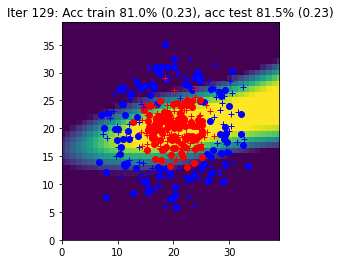

Iter 130: Acc train 81.0% (0.23), acc test 81.5% (0.23)


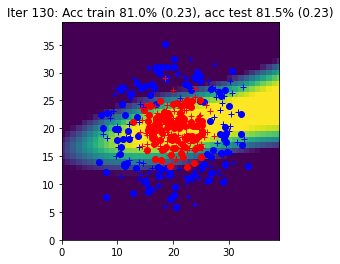

Iter 131: Acc train 81.5% (0.23), acc test 81.5% (0.23)


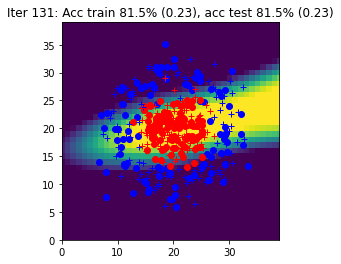

Iter 132: Acc train 81.5% (0.23), acc test 81.5% (0.23)


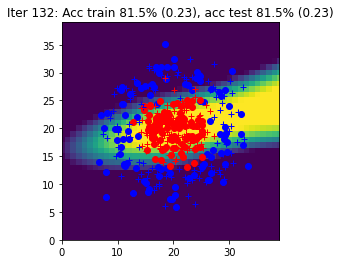

Iter 133: Acc train 81.5% (0.23), acc test 81.5% (0.23)


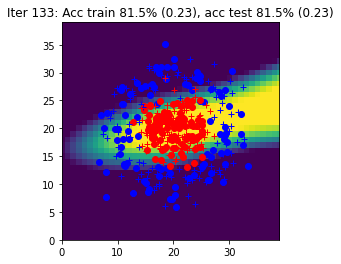

Iter 134: Acc train 82.0% (0.23), acc test 81.5% (0.23)


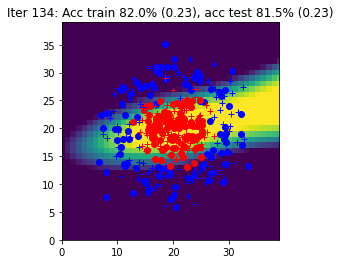

Iter 135: Acc train 82.0% (0.22), acc test 81.5% (0.22)


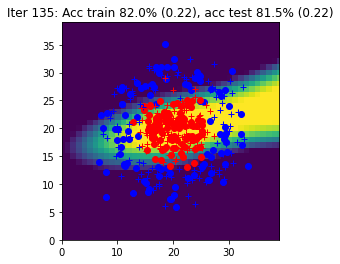

Iter 136: Acc train 82.0% (0.22), acc test 81.5% (0.22)


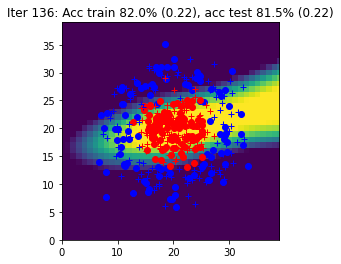

Iter 137: Acc train 82.0% (0.22), acc test 81.5% (0.22)


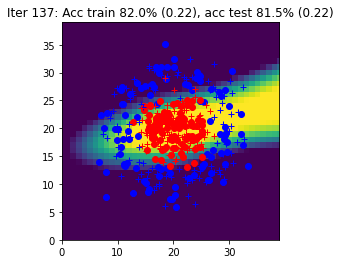

Iter 138: Acc train 82.5% (0.22), acc test 81.5% (0.22)


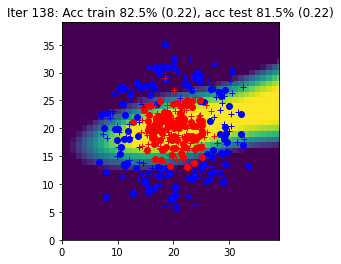

Iter 139: Acc train 82.0% (0.22), acc test 81.5% (0.22)


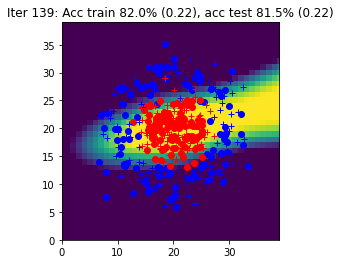

Iter 140: Acc train 82.0% (0.22), acc test 81.5% (0.22)


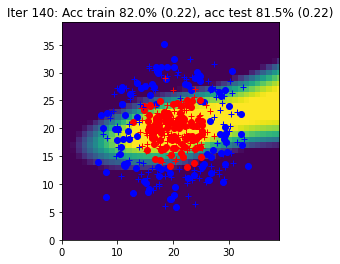

Iter 141: Acc train 82.5% (0.21), acc test 83.5% (0.22)


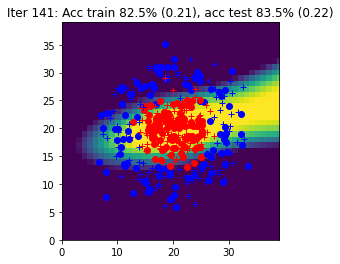

Iter 142: Acc train 82.5% (0.21), acc test 83.5% (0.21)


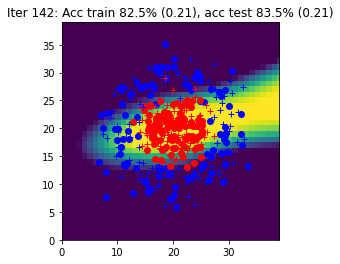

Iter 143: Acc train 83.0% (0.21), acc test 83.0% (0.21)


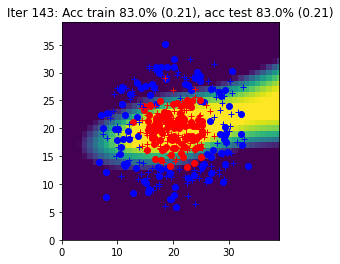

Iter 144: Acc train 82.5% (0.21), acc test 83.5% (0.21)


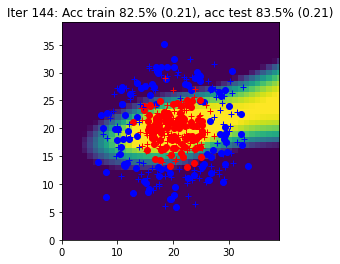

Iter 145: Acc train 82.5% (0.21), acc test 84.0% (0.21)


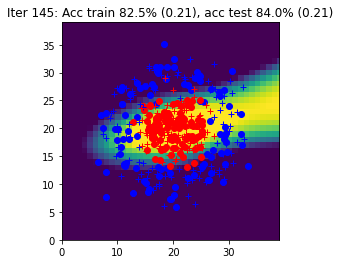

Iter 146: Acc train 82.5% (0.21), acc test 84.5% (0.21)


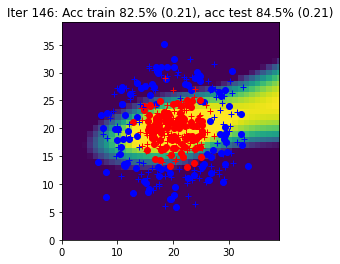

Iter 147: Acc train 83.0% (0.21), acc test 85.0% (0.21)


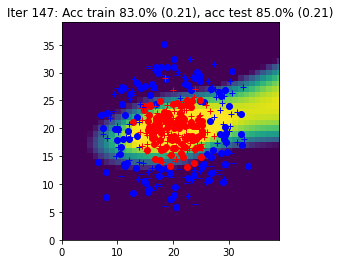

Iter 148: Acc train 82.5% (0.20), acc test 85.0% (0.20)


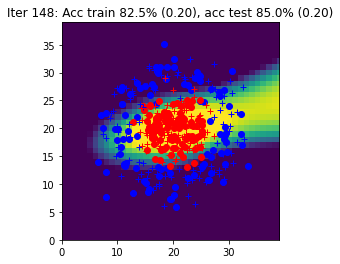

Iter 149: Acc train 83.0% (0.20), acc test 85.5% (0.20)


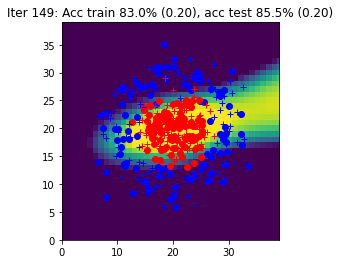

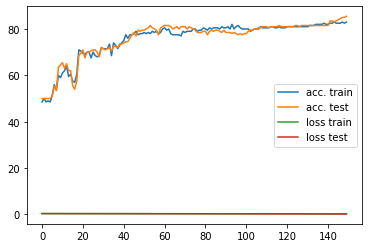

In [124]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        Yhat, outputs = forward(params, X)
        L, _ = loss_accuracy(Yhat, Y)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)



    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)  

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 2 : Simplification du backward avec `torch.autograd`



In [125]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}
    

    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wh"].requires_grad = True
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["Wy"].requires_grad = True
    params["bh"] = torch.zeros(nh, 1, requires_grad=True) 
    params["by"] = torch.zeros(ny, 1, requires_grad=True)
    
    return params

La fonction `forward` est inchangée par rapport à la partie précédente. 

La fonction `backward` n'est plus utilisée grâce à l'autograd. 

In [126]:
def sgd(params, eta):

    with torch.no_grad():
      params["Wh"] -= eta * params['Wh'].grad
      params["Wy"] -= eta * params['Wy'].grad
      params["bh"] -= eta * params['bh'].grad
      params["by"] -= eta * params['by'].grad  

      params['Wh'].grad.zero_()
      params['Wy'].grad.zero_()
      params['bh'].grad.zero_()
      params['by'].grad.zero_()

    return params

## Algorithme global d'apprentissage (avec autograd)

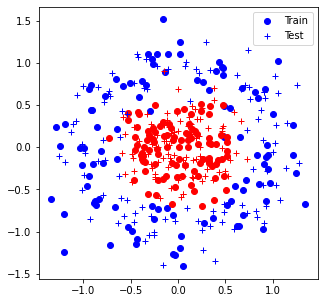

Iter 0: Acc train 53.0% (0.35), acc test 51.5% (0.35)


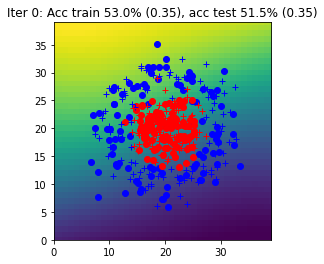

Iter 1: Acc train 53.0% (0.35), acc test 52.5% (0.35)


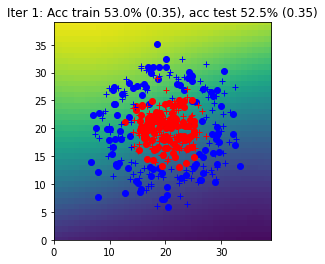

Iter 2: Acc train 54.5% (0.35), acc test 53.0% (0.35)


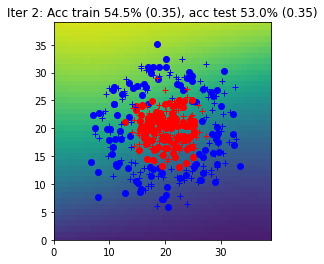

Iter 3: Acc train 54.5% (0.35), acc test 53.0% (0.35)


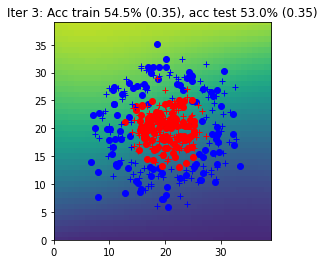

Iter 4: Acc train 54.0% (0.35), acc test 53.5% (0.35)


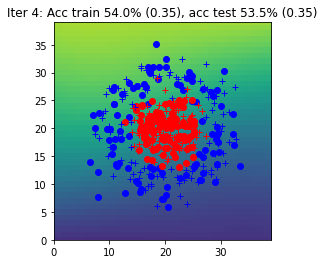

Iter 5: Acc train 55.0% (0.35), acc test 53.5% (0.35)


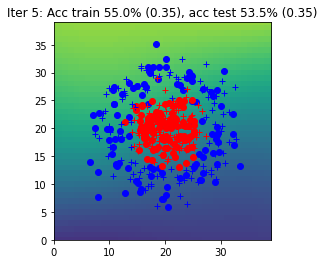

Iter 6: Acc train 55.5% (0.35), acc test 54.0% (0.35)


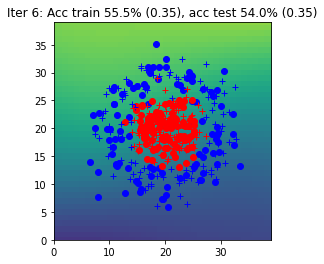

Iter 7: Acc train 55.0% (0.35), acc test 54.0% (0.35)


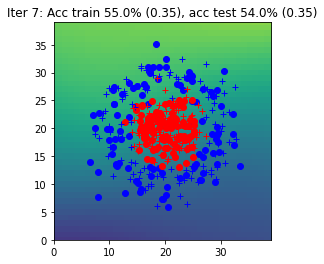

Iter 8: Acc train 56.0% (0.35), acc test 55.0% (0.35)


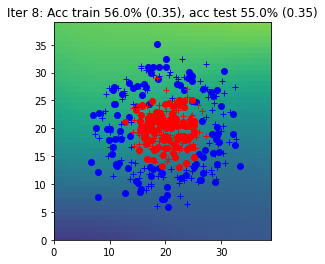

Iter 9: Acc train 57.5% (0.35), acc test 57.0% (0.35)


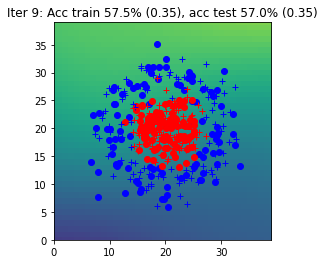

Iter 10: Acc train 57.0% (0.35), acc test 58.0% (0.35)


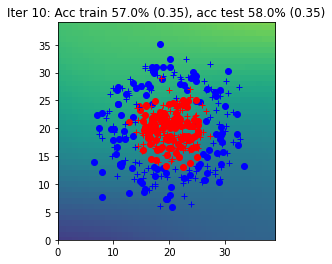

Iter 11: Acc train 57.5% (0.35), acc test 57.0% (0.35)


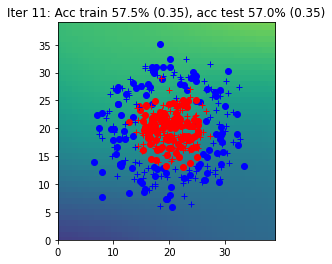

Iter 12: Acc train 58.0% (0.35), acc test 57.5% (0.35)


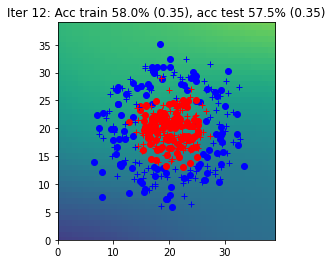

Iter 13: Acc train 57.5% (0.35), acc test 59.0% (0.35)


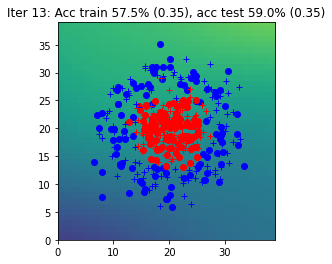

Iter 14: Acc train 59.0% (0.35), acc test 59.5% (0.35)


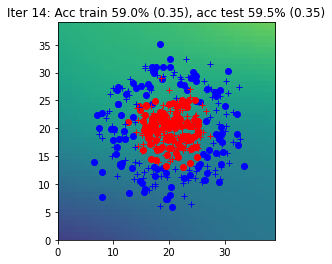

Iter 15: Acc train 60.5% (0.35), acc test 60.0% (0.35)


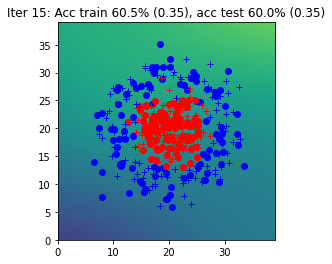

Iter 16: Acc train 62.0% (0.35), acc test 59.5% (0.35)


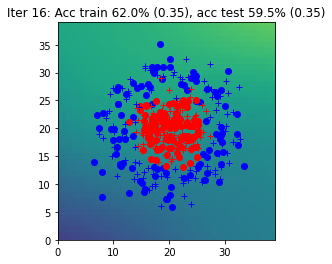

Iter 17: Acc train 61.5% (0.35), acc test 59.5% (0.35)


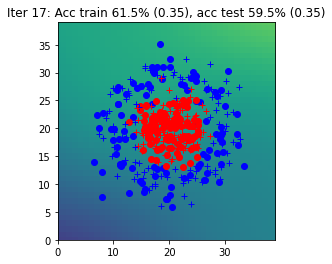

Iter 18: Acc train 62.0% (0.34), acc test 61.5% (0.35)


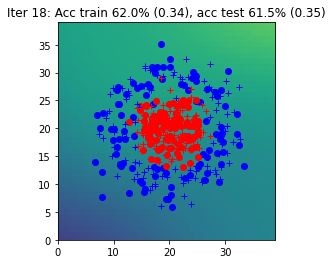

Iter 19: Acc train 62.5% (0.34), acc test 62.0% (0.35)


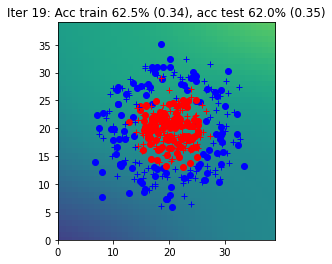

Iter 20: Acc train 62.0% (0.34), acc test 62.5% (0.35)


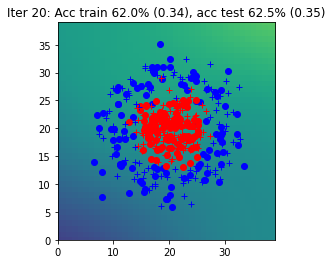

Iter 21: Acc train 65.0% (0.34), acc test 66.5% (0.34)


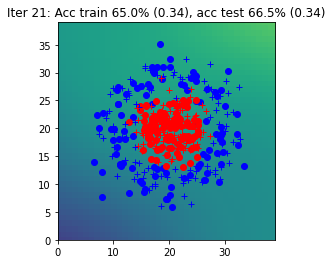

Iter 22: Acc train 64.5% (0.34), acc test 67.0% (0.34)


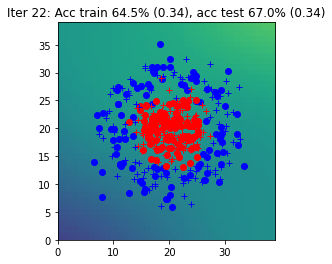

Iter 23: Acc train 64.0% (0.34), acc test 66.0% (0.34)


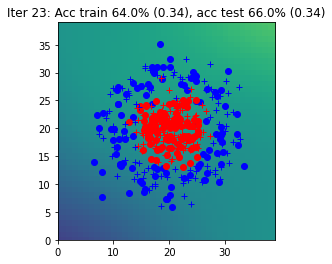

Iter 24: Acc train 63.5% (0.34), acc test 66.5% (0.34)


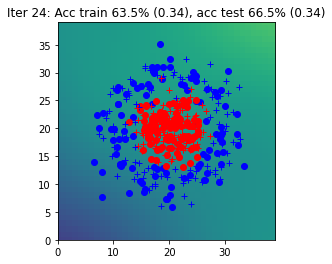

Iter 25: Acc train 63.5% (0.34), acc test 66.5% (0.34)


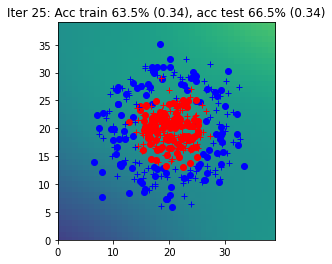

Iter 26: Acc train 65.0% (0.34), acc test 66.0% (0.34)


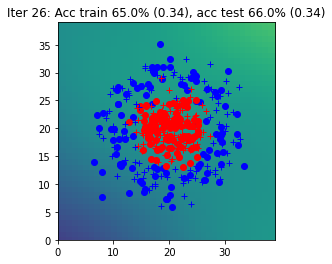

Iter 27: Acc train 65.0% (0.34), acc test 64.0% (0.34)


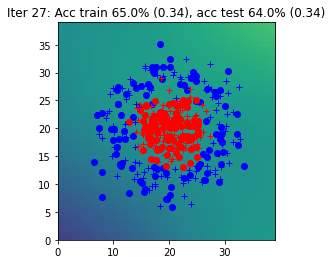

Iter 28: Acc train 65.0% (0.34), acc test 65.0% (0.34)


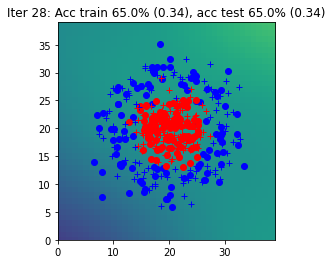

Iter 29: Acc train 65.5% (0.34), acc test 65.0% (0.34)


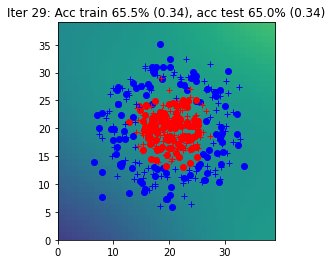

Iter 30: Acc train 64.5% (0.34), acc test 64.0% (0.34)


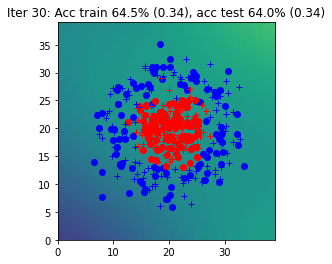

Iter 31: Acc train 64.5% (0.34), acc test 64.0% (0.34)


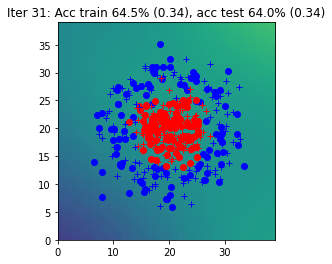

Iter 32: Acc train 64.5% (0.34), acc test 63.5% (0.34)


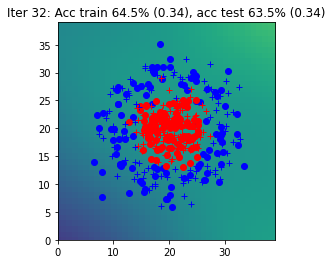

Iter 33: Acc train 63.5% (0.34), acc test 62.5% (0.34)


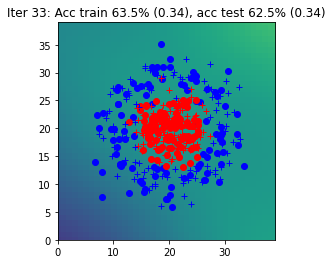

Iter 34: Acc train 64.5% (0.34), acc test 62.5% (0.34)


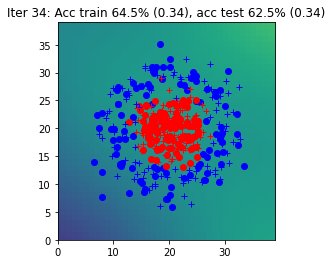

Iter 35: Acc train 64.5% (0.34), acc test 63.0% (0.34)


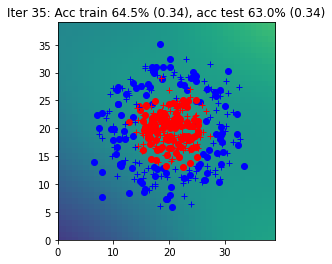

Iter 36: Acc train 65.5% (0.34), acc test 63.5% (0.34)


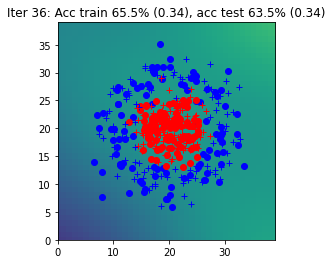

Iter 37: Acc train 64.5% (0.34), acc test 62.0% (0.34)


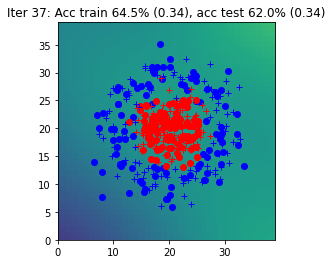

Iter 38: Acc train 65.5% (0.34), acc test 62.5% (0.34)


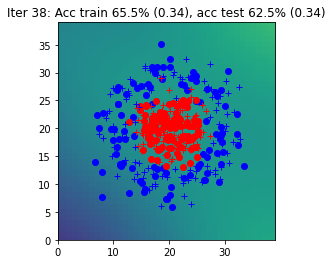

Iter 39: Acc train 65.5% (0.34), acc test 62.0% (0.34)


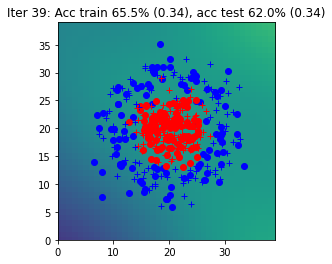

Iter 40: Acc train 64.0% (0.34), acc test 61.0% (0.34)


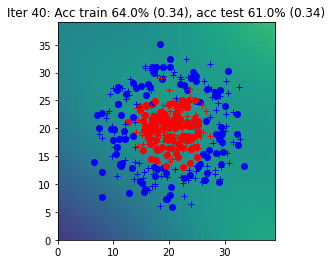

Iter 41: Acc train 65.0% (0.34), acc test 62.5% (0.34)


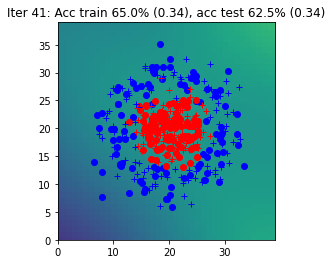

Iter 42: Acc train 65.0% (0.34), acc test 62.0% (0.34)


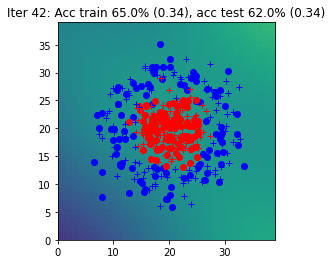

Iter 43: Acc train 65.0% (0.34), acc test 61.5% (0.34)


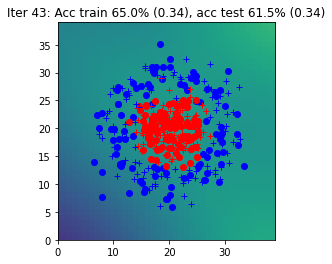

Iter 44: Acc train 62.5% (0.34), acc test 60.0% (0.34)


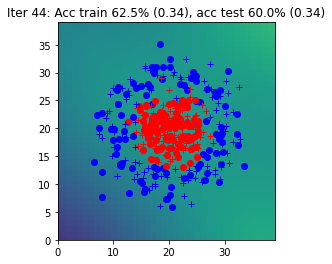

Iter 45: Acc train 63.5% (0.34), acc test 60.5% (0.34)


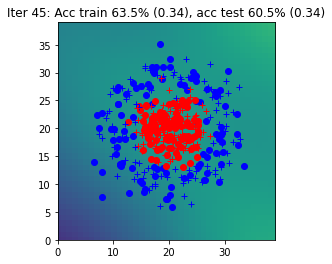

Iter 46: Acc train 64.0% (0.34), acc test 60.5% (0.34)


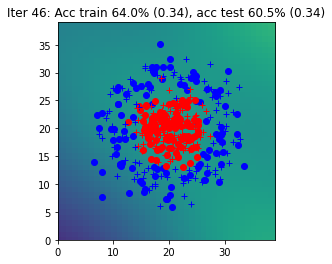

Iter 47: Acc train 63.5% (0.34), acc test 60.5% (0.34)


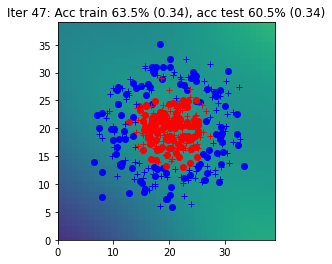

Iter 48: Acc train 64.0% (0.34), acc test 60.5% (0.34)


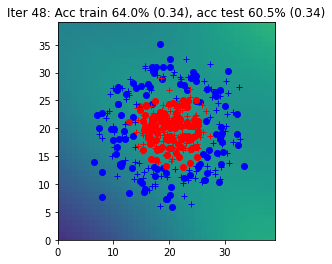

Iter 49: Acc train 64.0% (0.34), acc test 60.5% (0.34)


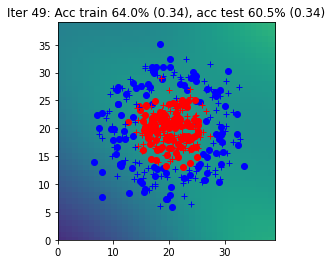

Iter 50: Acc train 63.5% (0.34), acc test 59.5% (0.34)


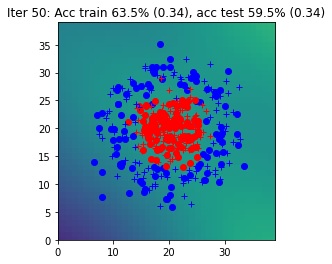

Iter 51: Acc train 63.5% (0.34), acc test 59.5% (0.34)


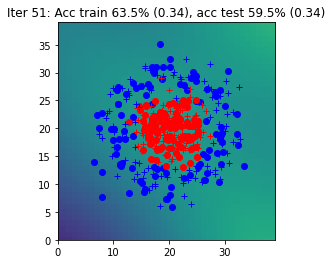

Iter 52: Acc train 62.0% (0.34), acc test 59.5% (0.34)


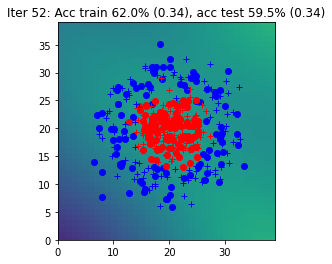

Iter 53: Acc train 62.0% (0.34), acc test 59.5% (0.34)


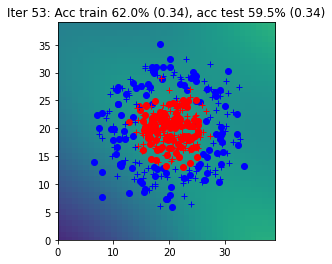

Iter 54: Acc train 62.0% (0.34), acc test 59.5% (0.34)


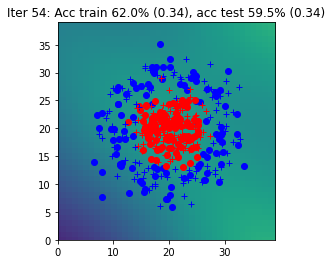

Iter 55: Acc train 63.0% (0.34), acc test 59.5% (0.34)


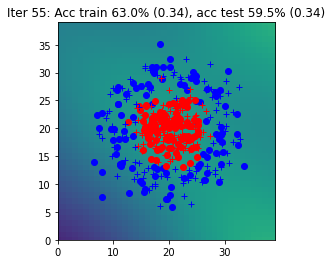

Iter 56: Acc train 62.5% (0.34), acc test 59.5% (0.34)


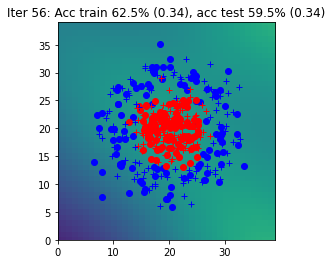

Iter 57: Acc train 63.0% (0.34), acc test 60.0% (0.34)


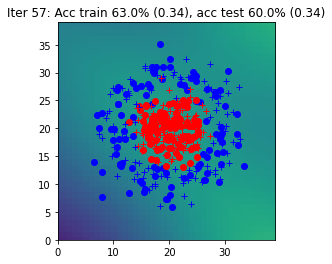

Iter 58: Acc train 64.0% (0.34), acc test 62.0% (0.34)


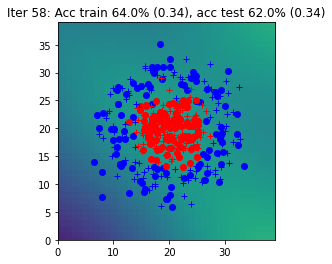

Iter 59: Acc train 64.0% (0.34), acc test 63.5% (0.34)


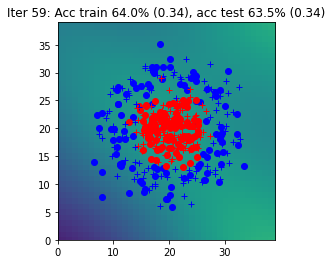

Iter 60: Acc train 66.0% (0.34), acc test 65.5% (0.34)


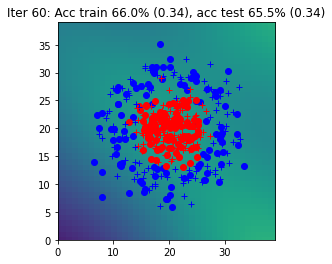

Iter 61: Acc train 70.0% (0.34), acc test 70.5% (0.34)


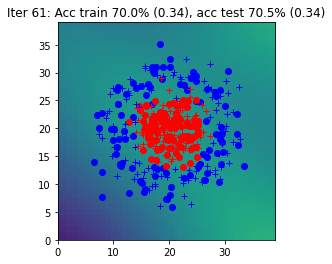

Iter 62: Acc train 70.0% (0.34), acc test 68.5% (0.34)


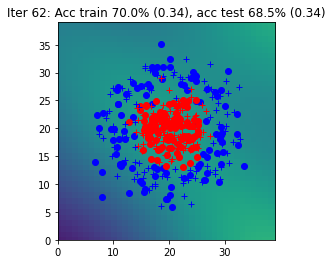

Iter 63: Acc train 72.0% (0.34), acc test 71.5% (0.34)


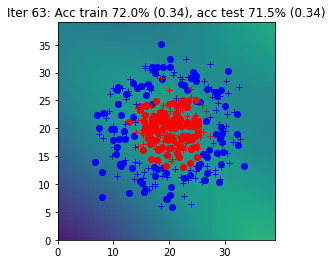

Iter 64: Acc train 72.0% (0.34), acc test 71.0% (0.34)


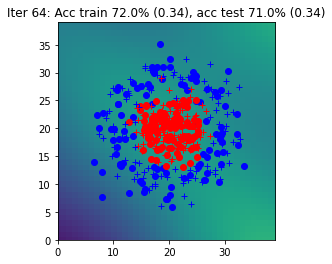

Iter 65: Acc train 72.0% (0.34), acc test 71.0% (0.34)


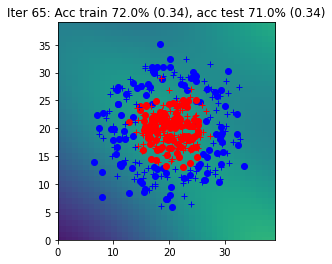

Iter 66: Acc train 72.0% (0.34), acc test 72.5% (0.34)


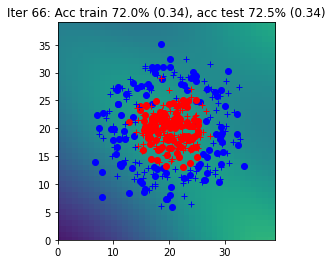

Iter 67: Acc train 71.5% (0.34), acc test 71.5% (0.34)


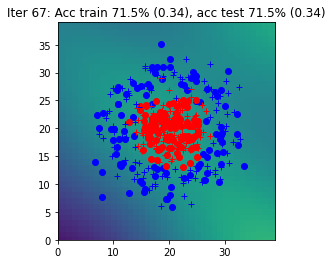

Iter 68: Acc train 71.5% (0.34), acc test 72.0% (0.34)


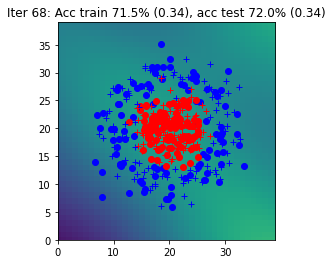

Iter 69: Acc train 71.5% (0.34), acc test 72.0% (0.34)


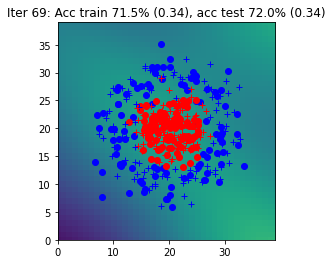

Iter 70: Acc train 71.5% (0.34), acc test 72.0% (0.34)


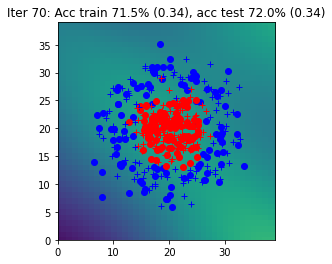

Iter 71: Acc train 72.0% (0.33), acc test 72.0% (0.34)


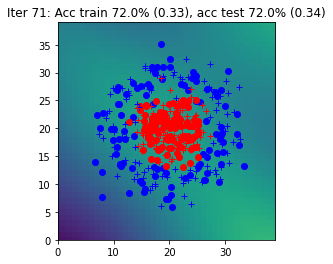

Iter 72: Acc train 74.5% (0.33), acc test 72.0% (0.34)


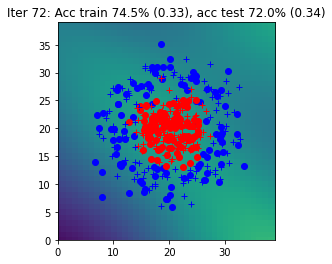

Iter 73: Acc train 75.0% (0.33), acc test 73.0% (0.34)


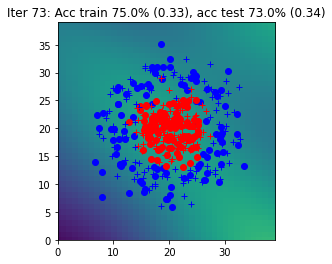

Iter 74: Acc train 75.0% (0.33), acc test 72.5% (0.34)


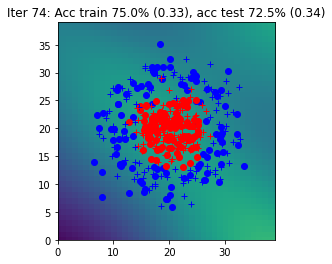

Iter 75: Acc train 75.0% (0.33), acc test 73.0% (0.34)


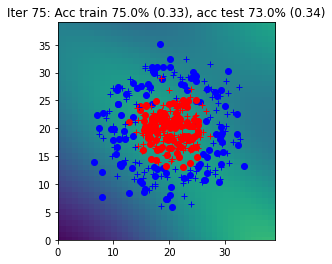

Iter 76: Acc train 76.5% (0.33), acc test 73.5% (0.34)


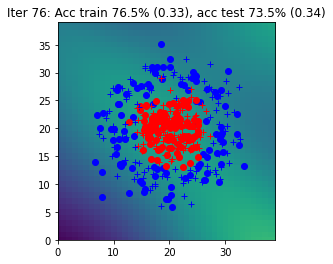

Iter 77: Acc train 77.0% (0.33), acc test 73.0% (0.33)


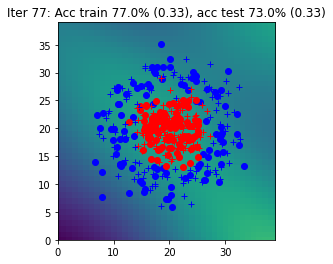

Iter 78: Acc train 77.0% (0.33), acc test 73.0% (0.33)


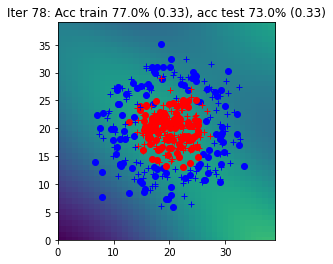

Iter 79: Acc train 77.0% (0.33), acc test 73.5% (0.33)


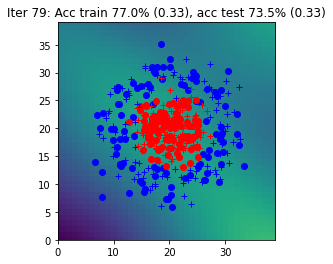

Iter 80: Acc train 77.5% (0.33), acc test 73.5% (0.33)


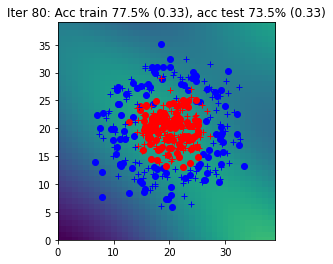

Iter 81: Acc train 78.5% (0.33), acc test 73.5% (0.33)


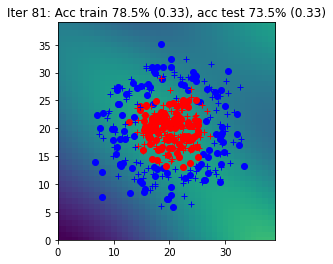

Iter 82: Acc train 77.5% (0.33), acc test 74.0% (0.33)


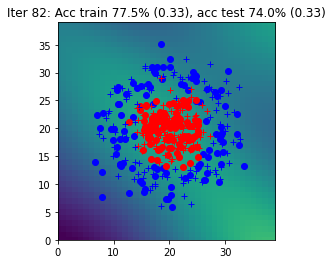

Iter 83: Acc train 78.5% (0.33), acc test 73.5% (0.33)


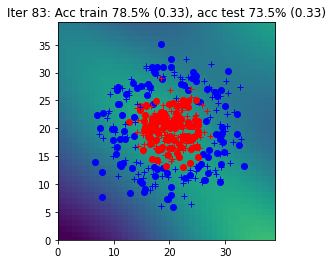

Iter 84: Acc train 78.5% (0.33), acc test 74.0% (0.33)


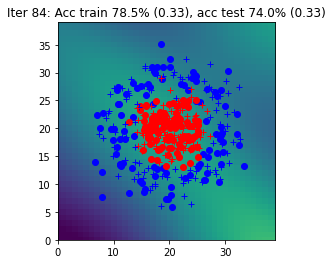

Iter 85: Acc train 78.5% (0.33), acc test 73.5% (0.33)


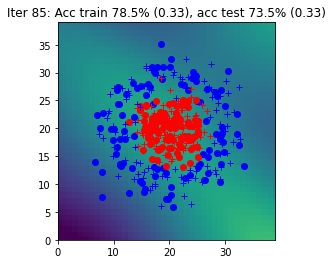

Iter 86: Acc train 78.5% (0.33), acc test 73.5% (0.33)


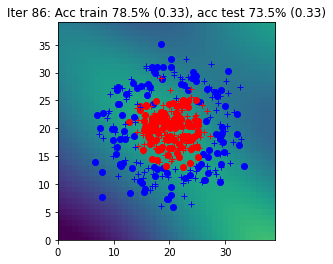

Iter 87: Acc train 78.5% (0.33), acc test 73.5% (0.33)


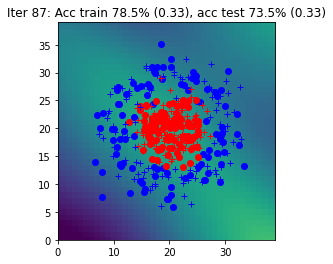

Iter 88: Acc train 78.5% (0.33), acc test 73.5% (0.33)


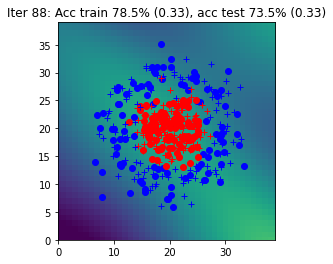

Iter 89: Acc train 78.5% (0.33), acc test 73.5% (0.33)


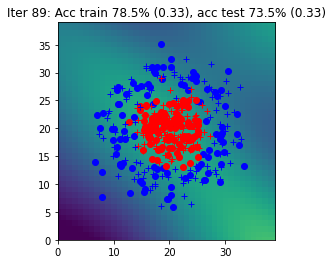

Iter 90: Acc train 78.0% (0.33), acc test 74.5% (0.33)


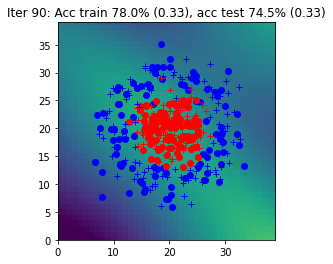

Iter 91: Acc train 78.0% (0.33), acc test 74.0% (0.33)


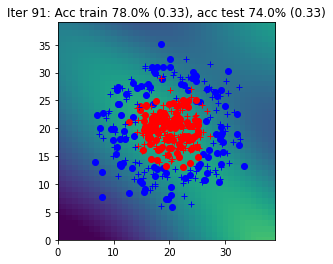

Iter 92: Acc train 78.5% (0.32), acc test 73.5% (0.33)


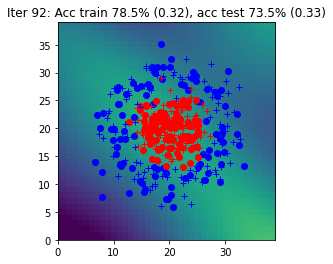

Iter 93: Acc train 78.0% (0.32), acc test 74.0% (0.33)


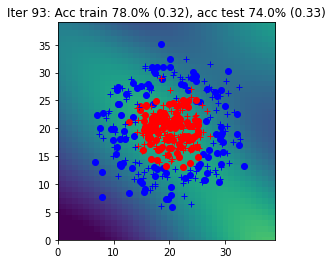

Iter 94: Acc train 78.5% (0.32), acc test 74.5% (0.33)


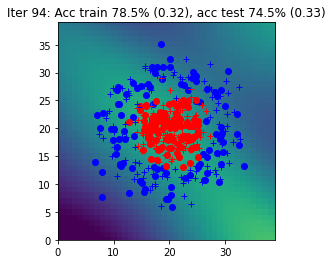

Iter 95: Acc train 78.0% (0.32), acc test 73.5% (0.33)


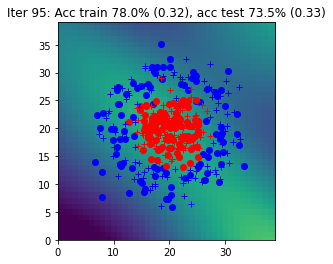

Iter 96: Acc train 77.5% (0.32), acc test 74.0% (0.33)


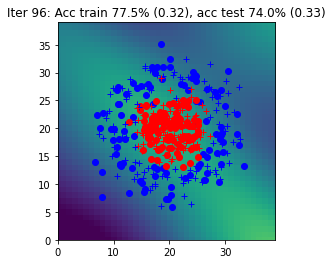

Iter 97: Acc train 77.5% (0.32), acc test 74.0% (0.33)


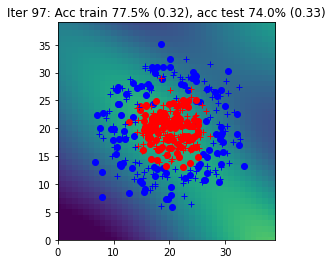

Iter 98: Acc train 78.0% (0.32), acc test 74.0% (0.33)


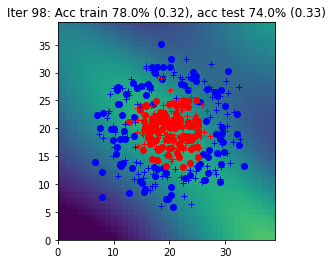

Iter 99: Acc train 78.0% (0.32), acc test 74.0% (0.32)


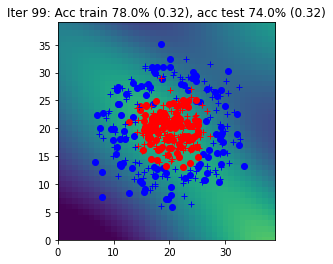

Iter 100: Acc train 78.0% (0.32), acc test 74.0% (0.32)


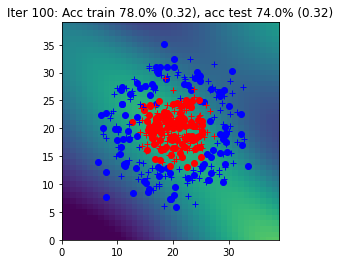

Iter 101: Acc train 78.5% (0.32), acc test 74.5% (0.32)


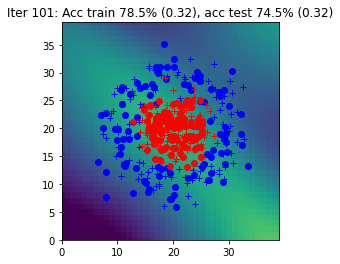

Iter 102: Acc train 78.5% (0.32), acc test 74.5% (0.32)


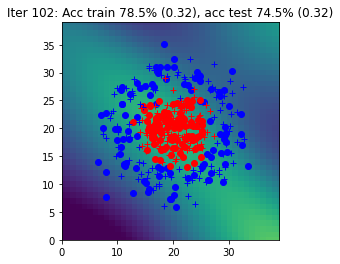

Iter 103: Acc train 78.5% (0.32), acc test 74.5% (0.32)


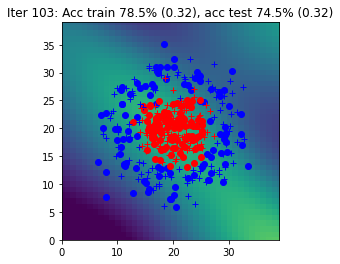

Iter 104: Acc train 78.5% (0.32), acc test 75.0% (0.32)


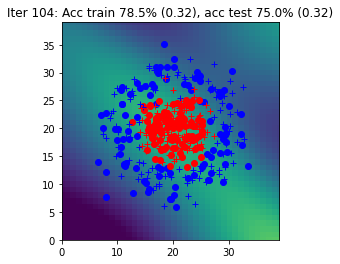

Iter 105: Acc train 78.5% (0.32), acc test 75.0% (0.32)


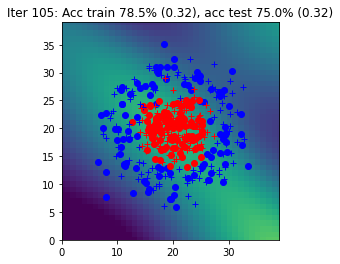

Iter 106: Acc train 78.5% (0.32), acc test 75.0% (0.32)


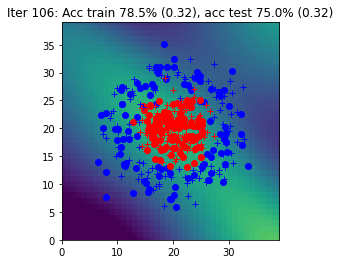

Iter 107: Acc train 78.5% (0.32), acc test 75.0% (0.32)


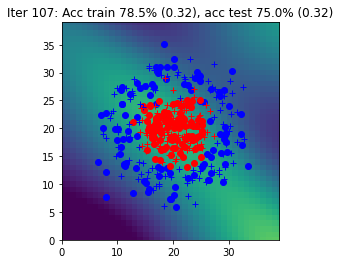

Iter 108: Acc train 78.5% (0.31), acc test 75.5% (0.32)


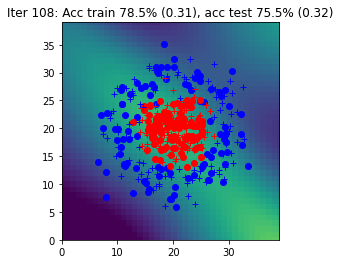

Iter 109: Acc train 78.5% (0.31), acc test 75.5% (0.32)


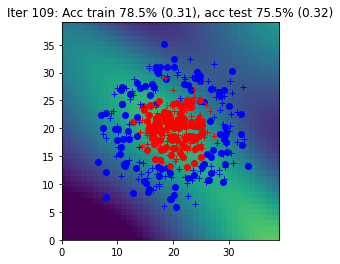

Iter 110: Acc train 78.5% (0.31), acc test 75.5% (0.32)


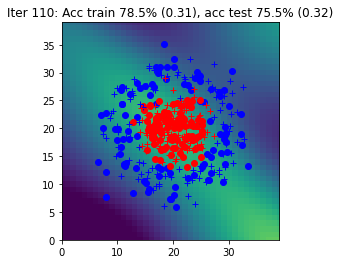

Iter 111: Acc train 78.5% (0.31), acc test 75.5% (0.32)


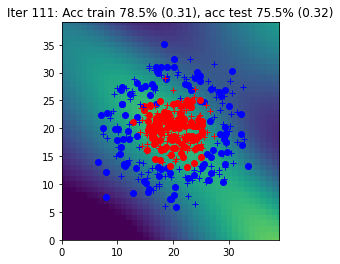

Iter 112: Acc train 79.0% (0.31), acc test 76.0% (0.32)


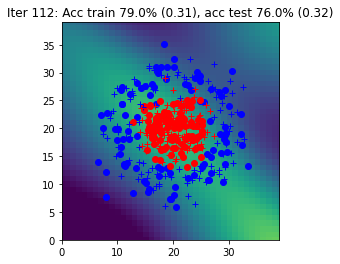

Iter 113: Acc train 78.5% (0.31), acc test 76.0% (0.32)


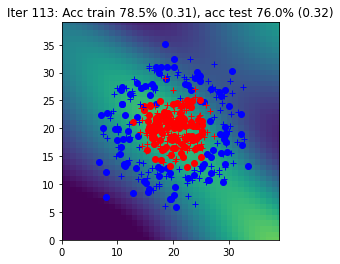

Iter 114: Acc train 78.5% (0.31), acc test 76.0% (0.32)


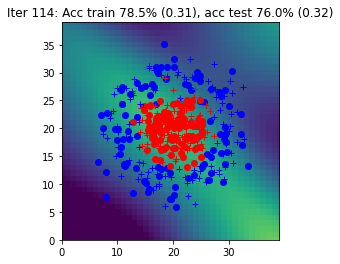

Iter 115: Acc train 78.5% (0.31), acc test 75.5% (0.31)


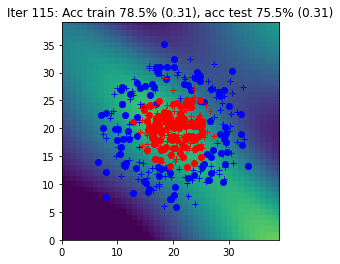

Iter 116: Acc train 78.5% (0.31), acc test 75.5% (0.31)


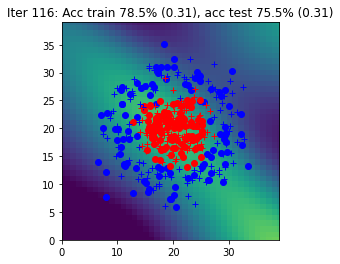

Iter 117: Acc train 78.5% (0.31), acc test 76.0% (0.31)


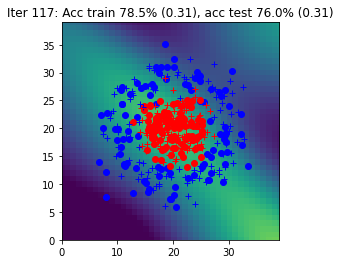

Iter 118: Acc train 79.0% (0.31), acc test 76.0% (0.31)


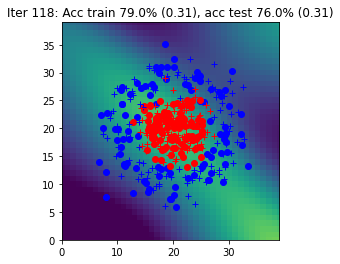

Iter 119: Acc train 79.0% (0.31), acc test 75.5% (0.31)


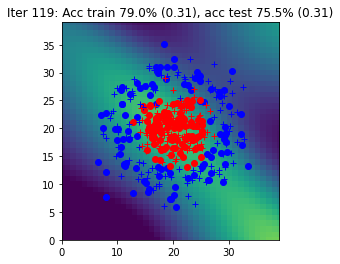

Iter 120: Acc train 78.5% (0.30), acc test 76.0% (0.31)


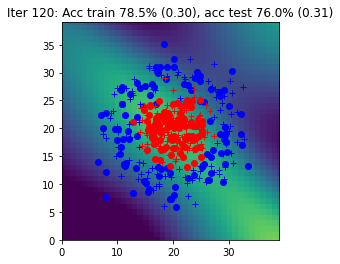

Iter 121: Acc train 78.5% (0.30), acc test 76.0% (0.31)


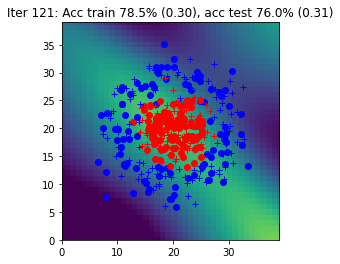

Iter 122: Acc train 79.0% (0.30), acc test 76.5% (0.31)


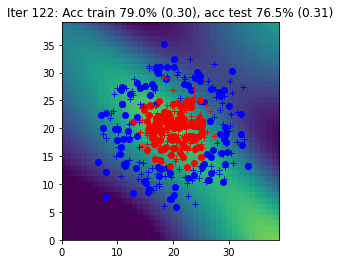

Iter 123: Acc train 80.0% (0.30), acc test 75.5% (0.31)


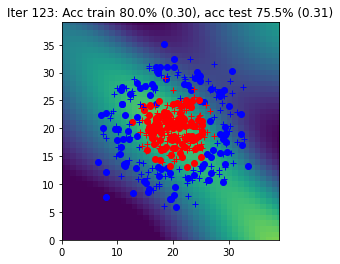

Iter 124: Acc train 80.0% (0.30), acc test 75.5% (0.31)


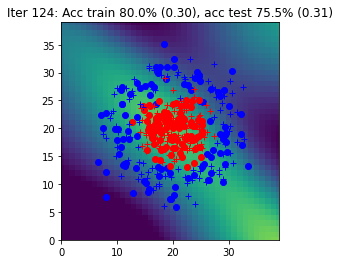

Iter 125: Acc train 80.0% (0.30), acc test 75.5% (0.31)


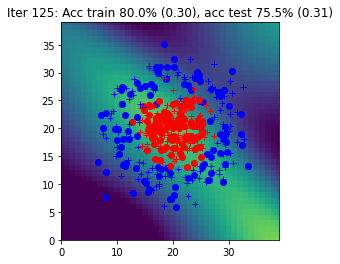

Iter 126: Acc train 80.0% (0.30), acc test 75.5% (0.31)


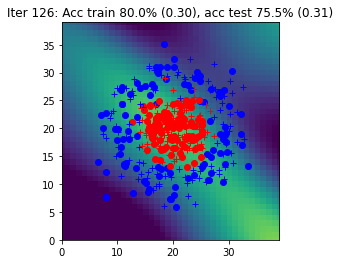

Iter 127: Acc train 80.0% (0.30), acc test 75.5% (0.31)


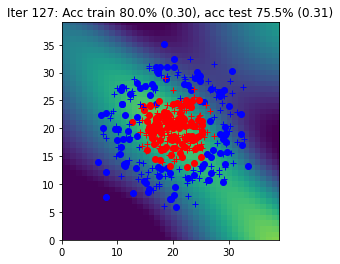

Iter 128: Acc train 80.0% (0.30), acc test 75.5% (0.30)


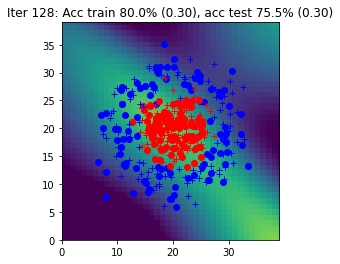

Iter 129: Acc train 80.5% (0.30), acc test 75.0% (0.30)


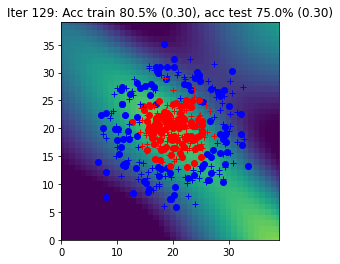

Iter 130: Acc train 80.5% (0.30), acc test 75.0% (0.30)


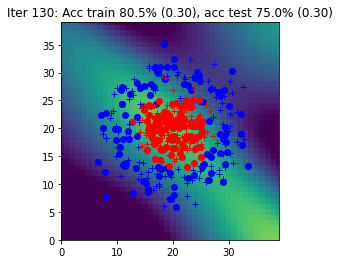

Iter 131: Acc train 81.0% (0.29), acc test 75.5% (0.30)


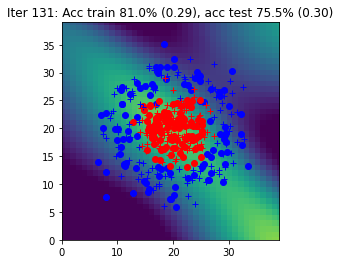

Iter 132: Acc train 81.0% (0.29), acc test 75.5% (0.30)


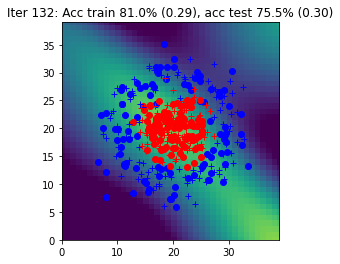

Iter 133: Acc train 80.5% (0.29), acc test 75.0% (0.30)


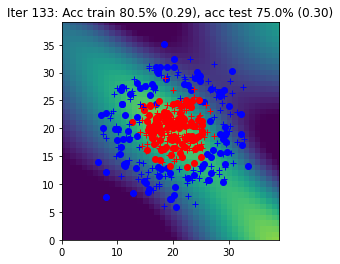

Iter 134: Acc train 80.5% (0.29), acc test 75.0% (0.30)


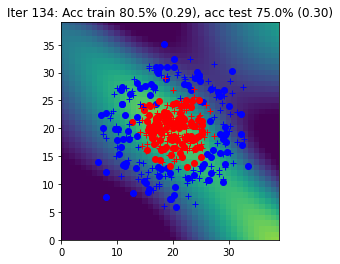

Iter 135: Acc train 81.5% (0.29), acc test 75.0% (0.30)


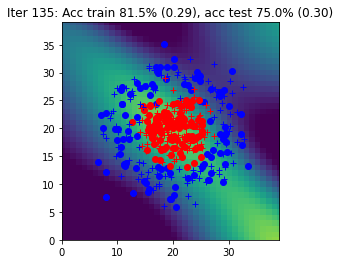

Iter 136: Acc train 81.5% (0.29), acc test 75.5% (0.30)


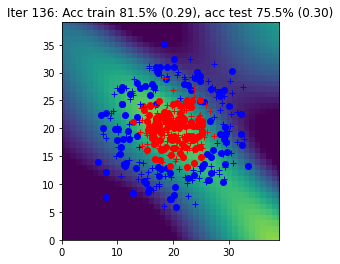

Iter 137: Acc train 81.0% (0.29), acc test 75.5% (0.30)


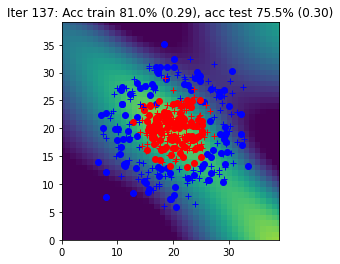

Iter 138: Acc train 81.5% (0.29), acc test 75.5% (0.30)


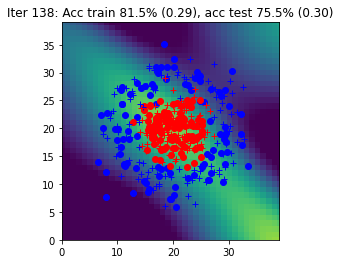

Iter 139: Acc train 81.5% (0.29), acc test 75.5% (0.30)


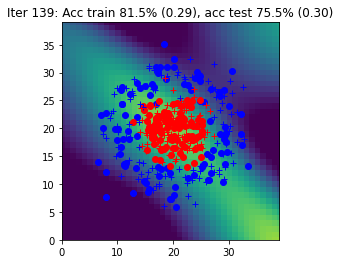

Iter 140: Acc train 81.5% (0.29), acc test 76.0% (0.29)


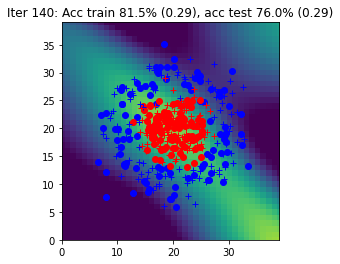

Iter 141: Acc train 81.5% (0.29), acc test 75.5% (0.29)


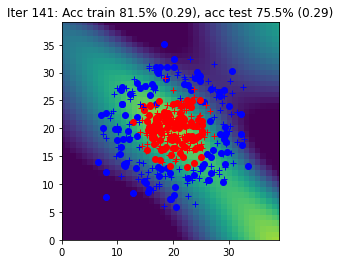

Iter 142: Acc train 81.5% (0.28), acc test 76.0% (0.29)


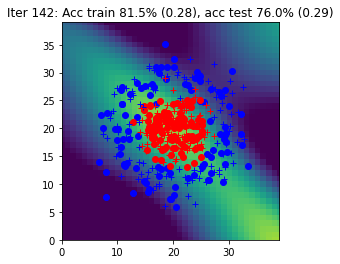

Iter 143: Acc train 81.5% (0.28), acc test 76.0% (0.29)


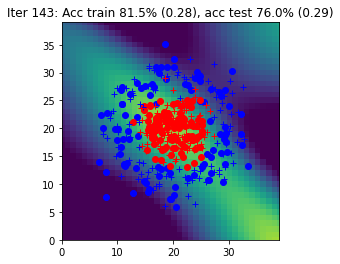

Iter 144: Acc train 81.5% (0.28), acc test 76.5% (0.29)


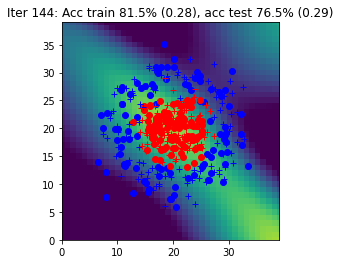

Iter 145: Acc train 82.0% (0.28), acc test 76.0% (0.29)


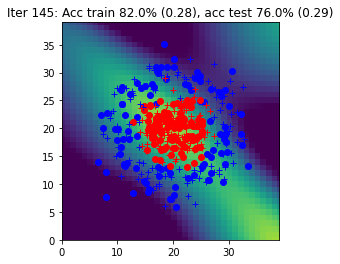

Iter 146: Acc train 82.0% (0.28), acc test 76.5% (0.29)


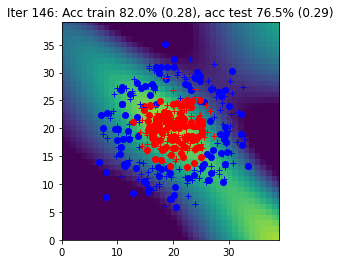

Iter 147: Acc train 82.0% (0.28), acc test 76.0% (0.29)


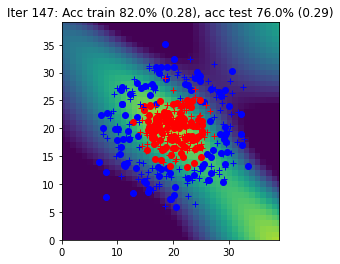

Iter 148: Acc train 82.5% (0.28), acc test 77.0% (0.29)


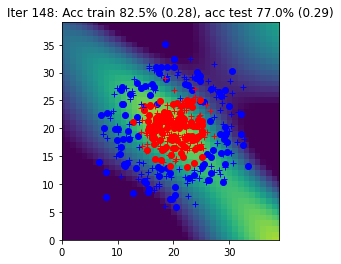

Iter 149: Acc train 82.5% (0.28), acc test 76.5% (0.29)


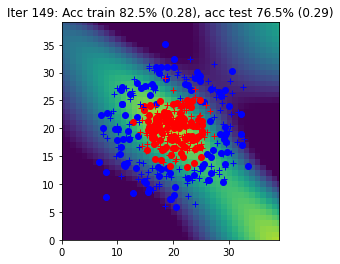

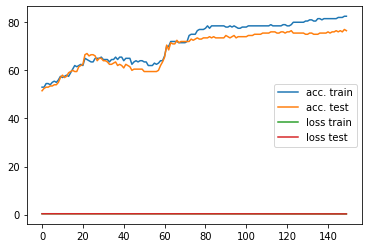

In [127]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]


    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]
  
        Yhat, outputs = forward(params, X)
        L, _ = loss_accuracy(Yhat, Y)
        L.backward()
        params = sgd(params, eta)



    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)  

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() est utilisé pour détacher les predictions du graphes de calcul autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 3 : Simplification du forward avec `torch.nn`

`init_params` et `forward` sont supprimés et remplacés par une fonction `init_model` qui déclare l'architecture du modèle et la loss.

In [128]:
def init_model(nx, nh, ny):


    model = torch.nn.Sequential(torch.nn.Linear(nx, nh),
                                torch.nn.Tanh(),
                                torch.nn.Linear(nh, ny))
    loss = torch.nn.CrossEntropyLoss()


    return model, loss

In [129]:
def loss_accuracy(loss, Yhat, Y):


    L = loss(Yhat, Y.argmax(dim=1))

    _, indYhat = torch.max(Yhat, 1)
    _, indY = torch.max(Y, 1)

    acc = torch.sum(indY == indYhat) * 100. / indY.size(0)


    return L, acc

In [130]:
def sgd(model, eta):

    with torch.no_grad():
      for param in model.parameters():
        param -= eta * param.grad
      
      model.zero_grad()


    return model

## Algorithme global d'apprentissage (avec autograd et les couches `torch.nn`)

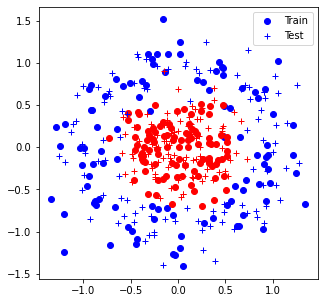

Iter 0: Acc train 48.0% (0.71), acc test 47.5% (0.70)


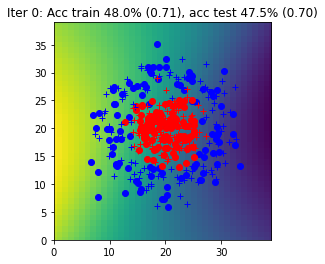

Iter 1: Acc train 47.5% (0.70), acc test 48.5% (0.70)


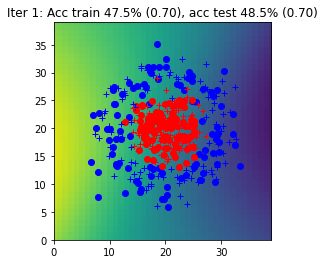

Iter 2: Acc train 48.5% (0.70), acc test 48.5% (0.70)


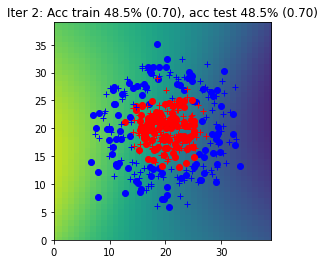

Iter 3: Acc train 48.5% (0.70), acc test 49.0% (0.70)


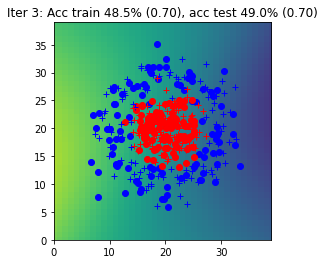

Iter 4: Acc train 52.5% (0.70), acc test 51.5% (0.69)


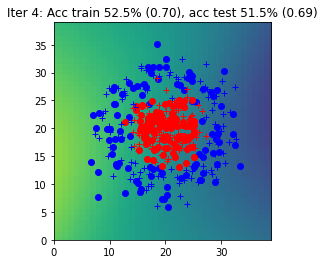

Iter 5: Acc train 53.5% (0.70), acc test 56.0% (0.69)


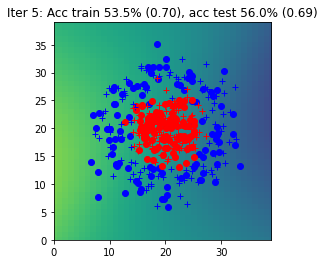

Iter 6: Acc train 53.5% (0.70), acc test 56.5% (0.69)


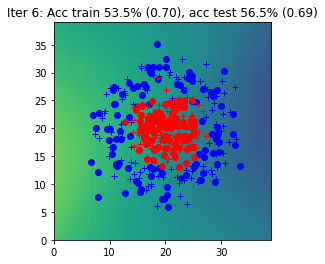

Iter 7: Acc train 54.5% (0.69), acc test 58.5% (0.69)


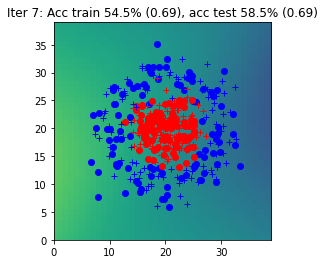

Iter 8: Acc train 54.5% (0.69), acc test 59.0% (0.69)


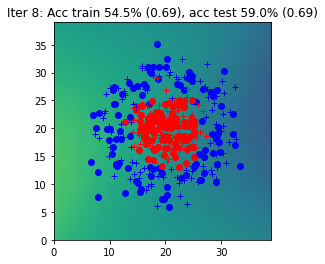

Iter 9: Acc train 57.5% (0.69), acc test 62.0% (0.69)


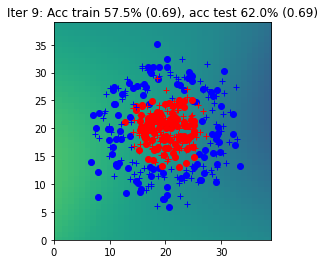

Iter 10: Acc train 55.5% (0.69), acc test 60.0% (0.69)


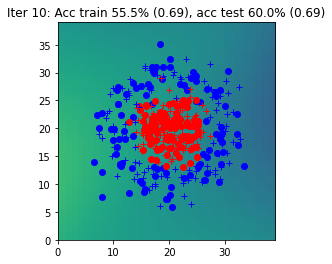

Iter 11: Acc train 58.0% (0.69), acc test 61.5% (0.69)


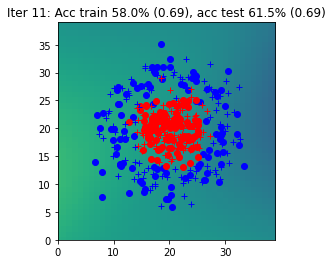

Iter 12: Acc train 55.0% (0.69), acc test 60.5% (0.69)


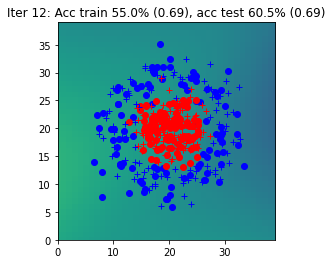

Iter 13: Acc train 58.5% (0.69), acc test 62.5% (0.69)


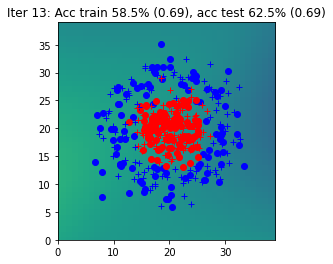

Iter 14: Acc train 60.5% (0.69), acc test 63.0% (0.69)


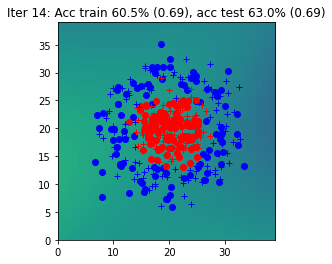

Iter 15: Acc train 60.0% (0.69), acc test 65.5% (0.69)


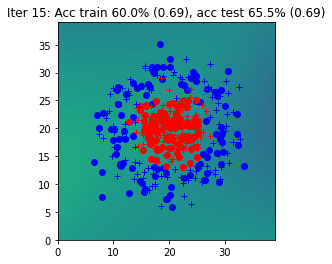

Iter 16: Acc train 60.0% (0.69), acc test 65.5% (0.69)


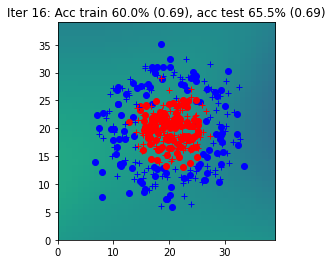

Iter 17: Acc train 61.0% (0.69), acc test 64.5% (0.69)


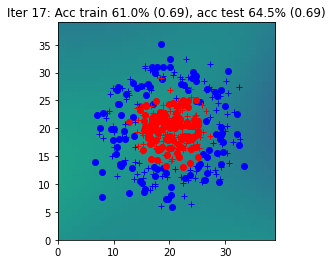

Iter 18: Acc train 62.5% (0.69), acc test 66.5% (0.69)


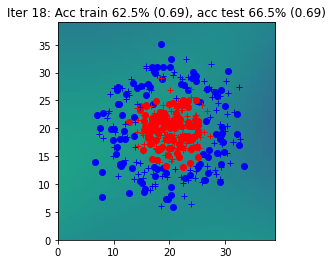

Iter 19: Acc train 64.5% (0.69), acc test 66.0% (0.69)


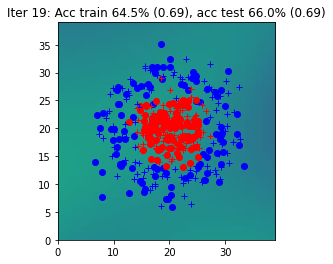

Iter 20: Acc train 66.0% (0.69), acc test 70.5% (0.68)


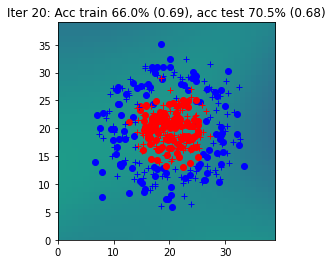

Iter 21: Acc train 65.5% (0.68), acc test 66.5% (0.68)


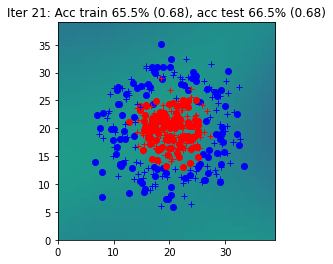

Iter 22: Acc train 64.5% (0.68), acc test 65.0% (0.68)


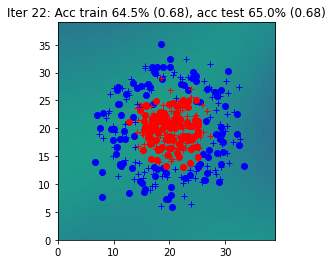

Iter 23: Acc train 64.5% (0.68), acc test 64.0% (0.68)


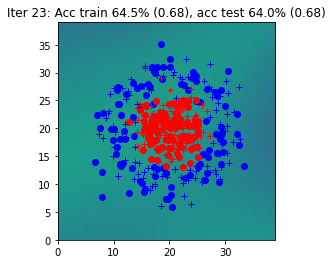

Iter 24: Acc train 66.5% (0.68), acc test 66.0% (0.68)


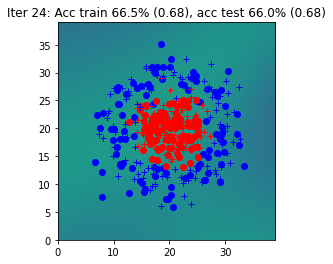

Iter 25: Acc train 66.5% (0.68), acc test 69.0% (0.68)


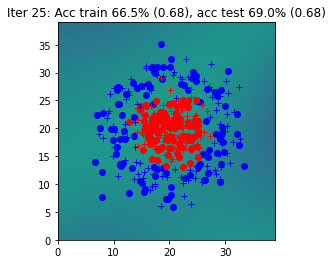

Iter 26: Acc train 70.0% (0.68), acc test 72.5% (0.68)


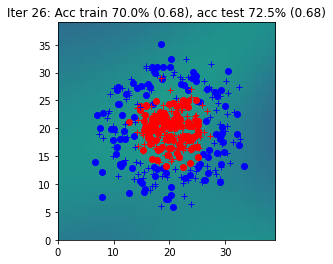

Iter 27: Acc train 67.5% (0.68), acc test 68.0% (0.68)


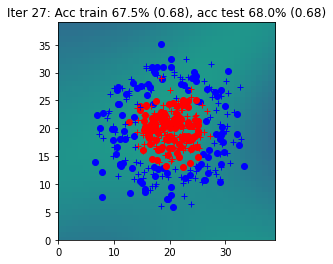

Iter 28: Acc train 68.0% (0.68), acc test 68.0% (0.68)


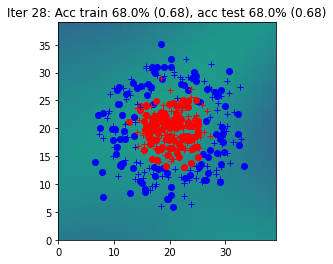

Iter 29: Acc train 66.5% (0.68), acc test 65.0% (0.68)


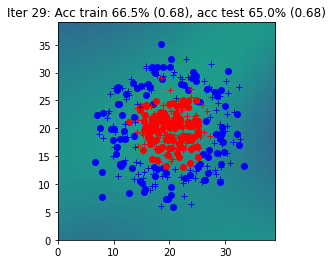

Iter 30: Acc train 73.5% (0.68), acc test 73.5% (0.68)


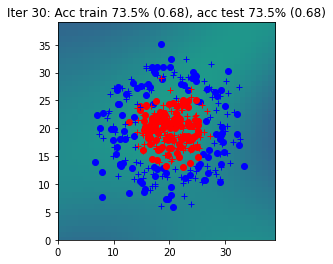

Iter 31: Acc train 79.5% (0.68), acc test 78.5% (0.68)


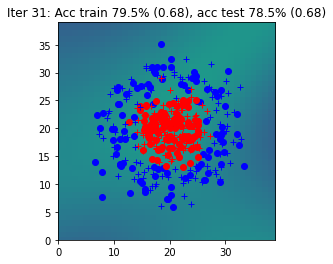

Iter 32: Acc train 73.0% (0.67), acc test 73.5% (0.67)


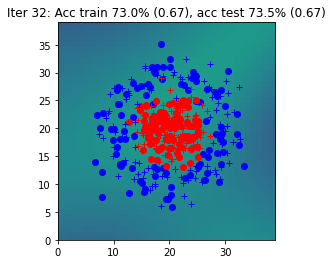

Iter 33: Acc train 79.5% (0.67), acc test 78.5% (0.67)


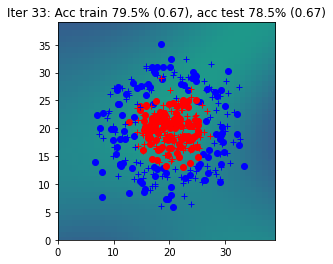

Iter 34: Acc train 75.0% (0.67), acc test 76.5% (0.67)


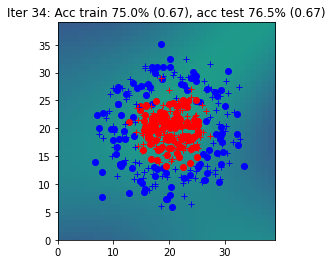

Iter 35: Acc train 70.5% (0.67), acc test 69.5% (0.67)


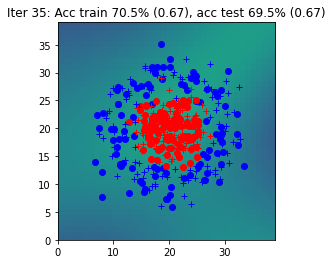

Iter 36: Acc train 72.0% (0.67), acc test 72.0% (0.67)


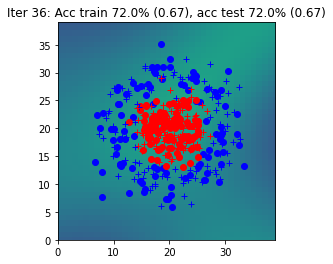

Iter 37: Acc train 74.5% (0.67), acc test 76.0% (0.67)


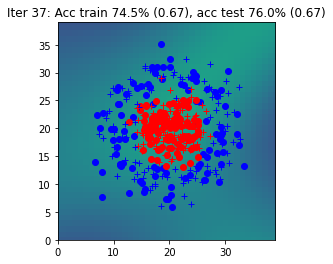

Iter 38: Acc train 80.0% (0.67), acc test 80.0% (0.67)


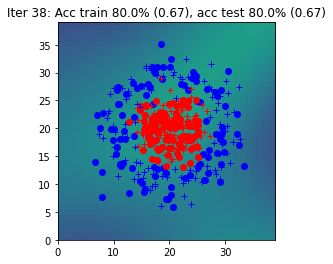

Iter 39: Acc train 76.0% (0.67), acc test 76.5% (0.67)


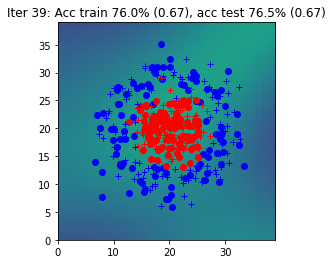

Iter 40: Acc train 76.0% (0.66), acc test 76.5% (0.66)


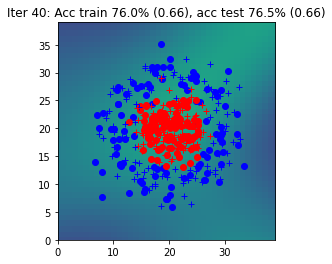

Iter 41: Acc train 80.5% (0.66), acc test 81.5% (0.66)


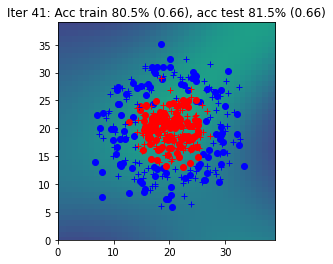

Iter 42: Acc train 80.0% (0.66), acc test 79.0% (0.66)


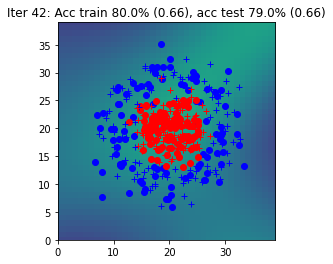

Iter 43: Acc train 85.0% (0.66), acc test 84.0% (0.66)


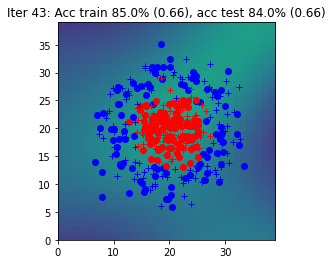

Iter 44: Acc train 78.0% (0.66), acc test 76.5% (0.66)


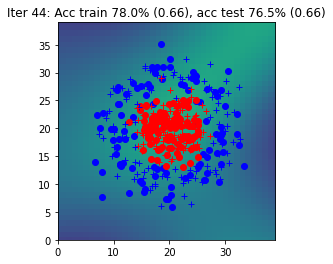

Iter 45: Acc train 74.0% (0.66), acc test 75.0% (0.66)


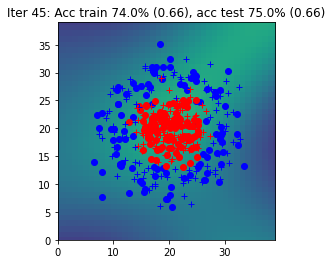

Iter 46: Acc train 80.5% (0.65), acc test 80.5% (0.65)


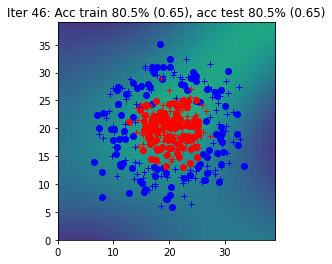

Iter 47: Acc train 80.5% (0.65), acc test 79.5% (0.65)


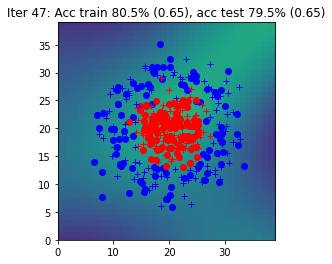

Iter 48: Acc train 82.5% (0.65), acc test 81.5% (0.65)


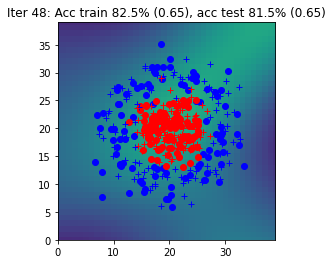

Iter 49: Acc train 83.5% (0.65), acc test 81.5% (0.65)


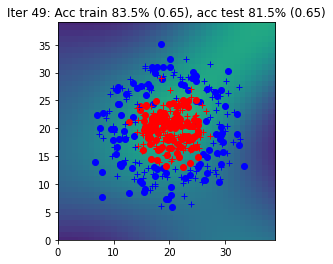

Iter 50: Acc train 83.5% (0.64), acc test 82.0% (0.65)


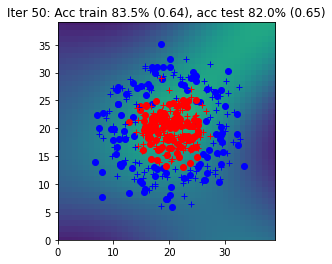

Iter 51: Acc train 86.0% (0.64), acc test 85.0% (0.64)


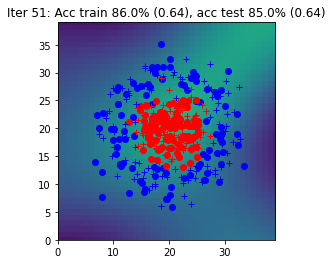

Iter 52: Acc train 84.5% (0.64), acc test 82.0% (0.64)


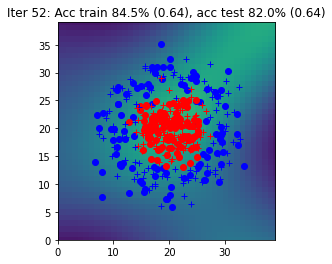

Iter 53: Acc train 83.5% (0.64), acc test 81.0% (0.64)


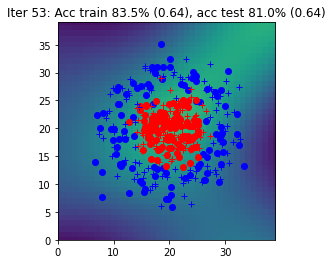

Iter 54: Acc train 85.0% (0.63), acc test 81.0% (0.64)


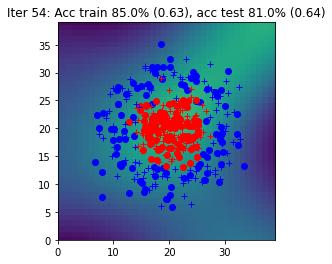

Iter 55: Acc train 83.0% (0.63), acc test 80.0% (0.63)


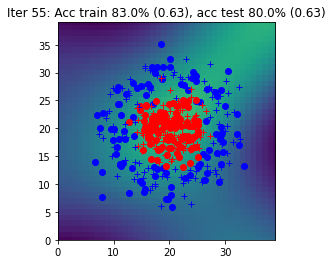

Iter 56: Acc train 81.5% (0.63), acc test 80.5% (0.63)


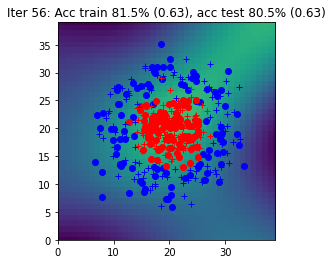

Iter 57: Acc train 85.0% (0.62), acc test 83.0% (0.63)


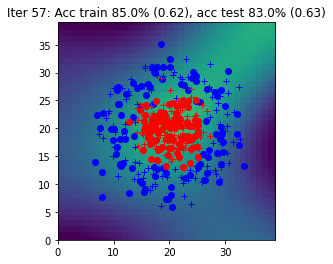

Iter 58: Acc train 86.0% (0.62), acc test 86.0% (0.62)


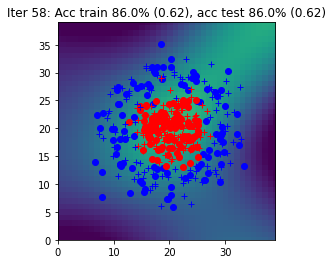

Iter 59: Acc train 85.0% (0.62), acc test 84.0% (0.62)


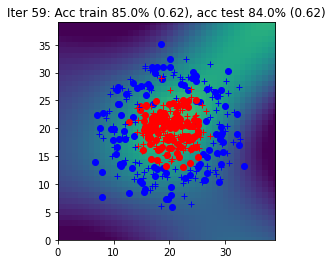

Iter 60: Acc train 86.0% (0.61), acc test 84.5% (0.62)


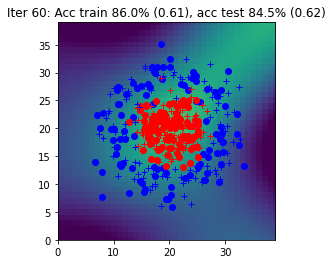

Iter 61: Acc train 83.5% (0.61), acc test 81.0% (0.61)


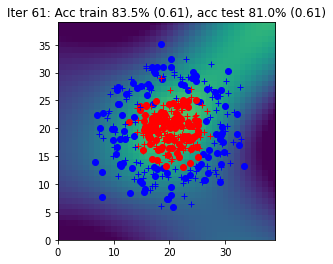

Iter 62: Acc train 86.5% (0.61), acc test 84.0% (0.61)


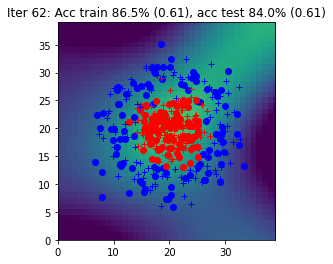

Iter 63: Acc train 84.5% (0.60), acc test 82.5% (0.60)


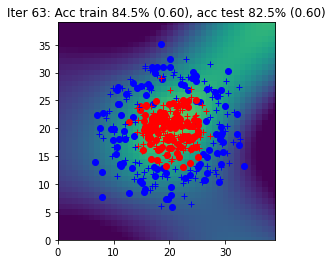

Iter 64: Acc train 83.0% (0.60), acc test 80.0% (0.60)


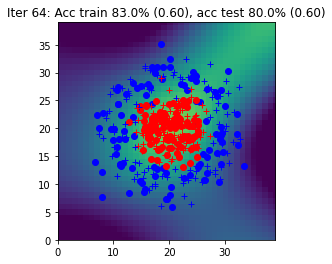

Iter 65: Acc train 83.0% (0.59), acc test 80.0% (0.60)


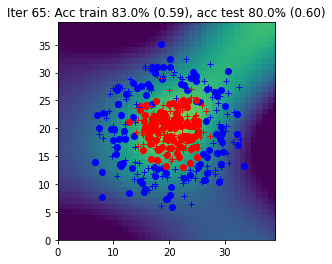

Iter 66: Acc train 87.0% (0.59), acc test 84.0% (0.59)


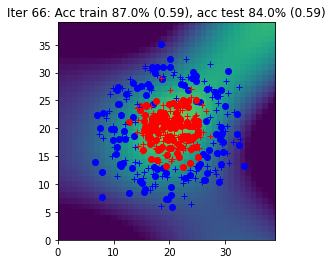

Iter 67: Acc train 84.5% (0.59), acc test 83.0% (0.59)


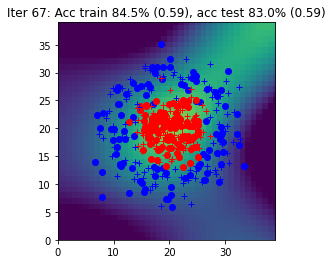

Iter 68: Acc train 87.0% (0.58), acc test 84.5% (0.58)


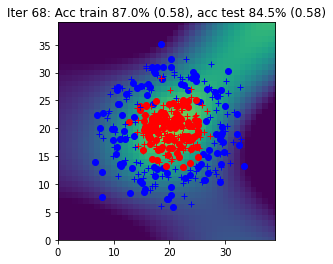

Iter 69: Acc train 87.0% (0.58), acc test 85.0% (0.58)


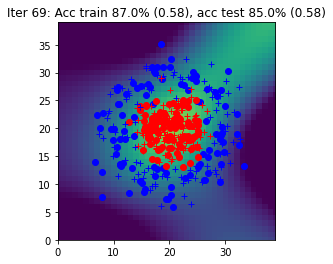

Iter 70: Acc train 87.0% (0.57), acc test 85.0% (0.57)


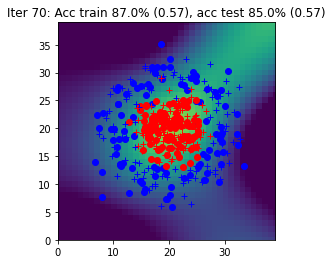

Iter 71: Acc train 87.5% (0.57), acc test 86.5% (0.57)


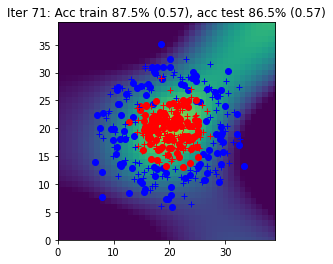

Iter 72: Acc train 86.0% (0.56), acc test 87.5% (0.56)


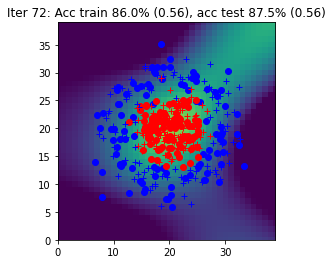

Iter 73: Acc train 87.5% (0.55), acc test 85.0% (0.56)


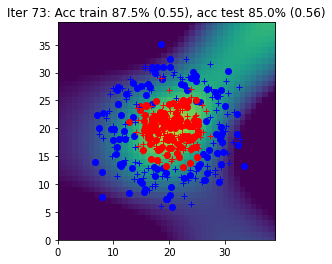

Iter 74: Acc train 87.5% (0.55), acc test 85.5% (0.55)


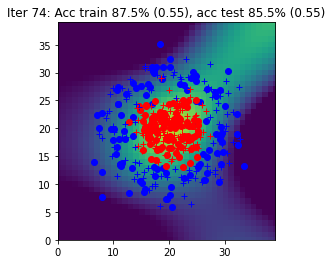

Iter 75: Acc train 87.0% (0.54), acc test 88.0% (0.55)


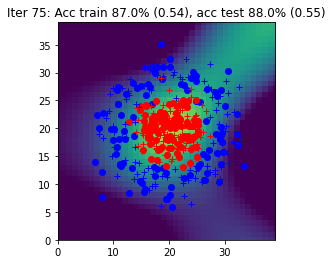

Iter 76: Acc train 88.5% (0.54), acc test 88.0% (0.54)


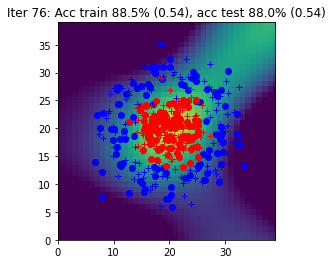

Iter 77: Acc train 87.5% (0.53), acc test 87.5% (0.54)


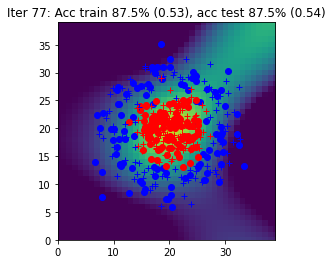

Iter 78: Acc train 87.5% (0.53), acc test 86.5% (0.53)


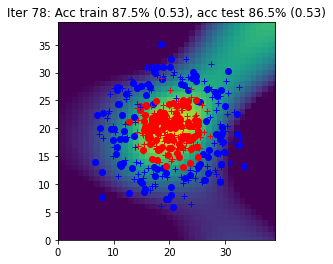

Iter 79: Acc train 88.5% (0.52), acc test 88.0% (0.53)


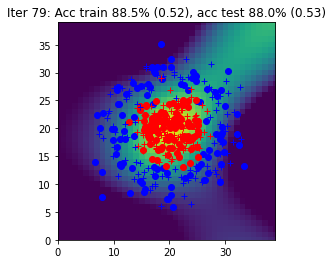

Iter 80: Acc train 89.0% (0.51), acc test 88.5% (0.52)


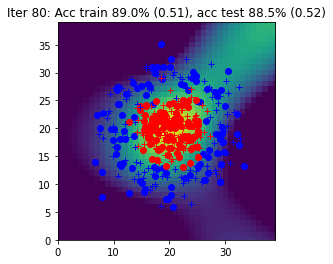

Iter 81: Acc train 88.5% (0.51), acc test 90.5% (0.51)


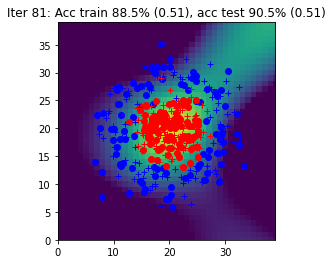

Iter 82: Acc train 89.5% (0.50), acc test 89.0% (0.51)


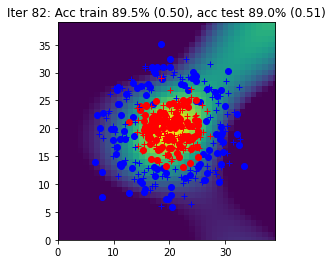

Iter 83: Acc train 90.0% (0.50), acc test 89.5% (0.50)


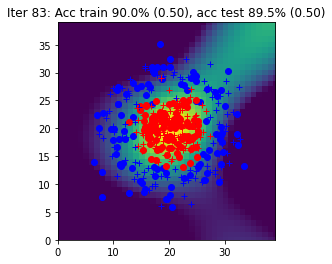

Iter 84: Acc train 89.5% (0.49), acc test 92.0% (0.50)


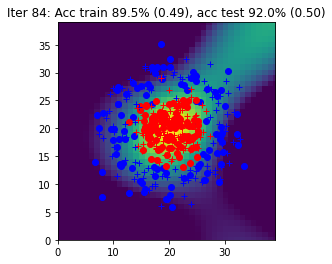

Iter 85: Acc train 90.0% (0.48), acc test 90.0% (0.49)


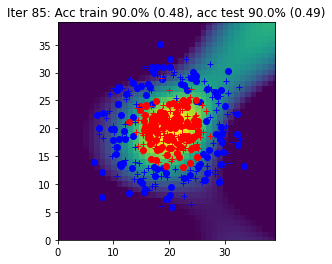

Iter 86: Acc train 90.5% (0.48), acc test 90.0% (0.48)


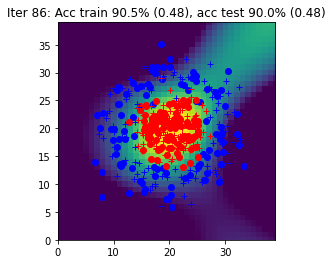

Iter 87: Acc train 90.5% (0.47), acc test 90.5% (0.48)


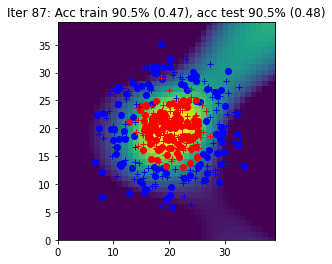

Iter 88: Acc train 91.0% (0.47), acc test 92.0% (0.47)


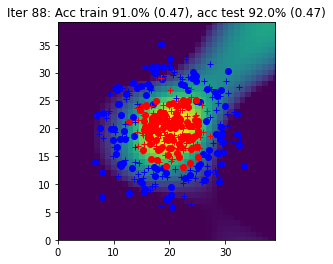

Iter 89: Acc train 92.0% (0.46), acc test 91.5% (0.47)


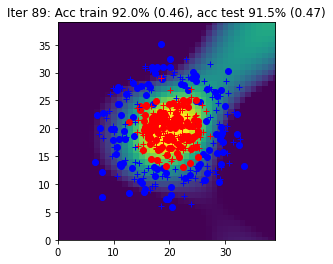

Iter 90: Acc train 92.5% (0.45), acc test 92.0% (0.46)


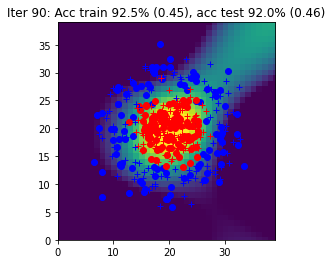

Iter 91: Acc train 92.0% (0.45), acc test 91.5% (0.45)


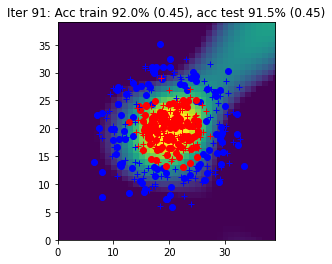

Iter 92: Acc train 92.5% (0.44), acc test 91.5% (0.45)


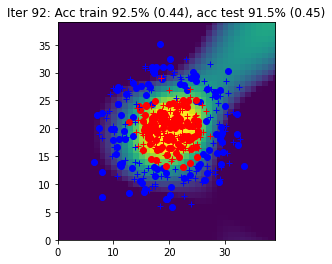

Iter 93: Acc train 93.0% (0.43), acc test 92.0% (0.44)


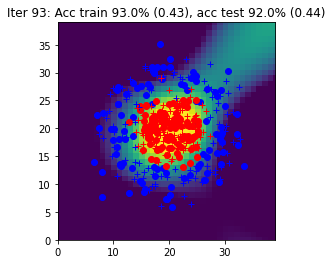

Iter 94: Acc train 92.0% (0.43), acc test 92.5% (0.44)


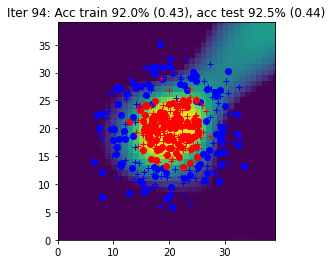

Iter 95: Acc train 92.0% (0.42), acc test 93.0% (0.43)


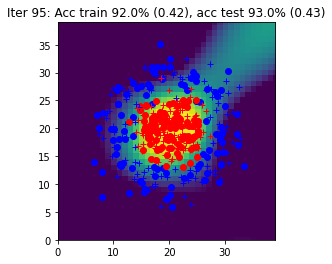

Iter 96: Acc train 92.5% (0.42), acc test 94.5% (0.42)


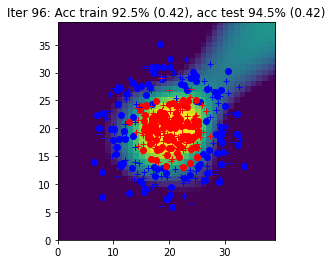

Iter 97: Acc train 92.5% (0.41), acc test 94.0% (0.42)


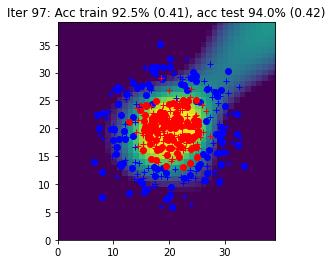

Iter 98: Acc train 93.5% (0.40), acc test 94.5% (0.41)


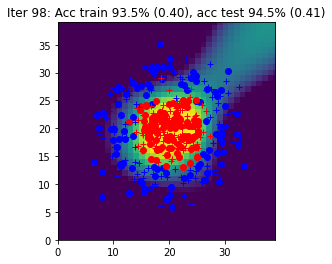

Iter 99: Acc train 94.0% (0.40), acc test 94.0% (0.41)


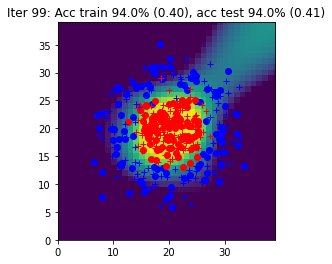

Iter 100: Acc train 92.5% (0.39), acc test 95.0% (0.40)


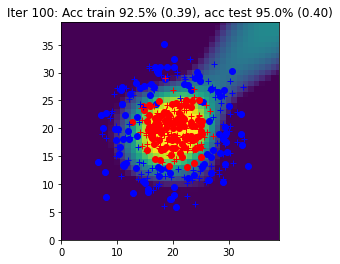

Iter 101: Acc train 92.5% (0.39), acc test 95.5% (0.40)


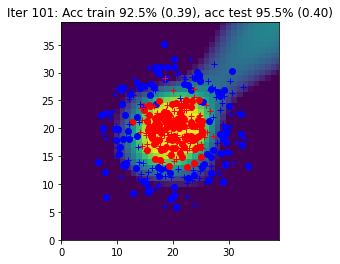

Iter 102: Acc train 92.5% (0.38), acc test 95.5% (0.39)


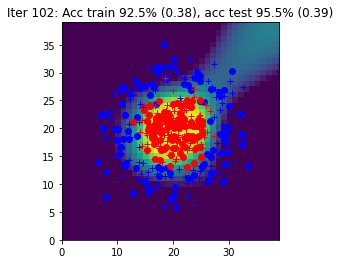

Iter 103: Acc train 93.5% (0.38), acc test 95.0% (0.39)


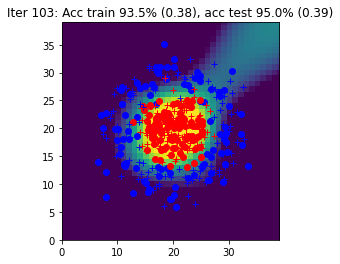

Iter 104: Acc train 93.0% (0.37), acc test 95.5% (0.38)


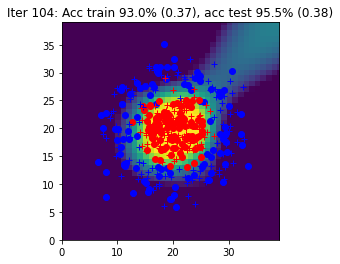

Iter 105: Acc train 93.5% (0.37), acc test 95.5% (0.38)


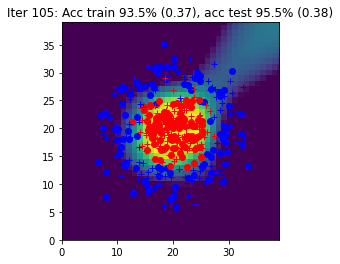

Iter 106: Acc train 94.0% (0.36), acc test 95.5% (0.37)


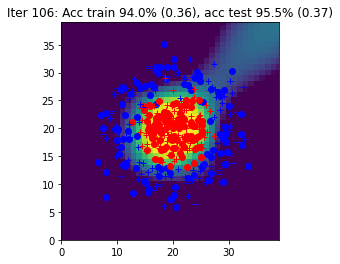

Iter 107: Acc train 94.0% (0.36), acc test 96.0% (0.37)


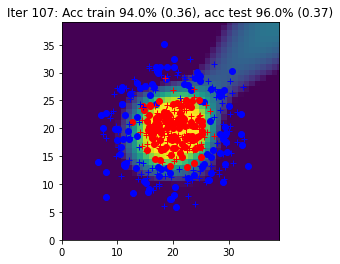

Iter 108: Acc train 93.5% (0.35), acc test 96.0% (0.36)


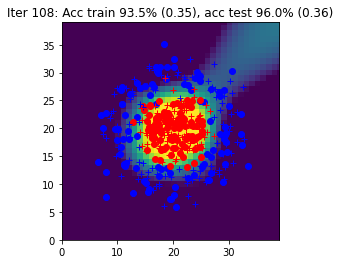

Iter 109: Acc train 93.5% (0.35), acc test 96.0% (0.36)


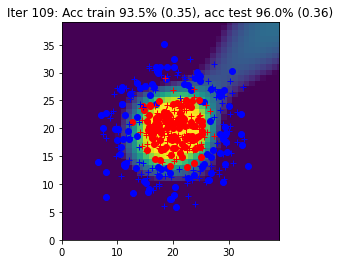

Iter 110: Acc train 93.5% (0.34), acc test 95.5% (0.35)


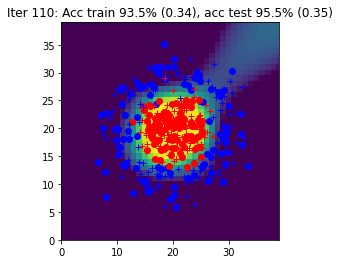

Iter 111: Acc train 93.5% (0.34), acc test 96.0% (0.35)


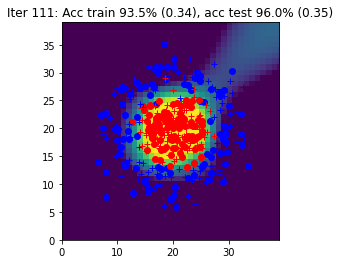

Iter 112: Acc train 94.5% (0.33), acc test 95.0% (0.34)


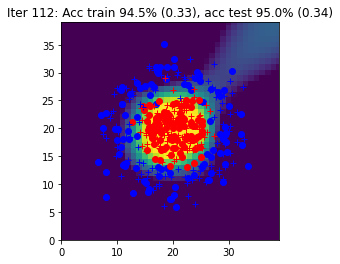

Iter 113: Acc train 94.0% (0.33), acc test 95.0% (0.34)


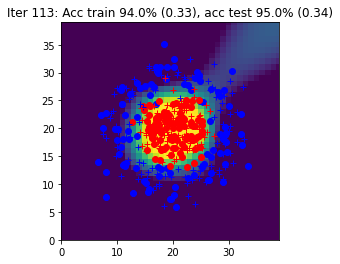

Iter 114: Acc train 94.0% (0.33), acc test 95.5% (0.34)


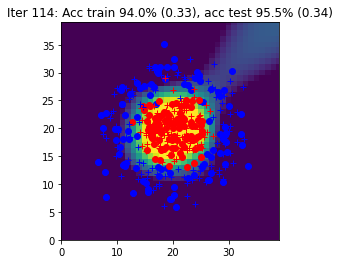

Iter 115: Acc train 94.0% (0.32), acc test 95.5% (0.33)


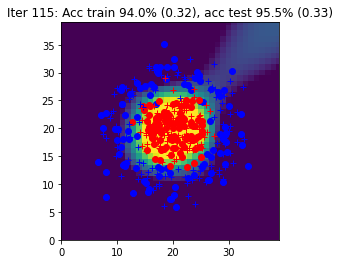

Iter 116: Acc train 95.0% (0.32), acc test 95.0% (0.33)


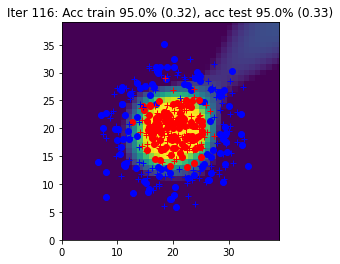

Iter 117: Acc train 94.5% (0.31), acc test 95.5% (0.32)


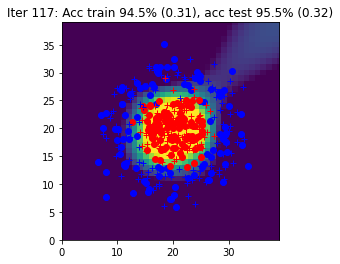

Iter 118: Acc train 95.0% (0.31), acc test 94.5% (0.32)


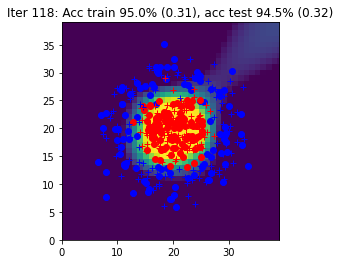

Iter 119: Acc train 94.5% (0.31), acc test 95.5% (0.32)


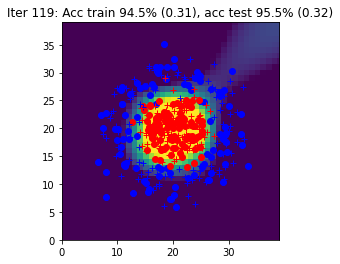

Iter 120: Acc train 94.5% (0.30), acc test 95.0% (0.31)


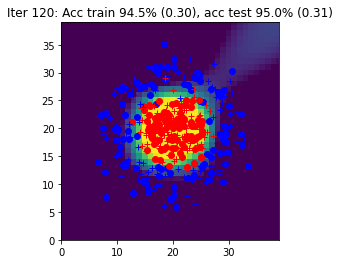

Iter 121: Acc train 95.5% (0.30), acc test 95.0% (0.31)


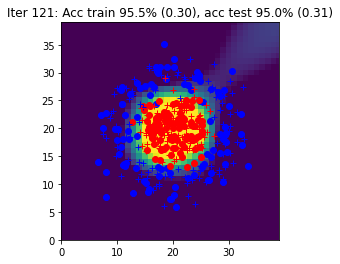

Iter 122: Acc train 95.5% (0.29), acc test 94.5% (0.31)


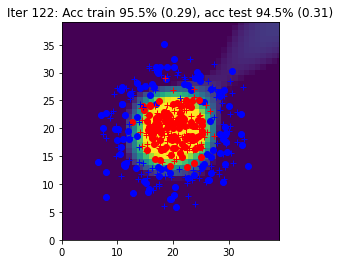

Iter 123: Acc train 95.5% (0.29), acc test 94.5% (0.30)


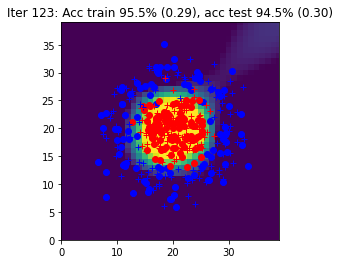

Iter 124: Acc train 96.0% (0.29), acc test 95.0% (0.30)


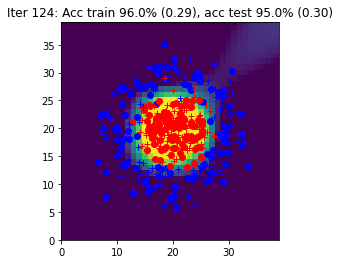

Iter 125: Acc train 96.0% (0.28), acc test 94.5% (0.30)


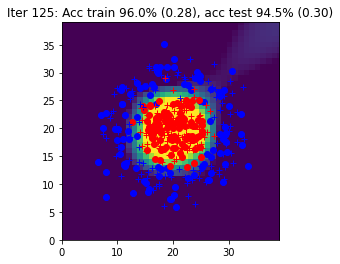

Iter 126: Acc train 95.5% (0.28), acc test 94.5% (0.29)


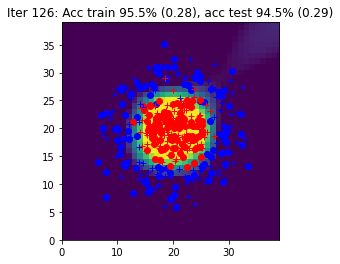

Iter 127: Acc train 95.5% (0.28), acc test 94.0% (0.29)


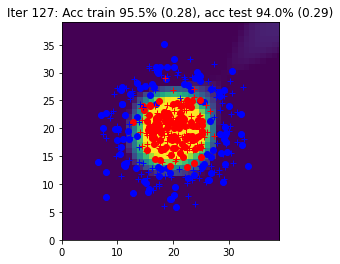

Iter 128: Acc train 95.5% (0.28), acc test 94.5% (0.29)


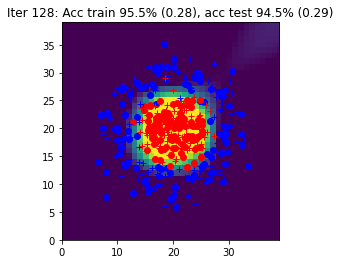

Iter 129: Acc train 96.0% (0.27), acc test 94.5% (0.29)


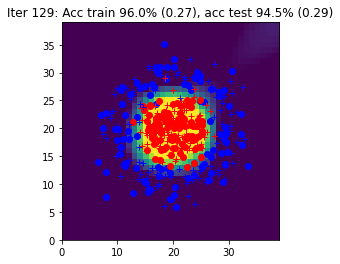

Iter 130: Acc train 95.5% (0.27), acc test 94.0% (0.28)


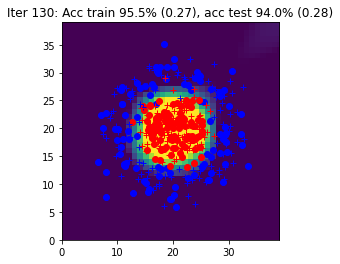

Iter 131: Acc train 96.0% (0.27), acc test 94.0% (0.28)


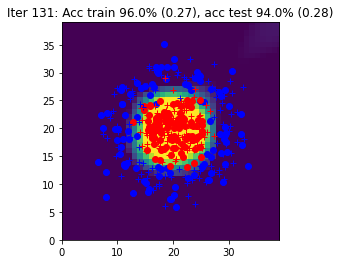

Iter 132: Acc train 96.0% (0.26), acc test 94.5% (0.28)


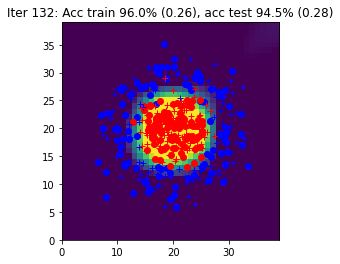

Iter 133: Acc train 96.0% (0.26), acc test 94.0% (0.27)


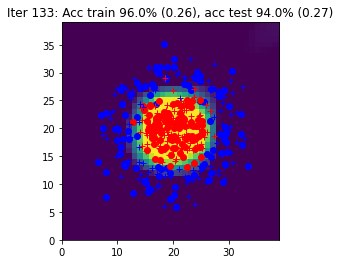

Iter 134: Acc train 96.0% (0.26), acc test 94.0% (0.27)


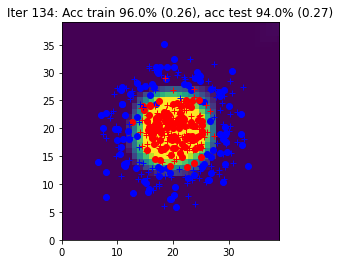

Iter 135: Acc train 96.0% (0.26), acc test 94.0% (0.27)


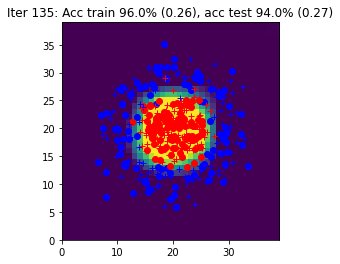

Iter 136: Acc train 96.0% (0.25), acc test 94.0% (0.27)


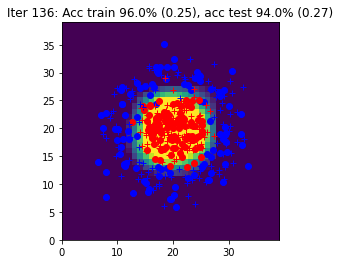

Iter 137: Acc train 96.0% (0.25), acc test 94.0% (0.27)


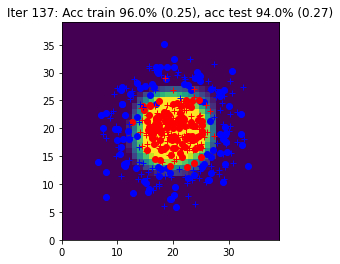

Iter 138: Acc train 96.0% (0.25), acc test 94.0% (0.26)


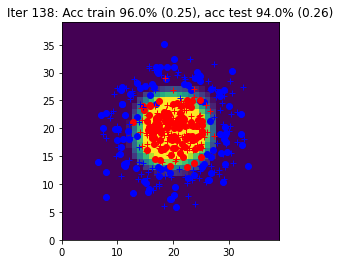

Iter 139: Acc train 96.0% (0.25), acc test 94.0% (0.26)


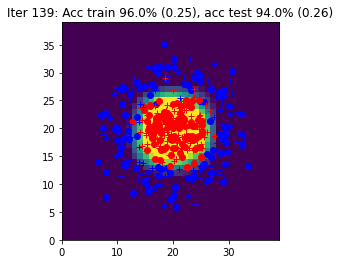

Iter 140: Acc train 96.5% (0.24), acc test 94.0% (0.26)


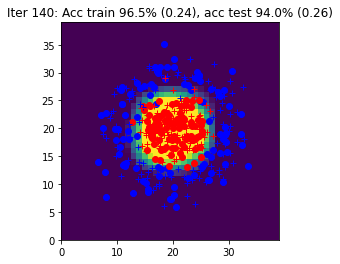

Iter 141: Acc train 96.5% (0.24), acc test 94.0% (0.26)


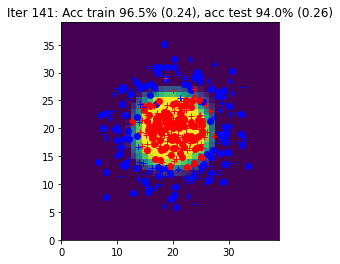

Iter 142: Acc train 96.5% (0.24), acc test 94.0% (0.25)


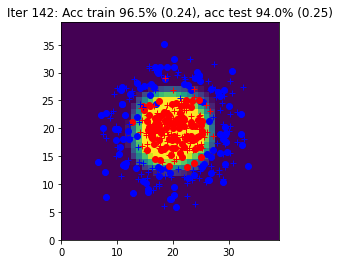

Iter 143: Acc train 96.5% (0.24), acc test 94.0% (0.25)


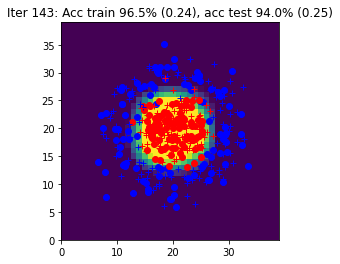

Iter 144: Acc train 96.5% (0.24), acc test 94.0% (0.25)


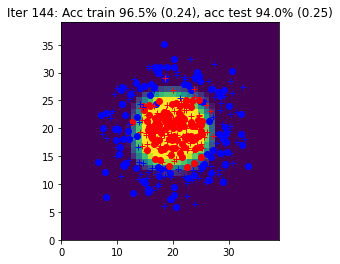

Iter 145: Acc train 96.5% (0.23), acc test 94.0% (0.25)


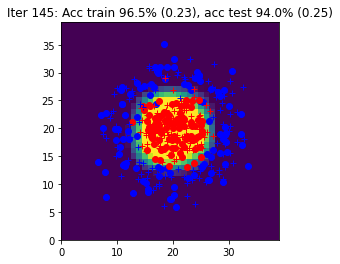

Iter 146: Acc train 96.5% (0.23), acc test 94.0% (0.25)


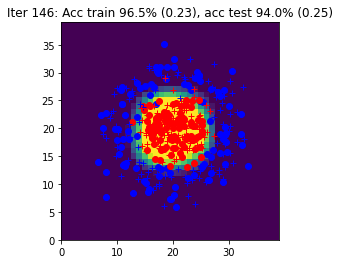

Iter 147: Acc train 96.5% (0.23), acc test 94.0% (0.24)


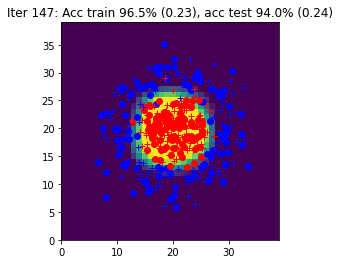

Iter 148: Acc train 96.5% (0.23), acc test 94.0% (0.24)


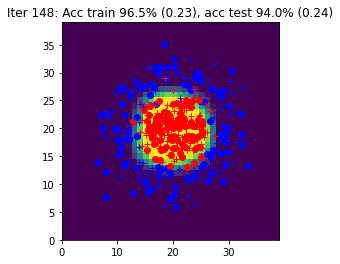

Iter 149: Acc train 96.0% (0.23), acc test 94.0% (0.24)


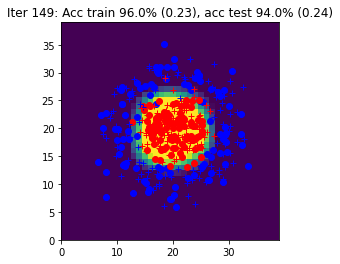

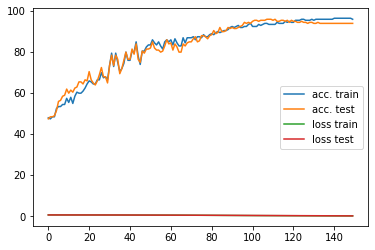

In [131]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]
  
        Yhat = model(X)
        L, _ = loss_accuracy(loss, Yhat, Y)
        L.backward()
        model = sgd(model, eta)




    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)  

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title) 
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 4 : Simplification de SGD avec `torch.optim`

In [132]:
def init_model(nx, nh, ny, eta):

    model = torch.nn.Sequential(torch.nn.Linear(nx, nh),
                                torch.nn.Tanh(),
                                torch.nn.Linear(nh, ny))
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta)

    return model, loss, optim

La fonction `sgd` est supprimée. À la place, on fera un appel à `optim.zero_grad()` avant de faire le backward et à `optim.step()` après le backward. 

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

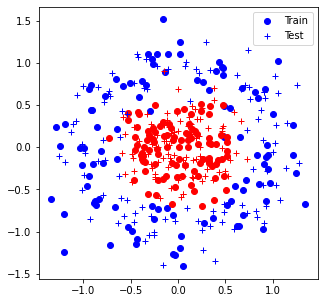

Iter 0: Acc train 62.0% (0.71), acc test 60.5% (0.71)


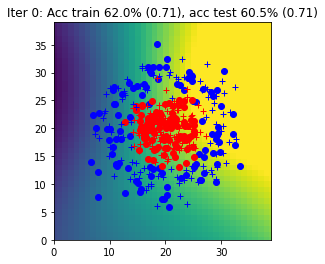

Iter 1: Acc train 67.0% (0.69), acc test 64.5% (0.69)


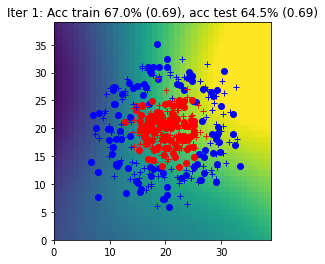

Iter 2: Acc train 67.5% (0.68), acc test 67.0% (0.69)


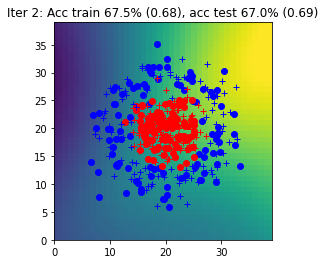

Iter 3: Acc train 66.5% (0.68), acc test 68.5% (0.68)


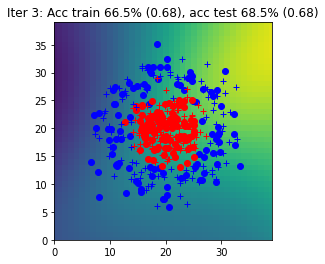

Iter 4: Acc train 69.0% (0.68), acc test 70.5% (0.68)


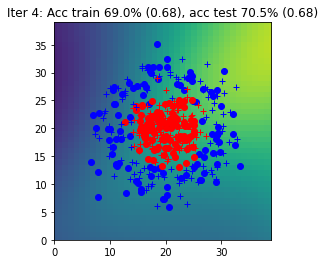

Iter 5: Acc train 73.0% (0.68), acc test 73.0% (0.68)


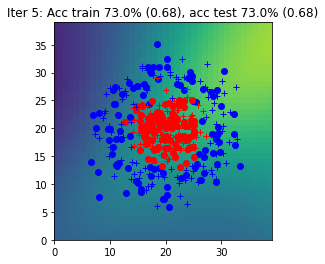

Iter 6: Acc train 75.0% (0.67), acc test 74.0% (0.67)


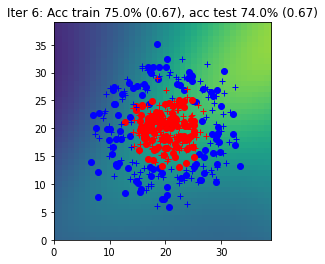

Iter 7: Acc train 75.5% (0.67), acc test 75.5% (0.67)


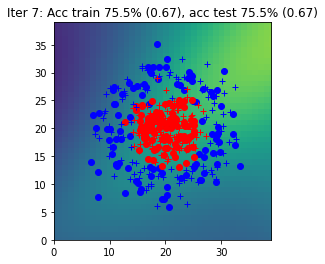

Iter 8: Acc train 74.5% (0.67), acc test 74.0% (0.67)


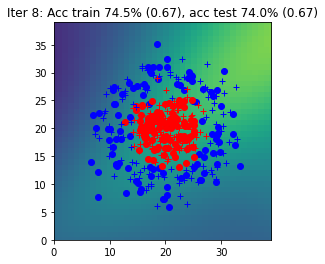

Iter 9: Acc train 76.0% (0.67), acc test 76.5% (0.67)


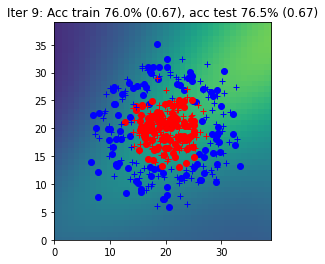

Iter 10: Acc train 76.5% (0.67), acc test 78.5% (0.67)


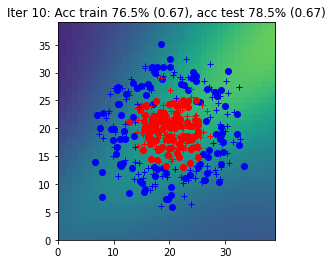

Iter 11: Acc train 74.0% (0.66), acc test 76.0% (0.66)


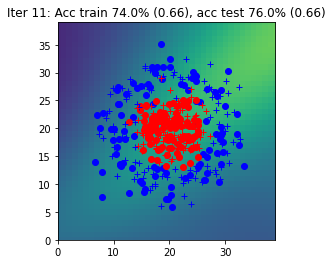

Iter 12: Acc train 74.5% (0.66), acc test 75.0% (0.66)


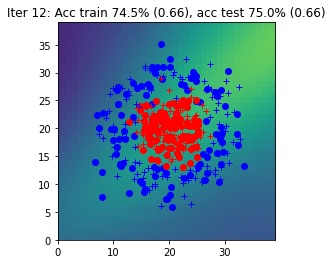

Iter 13: Acc train 77.0% (0.66), acc test 77.5% (0.66)


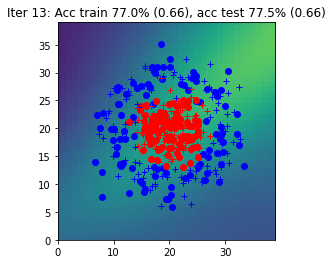

Iter 14: Acc train 77.0% (0.66), acc test 77.5% (0.66)


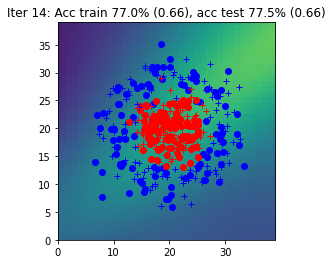

Iter 15: Acc train 77.0% (0.66), acc test 77.0% (0.66)


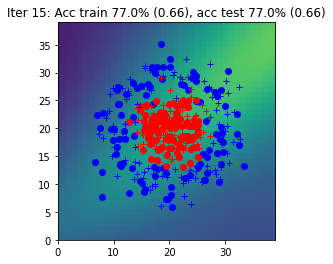

Iter 16: Acc train 80.0% (0.65), acc test 79.5% (0.65)


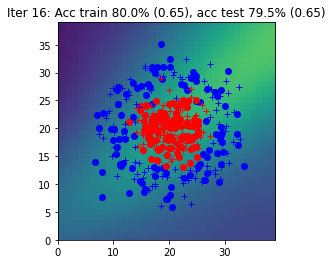

Iter 17: Acc train 77.0% (0.65), acc test 77.0% (0.65)


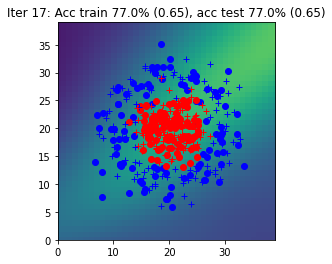

Iter 18: Acc train 78.5% (0.65), acc test 78.5% (0.65)


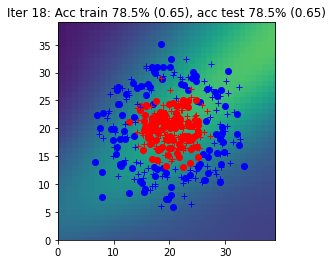

Iter 19: Acc train 74.5% (0.65), acc test 75.5% (0.65)


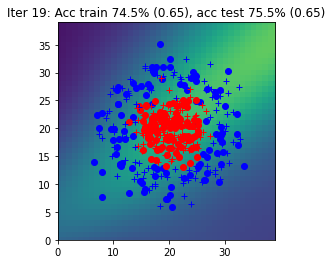

Iter 20: Acc train 75.0% (0.65), acc test 75.5% (0.65)


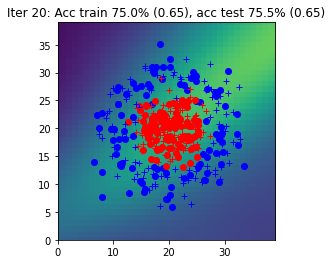

Iter 21: Acc train 78.0% (0.64), acc test 77.5% (0.64)


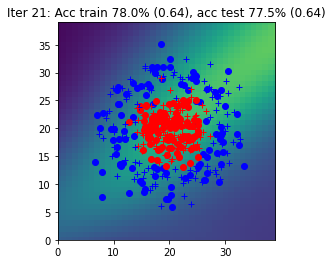

Iter 22: Acc train 78.0% (0.64), acc test 77.5% (0.64)


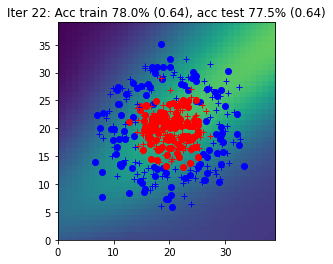

Iter 23: Acc train 78.0% (0.64), acc test 77.5% (0.64)


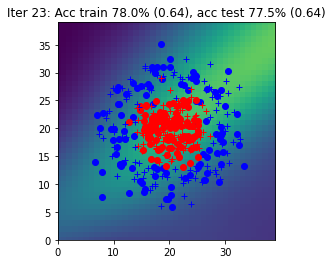

Iter 24: Acc train 78.0% (0.64), acc test 77.5% (0.64)


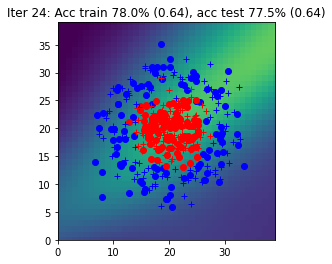

Iter 25: Acc train 77.5% (0.63), acc test 77.5% (0.63)


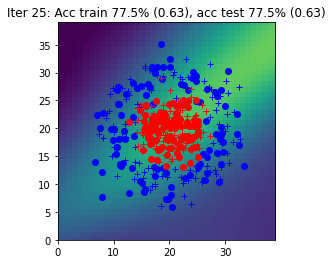

Iter 26: Acc train 78.5% (0.63), acc test 78.5% (0.63)


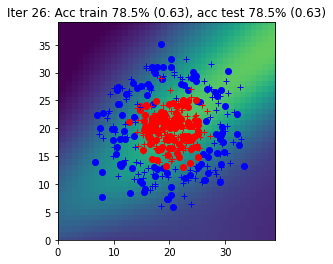

Iter 27: Acc train 79.0% (0.63), acc test 79.0% (0.63)


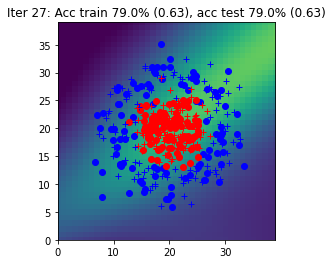

Iter 28: Acc train 79.5% (0.62), acc test 80.0% (0.62)


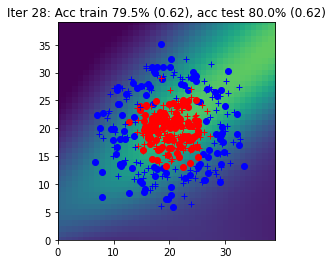

Iter 29: Acc train 79.5% (0.62), acc test 80.0% (0.62)


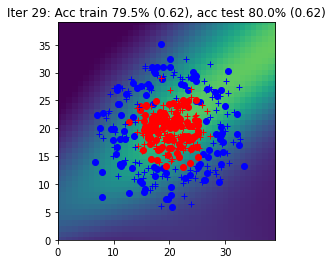

Iter 30: Acc train 79.0% (0.62), acc test 80.0% (0.62)


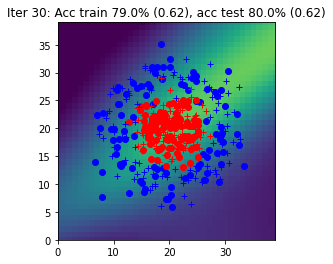

Iter 31: Acc train 77.5% (0.62), acc test 79.0% (0.62)


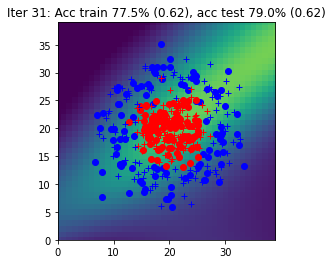

Iter 32: Acc train 79.0% (0.61), acc test 79.5% (0.61)


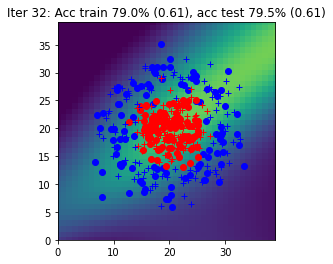

Iter 33: Acc train 80.0% (0.61), acc test 79.5% (0.61)


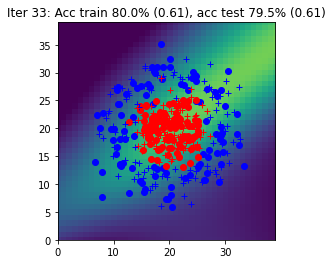

Iter 34: Acc train 79.5% (0.61), acc test 79.5% (0.61)


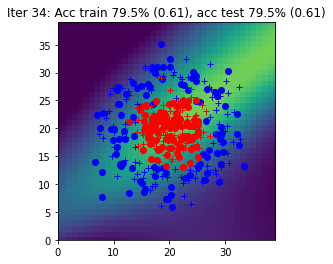

Iter 35: Acc train 79.5% (0.60), acc test 79.5% (0.60)


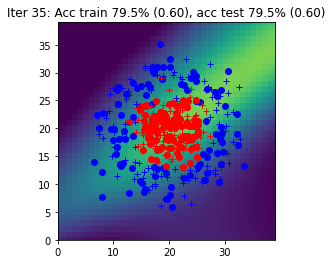

Iter 36: Acc train 79.5% (0.60), acc test 81.0% (0.60)


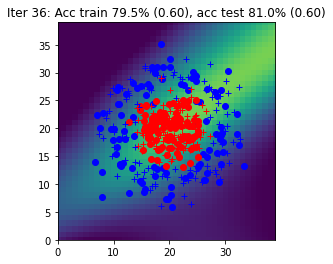

Iter 37: Acc train 79.5% (0.60), acc test 81.0% (0.60)


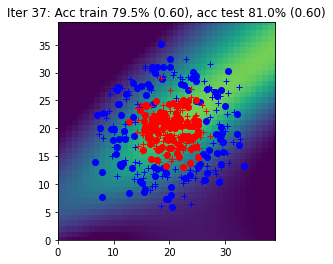

Iter 38: Acc train 79.0% (0.59), acc test 80.0% (0.59)


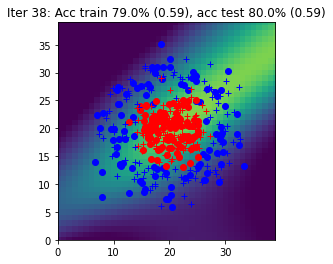

Iter 39: Acc train 79.0% (0.59), acc test 79.5% (0.59)


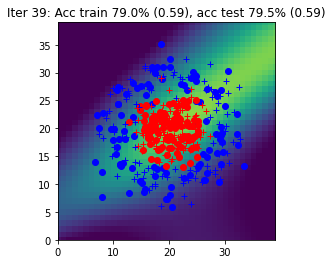

Iter 40: Acc train 78.5% (0.59), acc test 80.0% (0.59)


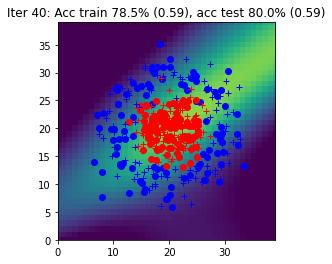

Iter 41: Acc train 78.5% (0.58), acc test 80.5% (0.58)


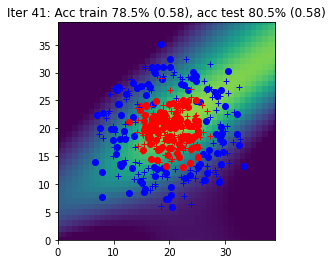

Iter 42: Acc train 78.5% (0.58), acc test 80.0% (0.58)


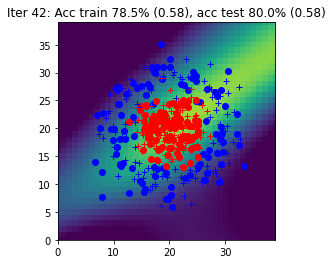

Iter 43: Acc train 78.0% (0.57), acc test 80.5% (0.57)


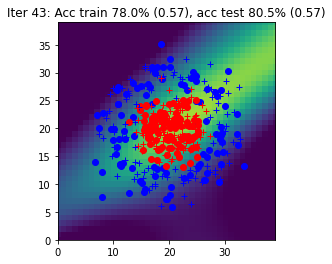

Iter 44: Acc train 78.0% (0.57), acc test 79.5% (0.57)


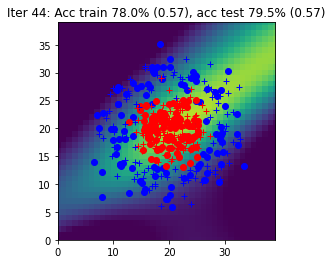

Iter 45: Acc train 78.5% (0.57), acc test 82.0% (0.57)


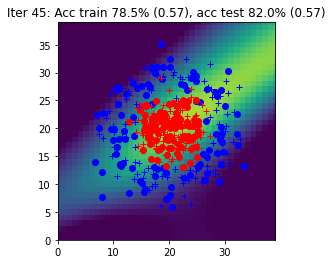

Iter 46: Acc train 80.0% (0.56), acc test 83.0% (0.56)


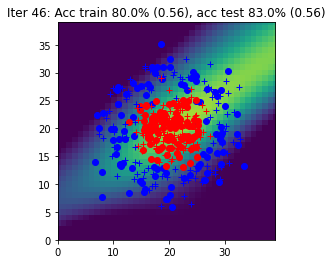

Iter 47: Acc train 80.0% (0.56), acc test 82.5% (0.56)


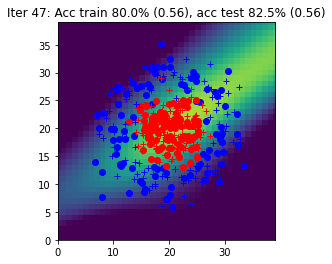

Iter 48: Acc train 78.5% (0.56), acc test 81.5% (0.56)


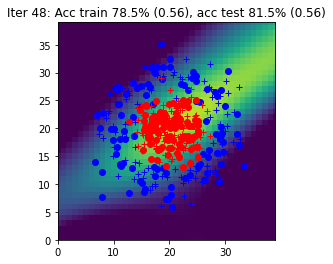

Iter 49: Acc train 79.0% (0.55), acc test 82.0% (0.55)


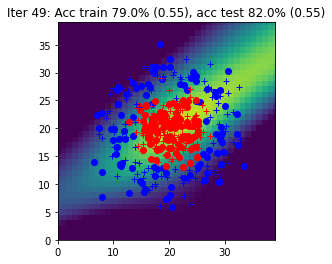

Iter 50: Acc train 80.0% (0.55), acc test 82.0% (0.55)


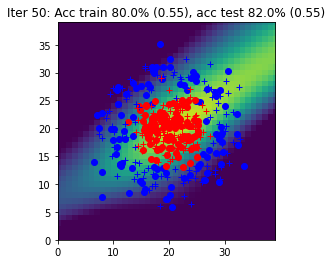

Iter 51: Acc train 78.0% (0.54), acc test 82.5% (0.54)


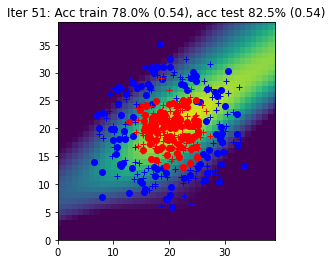

Iter 52: Acc train 79.0% (0.54), acc test 82.5% (0.54)


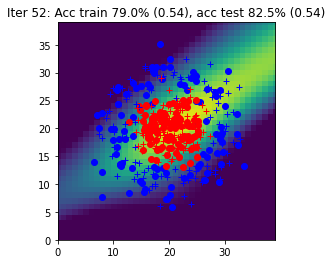

Iter 53: Acc train 80.0% (0.54), acc test 82.0% (0.54)


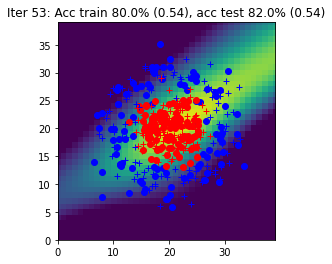

Iter 54: Acc train 79.0% (0.53), acc test 82.5% (0.53)


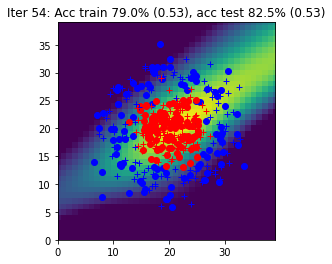

Iter 55: Acc train 78.5% (0.53), acc test 82.5% (0.53)


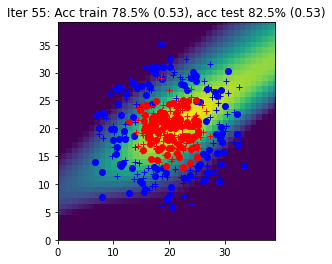

Iter 56: Acc train 78.5% (0.52), acc test 83.0% (0.53)


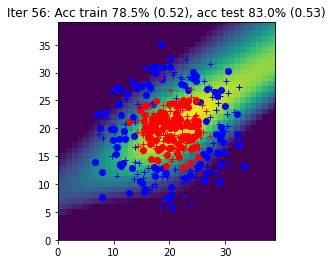

Iter 57: Acc train 78.5% (0.52), acc test 83.5% (0.52)


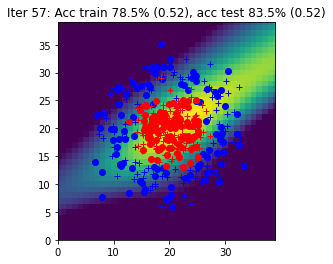

Iter 58: Acc train 80.0% (0.52), acc test 83.0% (0.52)


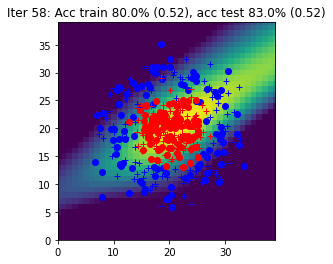

Iter 59: Acc train 81.0% (0.51), acc test 83.0% (0.51)


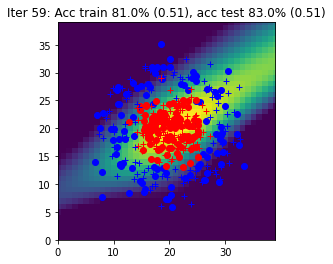

Iter 60: Acc train 81.0% (0.51), acc test 83.5% (0.51)


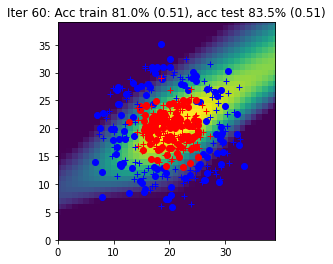

Iter 61: Acc train 81.5% (0.50), acc test 83.5% (0.51)


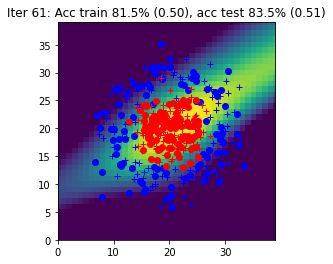

Iter 62: Acc train 81.5% (0.50), acc test 83.0% (0.50)


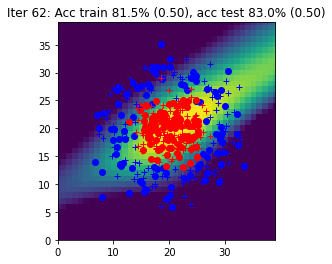

Iter 63: Acc train 80.5% (0.50), acc test 83.5% (0.50)


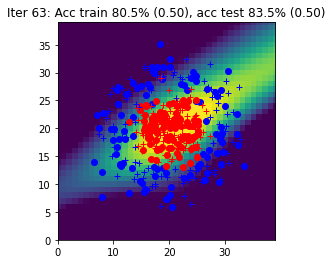

Iter 64: Acc train 80.5% (0.49), acc test 83.5% (0.49)


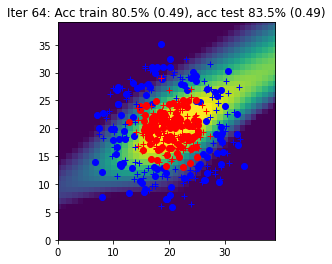

Iter 65: Acc train 82.0% (0.49), acc test 84.0% (0.49)


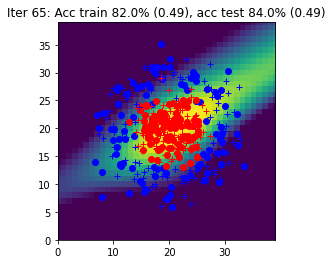

Iter 66: Acc train 83.0% (0.48), acc test 84.0% (0.49)


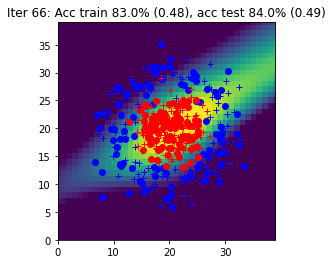

Iter 67: Acc train 81.0% (0.48), acc test 83.5% (0.48)


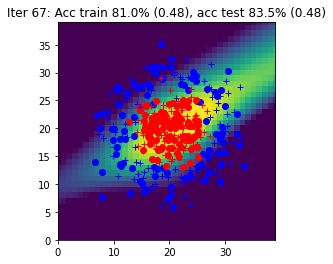

Iter 68: Acc train 81.5% (0.47), acc test 84.0% (0.48)


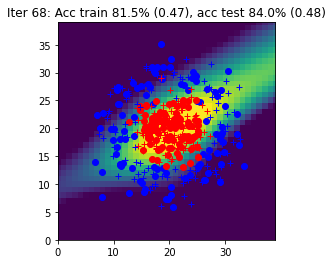

Iter 69: Acc train 81.5% (0.47), acc test 84.0% (0.47)


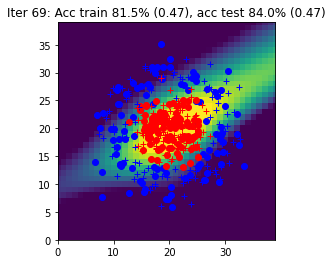

Iter 70: Acc train 82.5% (0.47), acc test 84.0% (0.47)


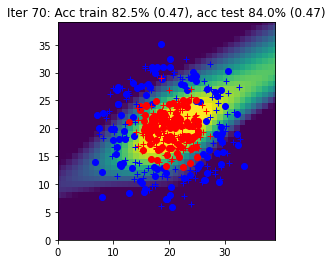

Iter 71: Acc train 83.5% (0.46), acc test 84.0% (0.46)


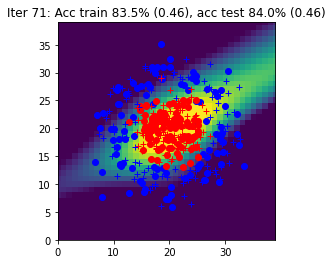

Iter 72: Acc train 83.0% (0.46), acc test 84.5% (0.46)


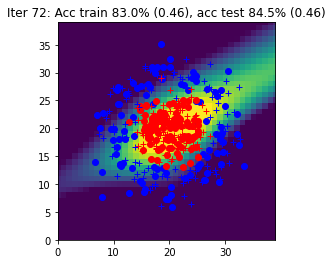

Iter 73: Acc train 84.5% (0.45), acc test 84.5% (0.46)


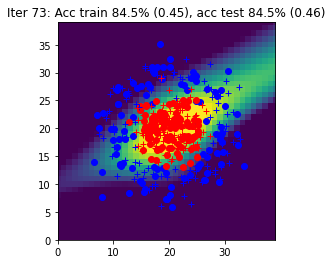

Iter 74: Acc train 84.0% (0.45), acc test 84.5% (0.45)


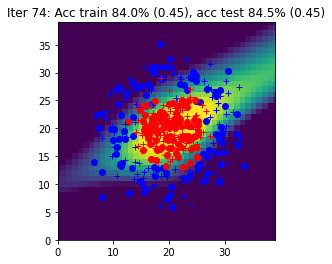

Iter 75: Acc train 84.5% (0.44), acc test 85.0% (0.45)


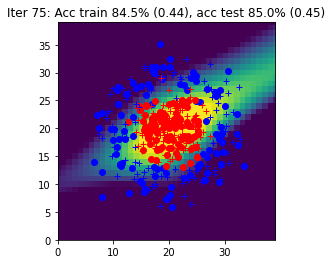

Iter 76: Acc train 85.0% (0.44), acc test 85.0% (0.44)


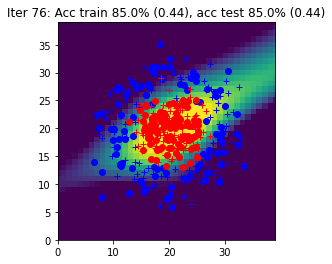

Iter 77: Acc train 85.0% (0.44), acc test 85.0% (0.44)


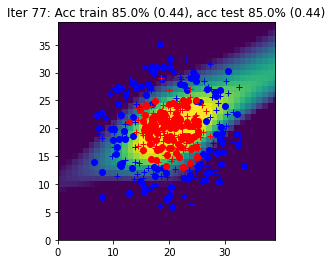

Iter 78: Acc train 85.5% (0.43), acc test 85.5% (0.43)


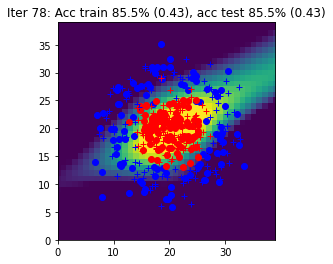

Iter 79: Acc train 85.0% (0.43), acc test 85.5% (0.43)


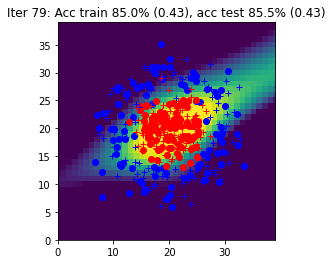

Iter 80: Acc train 85.5% (0.42), acc test 85.5% (0.43)


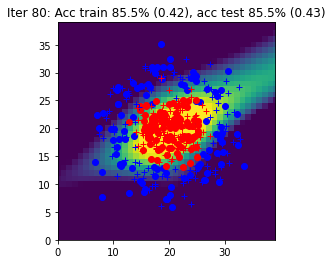

Iter 81: Acc train 87.0% (0.42), acc test 86.0% (0.42)


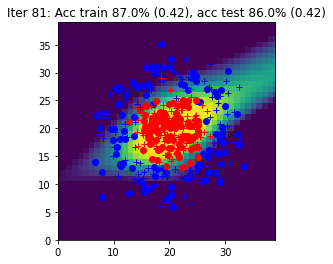

Iter 82: Acc train 87.0% (0.41), acc test 86.0% (0.42)


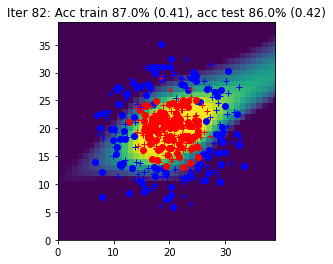

Iter 83: Acc train 87.5% (0.41), acc test 86.5% (0.41)


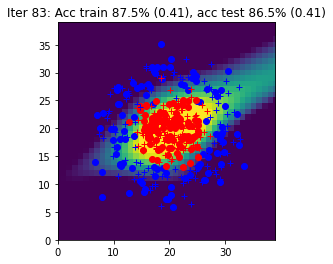

Iter 84: Acc train 89.0% (0.40), acc test 86.5% (0.41)


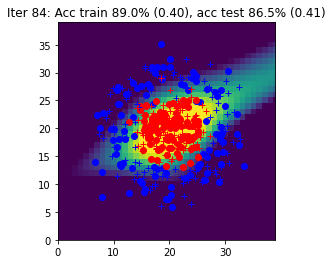

Iter 85: Acc train 89.0% (0.40), acc test 87.0% (0.40)


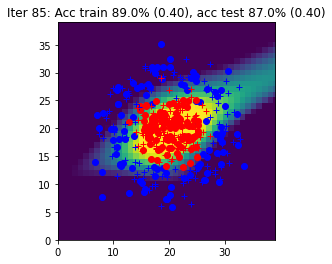

Iter 86: Acc train 88.5% (0.39), acc test 87.0% (0.40)


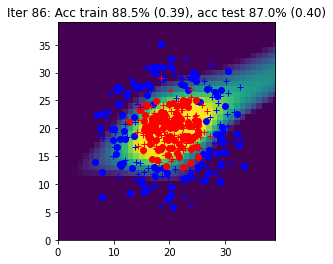

Iter 87: Acc train 88.5% (0.39), acc test 87.5% (0.39)


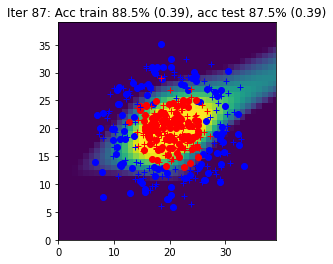

Iter 88: Acc train 90.5% (0.39), acc test 87.0% (0.39)


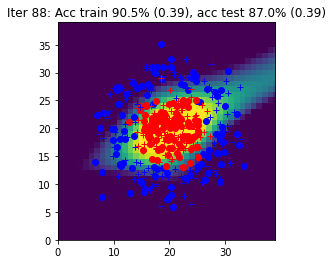

Iter 89: Acc train 90.5% (0.38), acc test 88.5% (0.39)


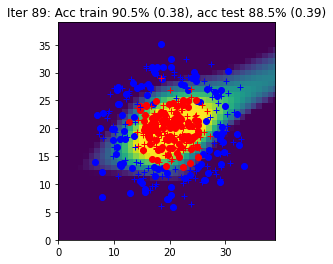

Iter 90: Acc train 90.5% (0.38), acc test 88.5% (0.38)


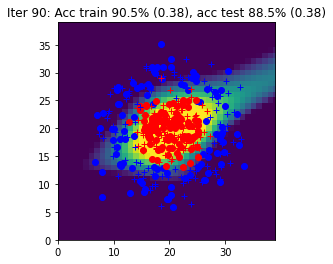

Iter 91: Acc train 91.0% (0.37), acc test 89.0% (0.38)


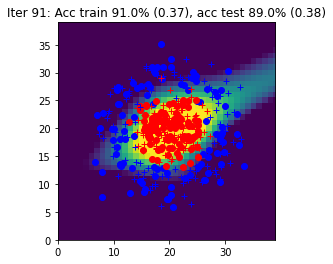

Iter 92: Acc train 91.5% (0.37), acc test 89.0% (0.37)


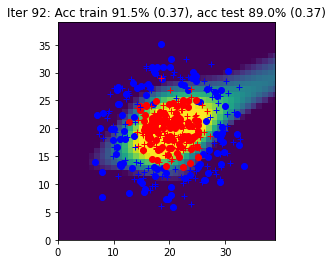

Iter 93: Acc train 92.0% (0.36), acc test 89.0% (0.37)


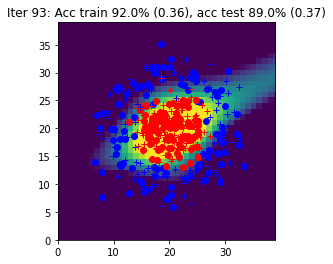

Iter 94: Acc train 92.0% (0.36), acc test 91.0% (0.36)


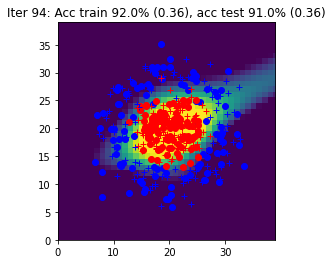

Iter 95: Acc train 92.5% (0.36), acc test 91.5% (0.36)


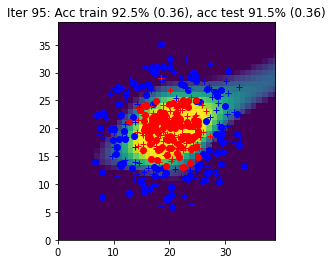

Iter 96: Acc train 91.5% (0.35), acc test 93.0% (0.36)


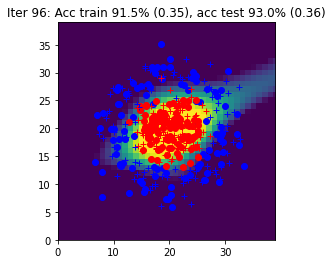

Iter 97: Acc train 92.0% (0.35), acc test 93.0% (0.35)


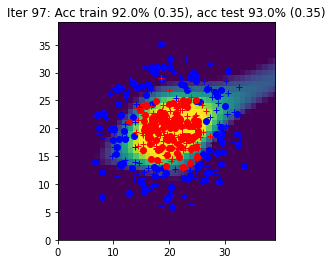

Iter 98: Acc train 93.0% (0.34), acc test 92.5% (0.35)


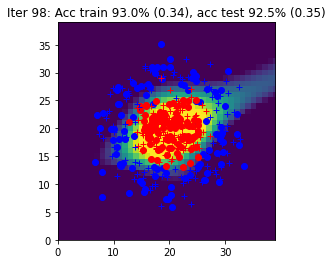

Iter 99: Acc train 93.5% (0.34), acc test 93.0% (0.34)


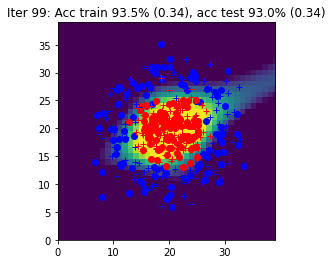

Iter 100: Acc train 93.5% (0.34), acc test 93.5% (0.34)


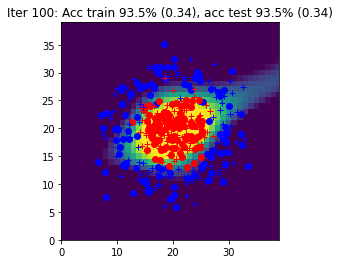

Iter 101: Acc train 93.5% (0.33), acc test 94.0% (0.34)


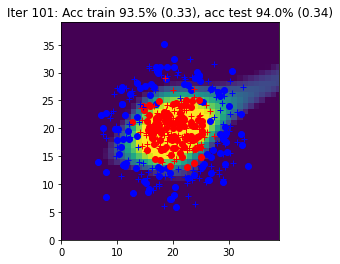

Iter 102: Acc train 93.5% (0.33), acc test 94.0% (0.33)


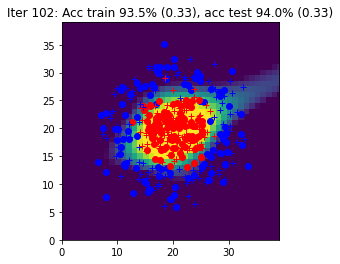

Iter 103: Acc train 94.0% (0.32), acc test 94.0% (0.33)


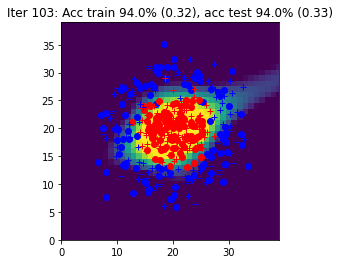

Iter 104: Acc train 94.0% (0.32), acc test 94.0% (0.33)


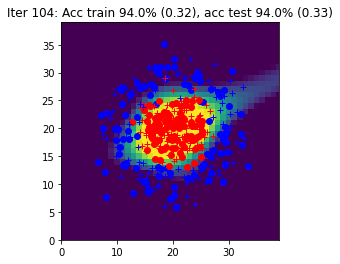

Iter 105: Acc train 94.0% (0.32), acc test 94.0% (0.32)


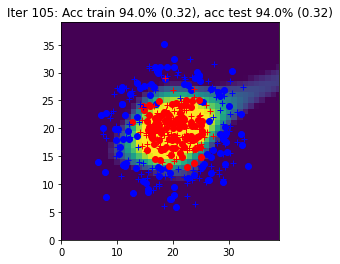

Iter 106: Acc train 94.0% (0.31), acc test 94.0% (0.32)


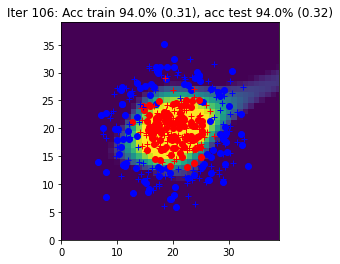

Iter 107: Acc train 94.5% (0.31), acc test 94.5% (0.32)


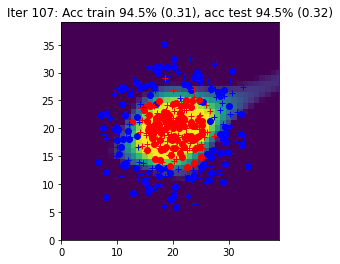

Iter 108: Acc train 94.5% (0.31), acc test 94.5% (0.31)


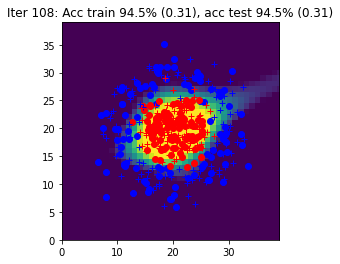

Iter 109: Acc train 94.5% (0.30), acc test 94.5% (0.31)


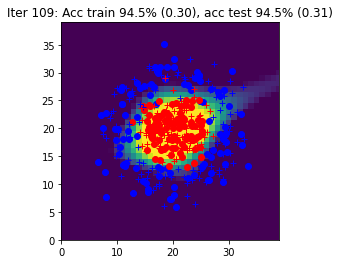

Iter 110: Acc train 94.5% (0.30), acc test 94.5% (0.31)


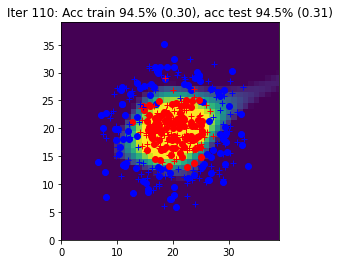

Iter 111: Acc train 94.5% (0.30), acc test 94.5% (0.30)


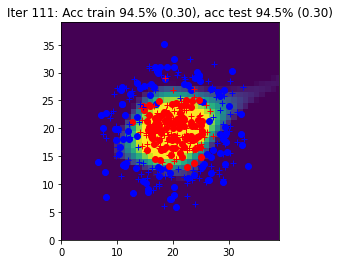

Iter 112: Acc train 94.5% (0.29), acc test 94.5% (0.30)


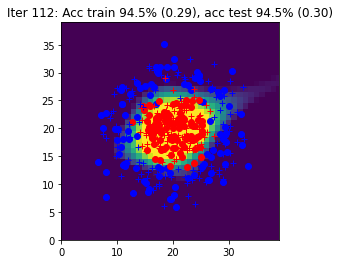

Iter 113: Acc train 94.5% (0.29), acc test 94.5% (0.30)


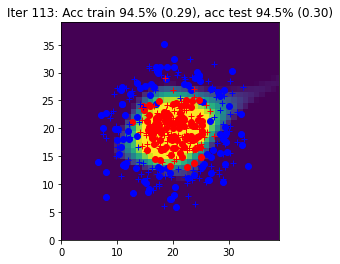

Iter 114: Acc train 94.5% (0.29), acc test 94.5% (0.29)


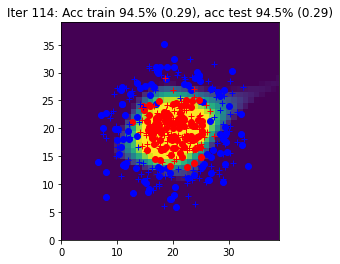

Iter 115: Acc train 94.5% (0.28), acc test 94.5% (0.29)


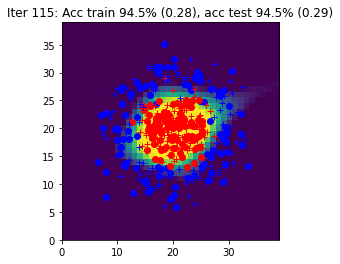

Iter 116: Acc train 94.5% (0.28), acc test 94.5% (0.29)


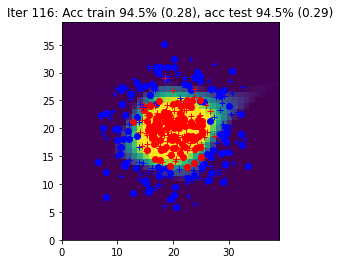

Iter 117: Acc train 94.5% (0.28), acc test 95.0% (0.29)


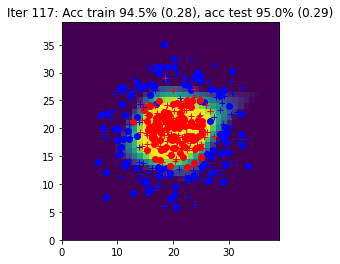

Iter 118: Acc train 94.5% (0.28), acc test 95.0% (0.28)


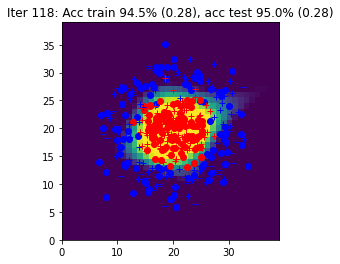

Iter 119: Acc train 94.5% (0.27), acc test 95.0% (0.28)


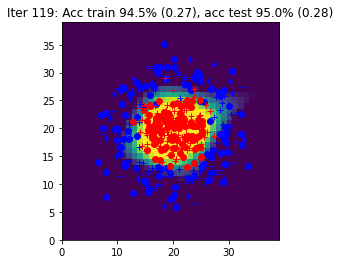

Iter 120: Acc train 94.5% (0.27), acc test 95.0% (0.28)


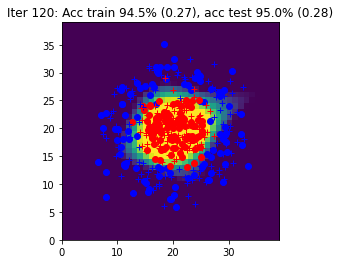

Iter 121: Acc train 94.5% (0.27), acc test 95.0% (0.28)


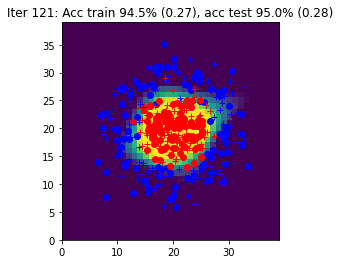

Iter 122: Acc train 94.0% (0.27), acc test 95.0% (0.27)


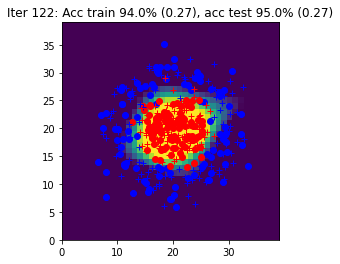

Iter 123: Acc train 94.5% (0.26), acc test 95.0% (0.27)


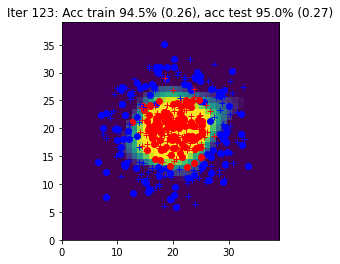

Iter 124: Acc train 94.5% (0.26), acc test 95.0% (0.27)


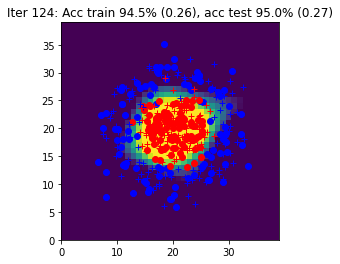

Iter 125: Acc train 94.5% (0.26), acc test 95.0% (0.27)


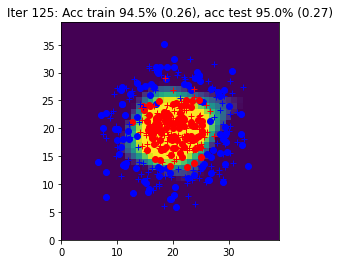

Iter 126: Acc train 94.0% (0.26), acc test 95.0% (0.26)


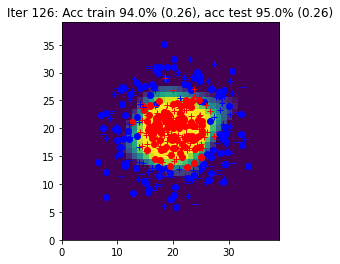

Iter 127: Acc train 94.0% (0.25), acc test 95.0% (0.26)


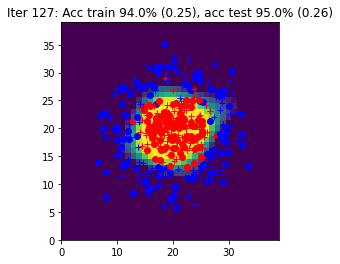

Iter 128: Acc train 94.0% (0.25), acc test 95.0% (0.26)


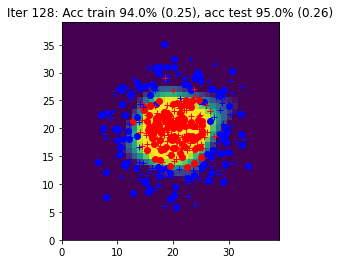

Iter 129: Acc train 94.0% (0.25), acc test 94.5% (0.26)


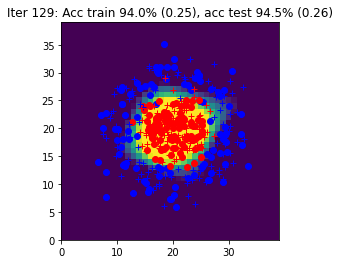

Iter 130: Acc train 94.0% (0.25), acc test 94.5% (0.26)


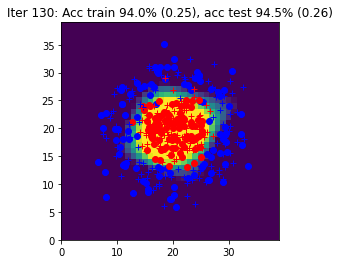

Iter 131: Acc train 95.0% (0.24), acc test 95.0% (0.25)


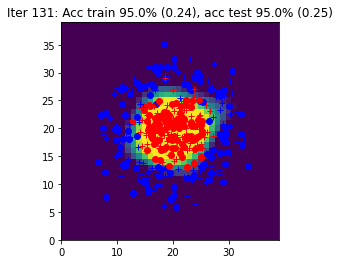

Iter 132: Acc train 95.0% (0.24), acc test 95.0% (0.25)


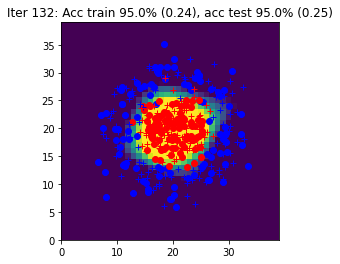

Iter 133: Acc train 95.0% (0.24), acc test 95.0% (0.25)


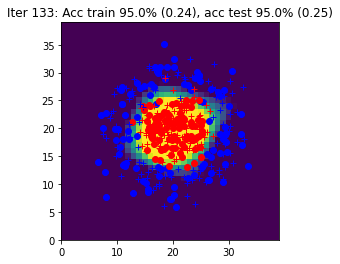

Iter 134: Acc train 95.0% (0.24), acc test 94.5% (0.25)


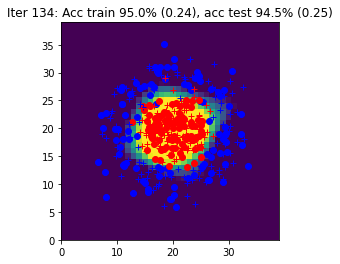

Iter 135: Acc train 95.0% (0.24), acc test 95.0% (0.25)


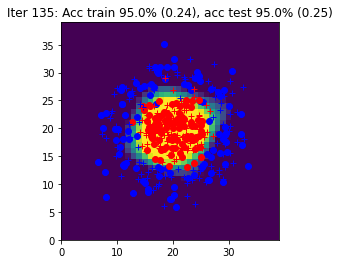

Iter 136: Acc train 95.0% (0.24), acc test 94.5% (0.25)


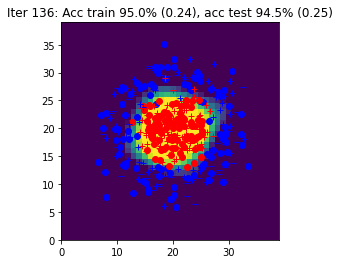

Iter 137: Acc train 95.0% (0.23), acc test 94.5% (0.24)


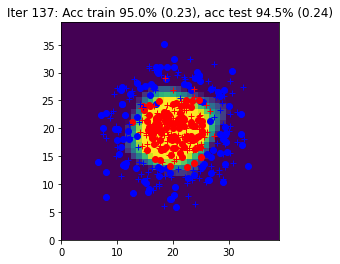

Iter 138: Acc train 95.0% (0.23), acc test 94.5% (0.24)


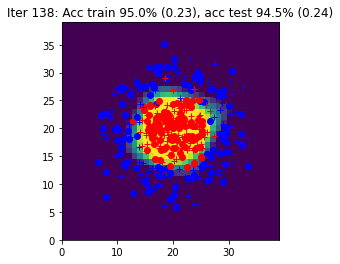

Iter 139: Acc train 95.0% (0.23), acc test 94.5% (0.24)


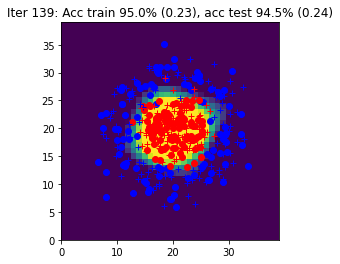

Iter 140: Acc train 95.0% (0.23), acc test 94.5% (0.24)


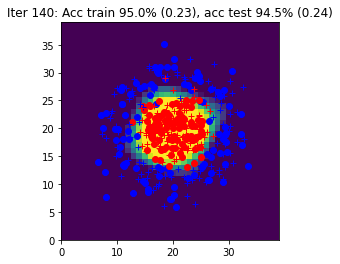

Iter 141: Acc train 95.0% (0.23), acc test 94.5% (0.24)


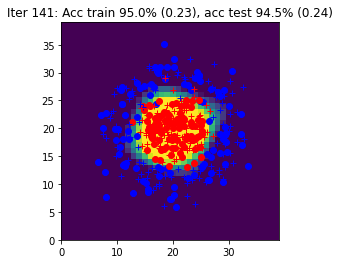

Iter 142: Acc train 95.0% (0.23), acc test 94.0% (0.24)


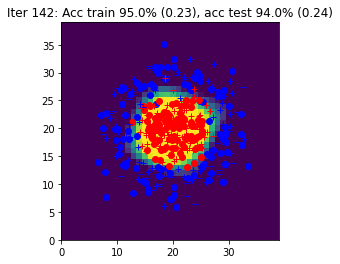

Iter 143: Acc train 95.0% (0.22), acc test 94.0% (0.23)


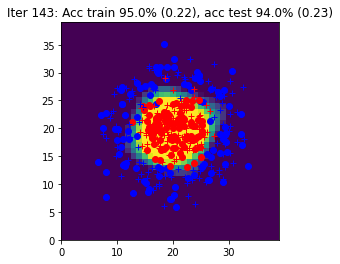

Iter 144: Acc train 95.0% (0.22), acc test 94.5% (0.23)


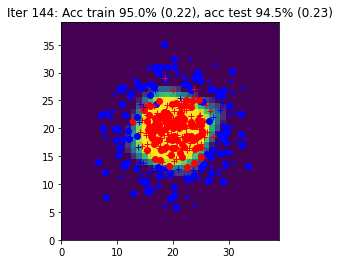

Iter 145: Acc train 95.0% (0.22), acc test 94.5% (0.23)


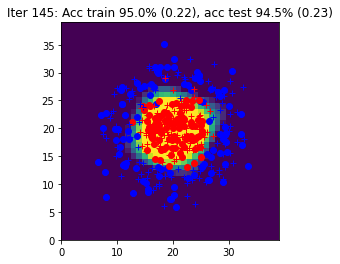

Iter 146: Acc train 95.0% (0.22), acc test 94.5% (0.23)


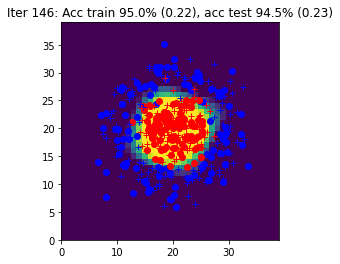

Iter 147: Acc train 95.0% (0.22), acc test 94.5% (0.23)


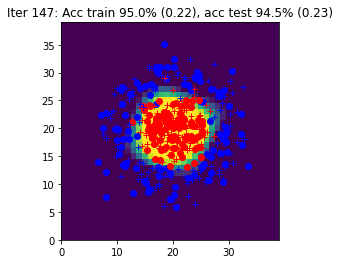

Iter 148: Acc train 95.0% (0.22), acc test 94.5% (0.23)


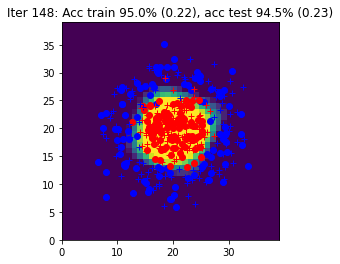

Iter 149: Acc train 95.0% (0.22), acc test 94.5% (0.23)


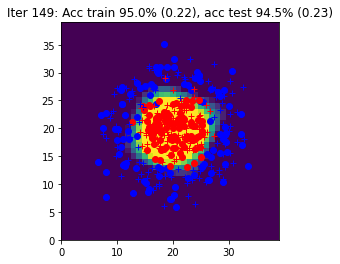

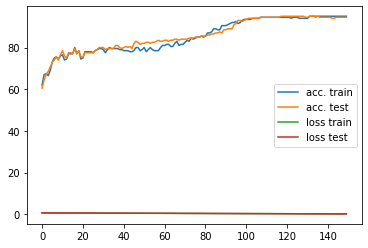

In [133]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]
  
        Yhat = model(X)
        L, _ = loss_accuracy(loss, Yhat, Y)

        optim.zero_grad()
        L.backward()
        optim.step()



    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)  

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title) 
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 5 : MNIST

Reprendre le code d'entraînement précédent en l'appliquant au dataset MNIST.

In [ ]:
# init
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.001


model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(100):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]
  
        Yhat = model(X)
        L, _ = loss_accuracy(loss, Yhat, Y)

        optim.zero_grad()
        L.backward()
        optim.step()




    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    #Ygrid = model(data.Xgrid)  

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title) 
    #data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.legend()
plt.show()
fig2 = plt.figure()
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

Iter 0: Acc train 82.4% (0.87), acc test 83.2% (0.86)
Iter 1: Acc train 86.6% (0.62), acc test 87.2% (0.60)
Iter 2: Acc train 88.8% (0.50), acc test 89.2% (0.49)
Iter 3: Acc train 89.7% (0.44), acc test 90.1% (0.43)
Iter 4: Acc train 90.3% (0.40), acc test 90.8% (0.39)
Iter 5: Acc train 90.9% (0.37), acc test 91.3% (0.36)
Iter 6: Acc train 91.4% (0.34), acc test 91.6% (0.34)
Iter 7: Acc train 91.6% (0.33), acc test 91.6% (0.32)
Iter 8: Acc train 92.0% (0.31), acc test 92.0% (0.31)
Iter 9: Acc train 92.3% (0.30), acc test 92.2% (0.30)
Iter 10: Acc train 92.5% (0.29), acc test 92.2% (0.29)
Iter 11: Acc train 92.7% (0.28), acc test 92.4% (0.29)
Iter 12: Acc train 93.0% (0.27), acc test 92.5% (0.28)
Iter 13: Acc train 93.3% (0.26), acc test 92.8% (0.27)
Iter 14: Acc train 93.3% (0.25), acc test 92.9% (0.26)
Iter 15: Acc train 93.5% (0.25), acc test 93.1% (0.26)
Iter 16: Acc train 93.7% (0.24), acc test 93.0% (0.26)
Iter 17: Acc train 93.8% (0.23), acc test 93.4% (0.25)
Iter 18: Acc train 9

# Partie 6: Bonus: SVM


Entrainez un modèle SVM sur le jeu de data Circles.
Le code à remplir est indiqué par des commentaires.


Idées : 
- Essayer d'abord un SVM linéaire (sklearn.svm.LinearSVC dans scikit-learn). Est-ce que cela fonctionne bien ? Pourquoi
- Essayer d'autres kernels (possible avec sklearn.svm.SVC).
Lequel fonctionne le mieux ? Pourquoi ?
- Est-ce que le paramètre C de régularisation à un impact ? Pourquoi ?

In [64]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

In [116]:
import sklearn.svm

### Entrainer le SVM #######
## Voir https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## et https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

svm = sklearn.svm.SVC(kernel='rbf', C=.5).fit(Xtrain, Ytrain)

###########################

Accuracy : 95.50


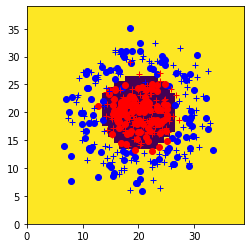

In [117]:
## Affichage des résultats

Ytest_pred = svm.predict(Xtest), 
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}")
Ygrid_pred = svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)